# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [30]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [31]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [32]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [33]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [34]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [35]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [36]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [37]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1) ** 2)
    #### END CODE HERE ####
    return penalty

In [38]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [39]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = - torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [40]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [41]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda*gp
    #### END CODE HERE ####
    return crit_loss

In [42]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.08995681655127555, critic loss: 1.8877962865382438


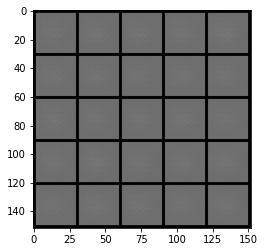

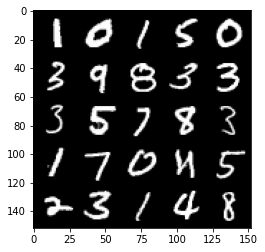

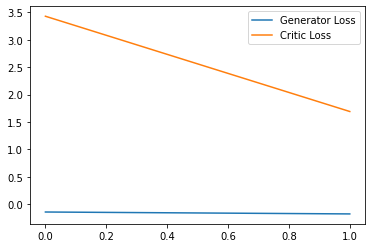

Step 100: Generator loss: 0.8555677131563425, critic loss: -1.8242382611930368


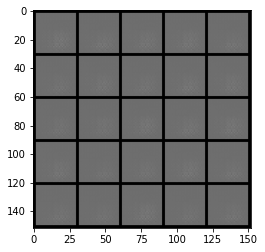

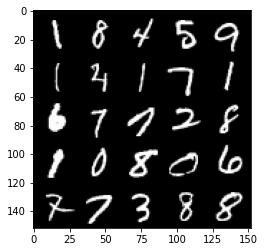

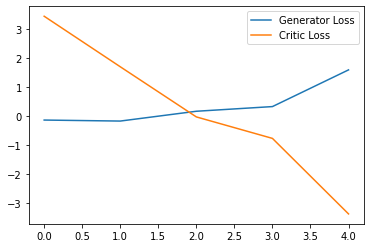

Step 150: Generator loss: 1.9903255796432495, critic loss: -10.99673300743103


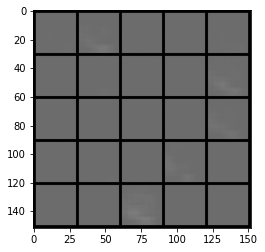

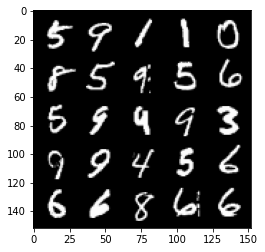

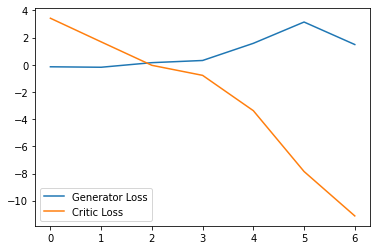

Step 200: Generator loss: 0.27412069991230964, critic loss: -30.801570335388192


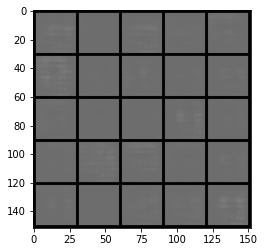

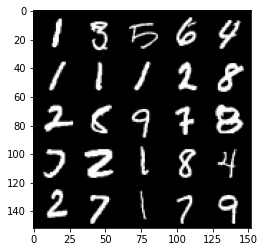

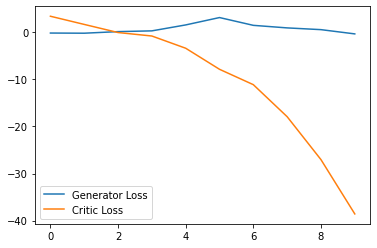

Step 250: Generator loss: 0.5877109380066394, critic loss: -62.492118621826165


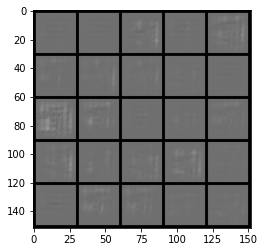

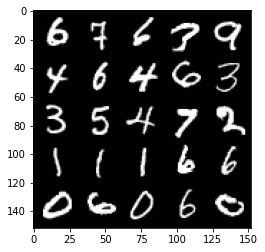

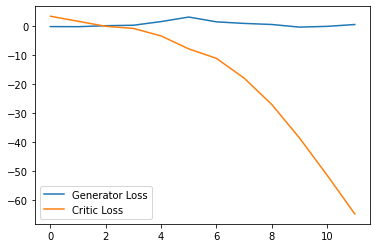

Step 300: Generator loss: 3.575558638572693, critic loss: -105.01886441040043


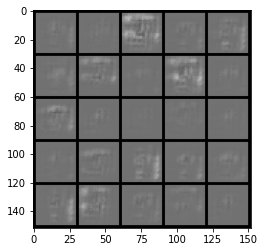

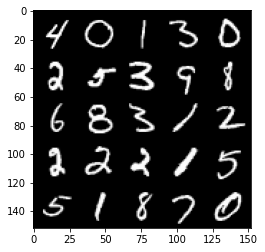

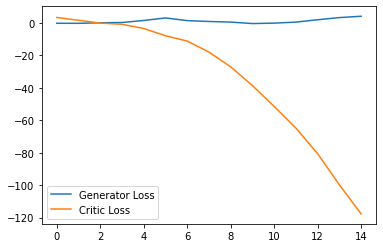

Step 350: Generator loss: 6.633632211685181, critic loss: -157.42012890625


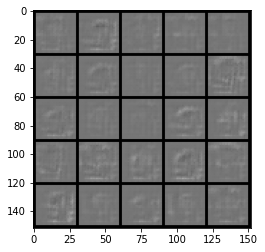

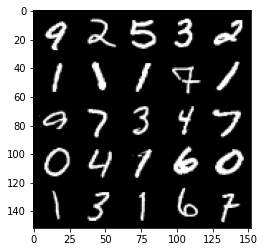

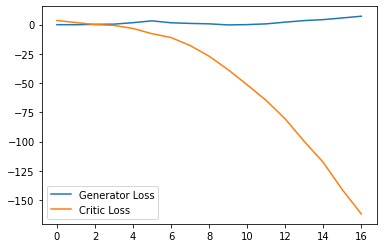

Step 400: Generator loss: 7.334422619342804, critic loss: -202.92754312133786


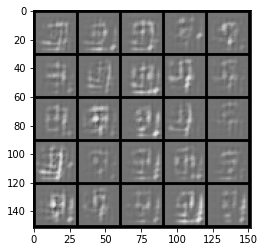

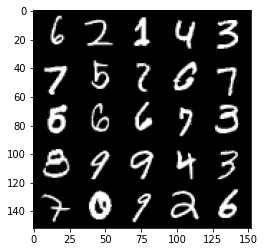

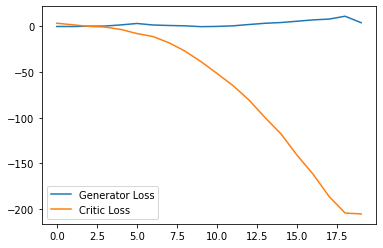

Step 450: Generator loss: -2.7833639550209046, critic loss: -188.89137942504883


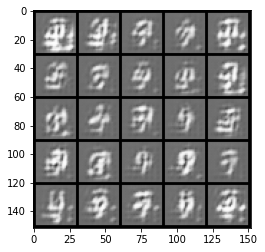

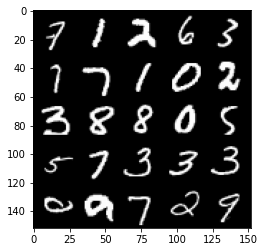

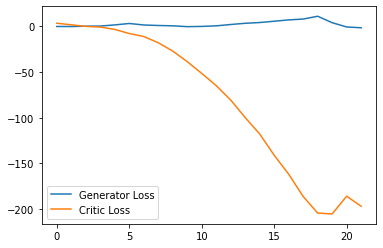

Step 500: Generator loss: 21.10894935846329, critic loss: -259.67287191772454


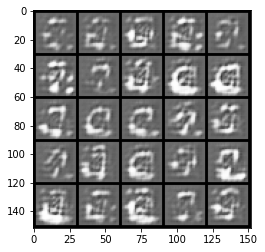

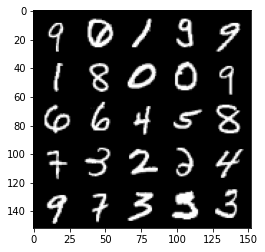

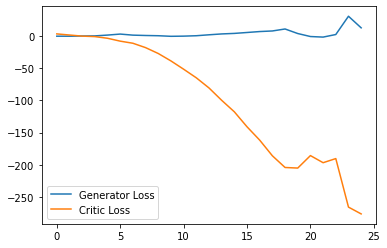

Step 550: Generator loss: 14.428356903791428, critic loss: -309.7493692016601


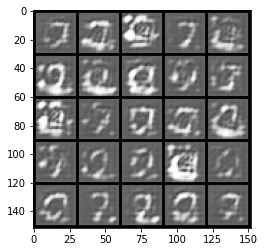

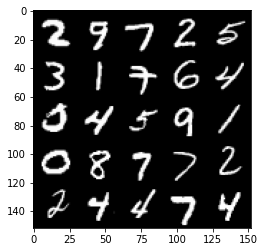

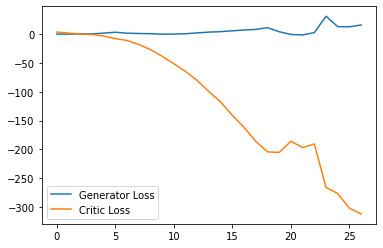

Step 600: Generator loss: -22.847874333262443, critic loss: -262.4731497802734


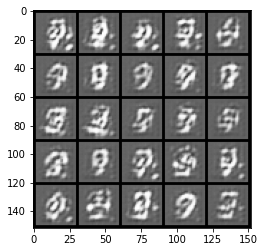

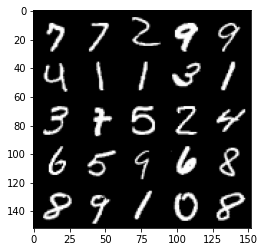

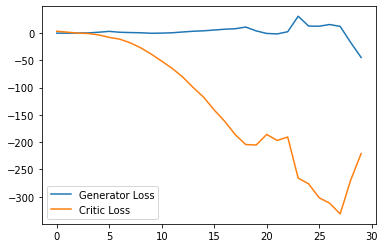

Step 650: Generator loss: 10.918759897649288, critic loss: -297.84296478271483


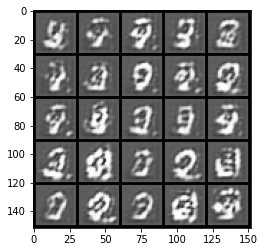

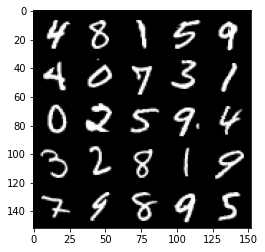

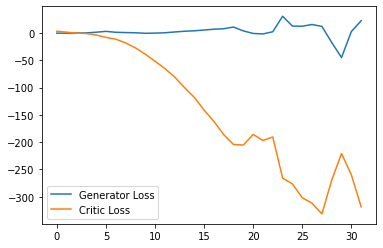

Step 700: Generator loss: -29.297711577415466, critic loss: -232.73969692993163


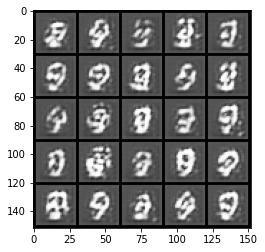

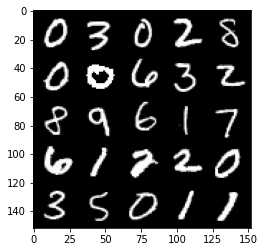

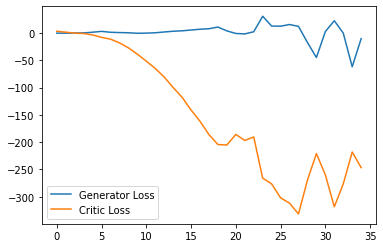

Step 750: Generator loss: 2.001835925579071, critic loss: -207.9540386199951


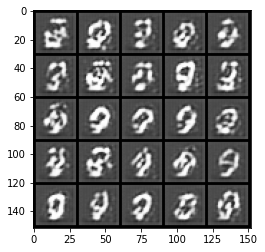

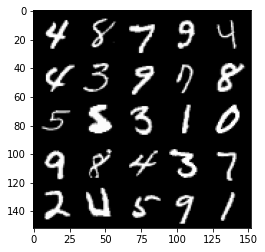

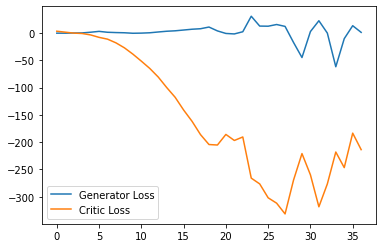

Step 800: Generator loss: -22.517357099056245, critic loss: -167.98156427001956


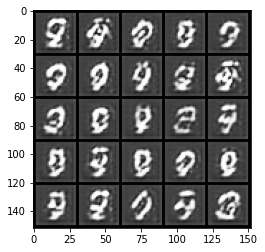

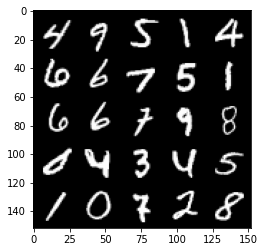

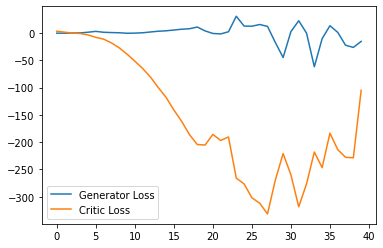

Step 850: Generator loss: -21.350479288101198, critic loss: -162.67776123046878


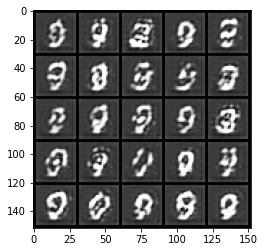

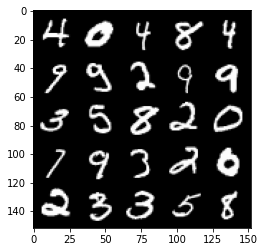

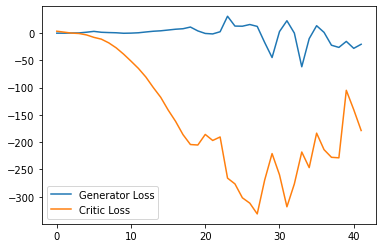

Step 900: Generator loss: -29.267041313648225, critic loss: -141.1583701171875


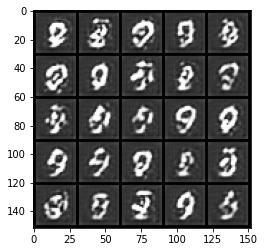

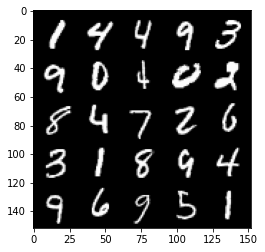

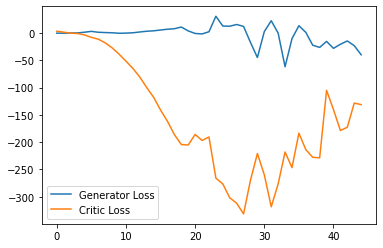

Step 950: Generator loss: -40.331337435245516, critic loss: -119.37048374938968


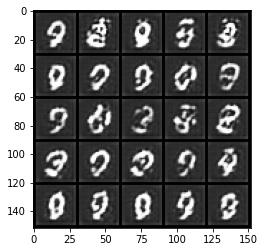

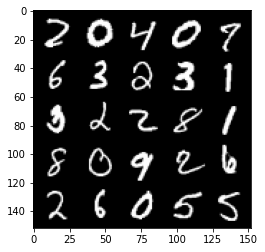

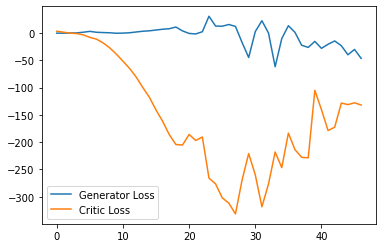

Step 1000: Generator loss: -26.712034162282944, critic loss: -14.725077011108388


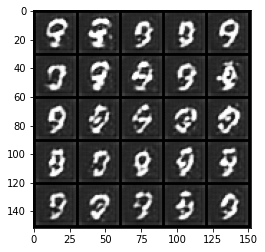

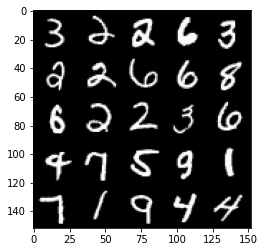

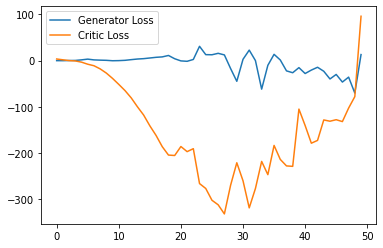

Step 1050: Generator loss: 10.250048847198487, critic loss: 26.436892787933342


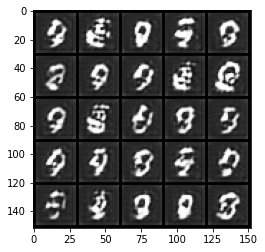

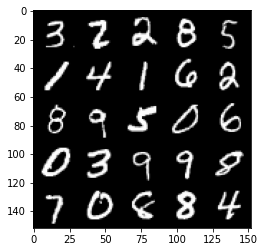

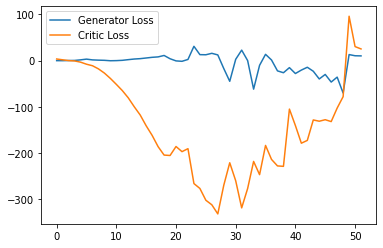

Step 1100: Generator loss: 11.276153316497803, critic loss: 11.707566850662234


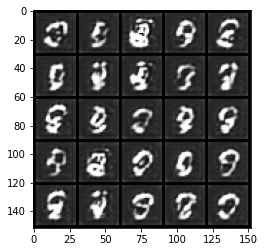

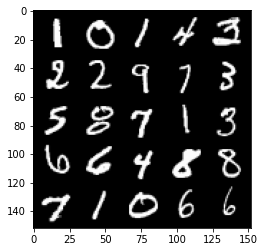

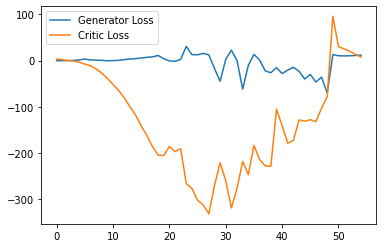

Step 1150: Generator loss: 12.015540294647217, critic loss: 2.8671719646453875


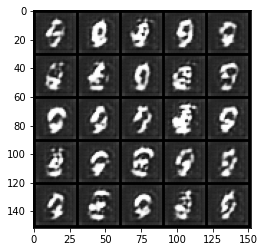

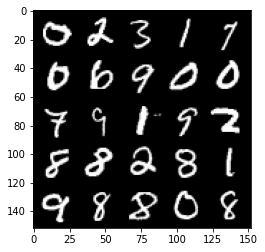

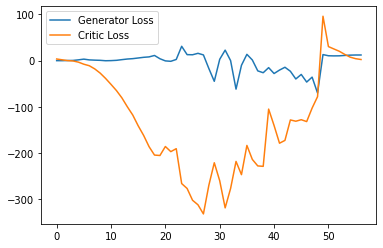

Step 1200: Generator loss: 9.52007649421692, critic loss: 4.007658630371093


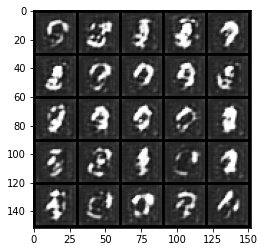

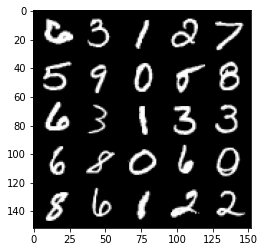

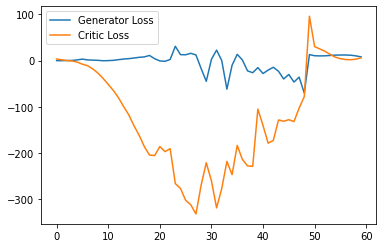

Step 1250: Generator loss: 5.641485714912415, critic loss: 15.976260208129883


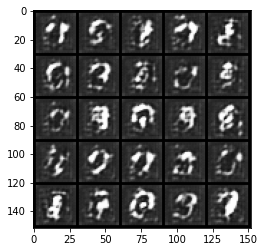

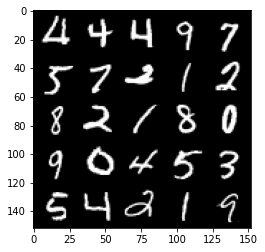

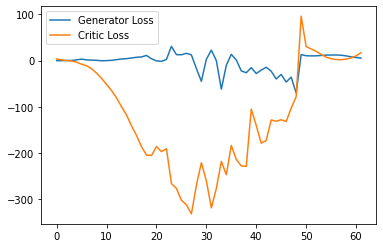

Step 1300: Generator loss: 2.4701664304733275, critic loss: 29.488885986328118


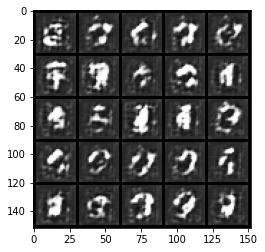

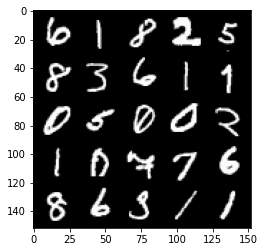

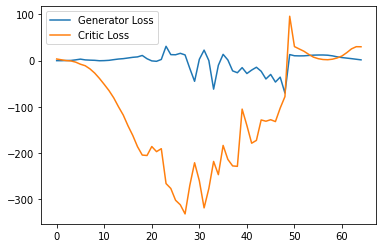

Step 1350: Generator loss: -0.48026048332452775, critic loss: 25.706134960174555


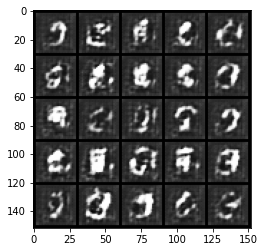

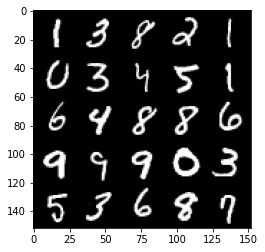

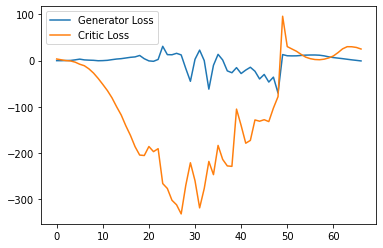

Step 1400: Generator loss: -3.039103875160217, critic loss: 17.742764110565187


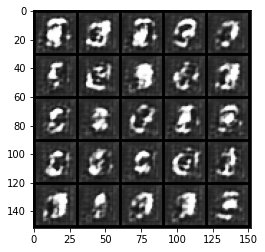

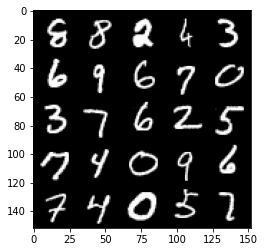

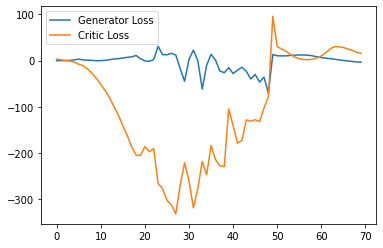

Step 1450: Generator loss: -3.699589285850525, critic loss: 12.244403678894049


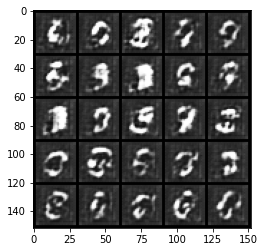

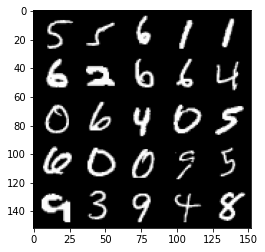

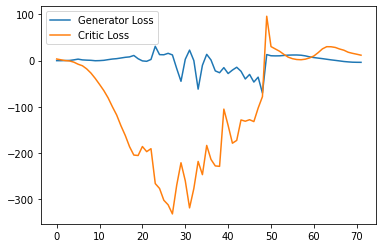

Step 1500: Generator loss: -3.880390553474426, critic loss: 8.811413969993593


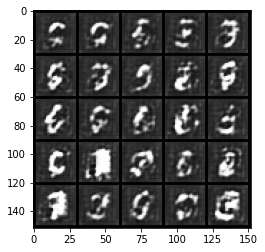

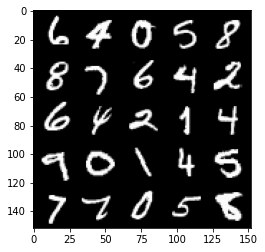

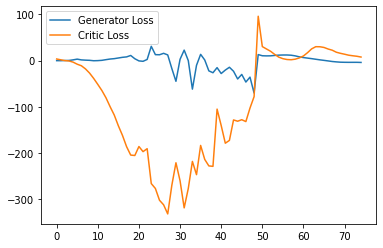

Step 1550: Generator loss: -4.269281067848206, critic loss: 5.999699402809143


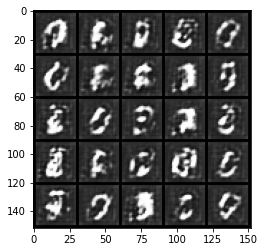

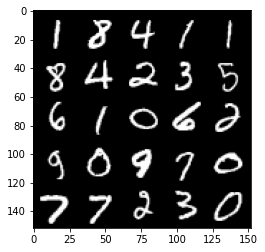

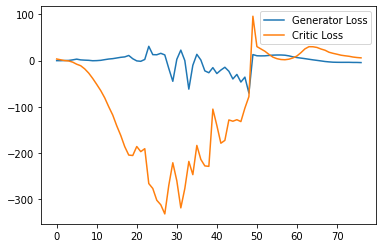

Step 1600: Generator loss: -6.4397925186157225, critic loss: 4.255015547752381


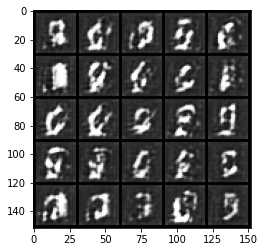

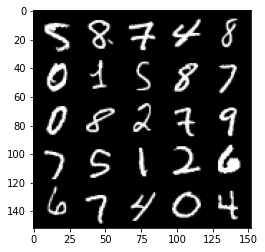

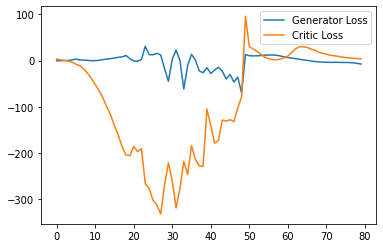

Step 1650: Generator loss: -9.921854286193847, critic loss: 3.4929439878463753


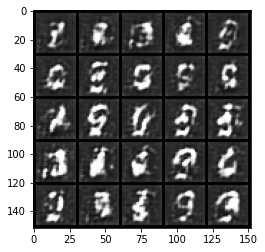

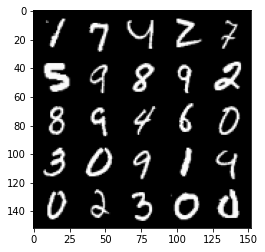

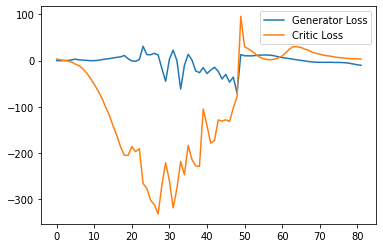

Step 1700: Generator loss: -12.610040702819823, critic loss: 2.1838477306365967


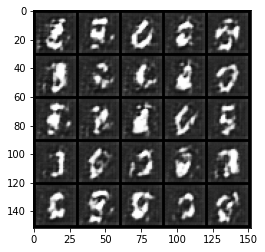

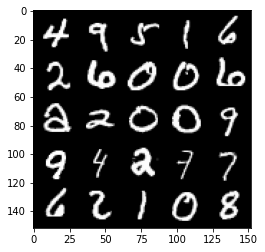

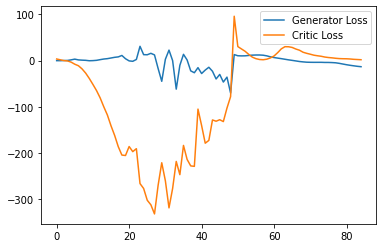

Step 1750: Generator loss: -15.115571231842042, critic loss: 1.2021674623489378


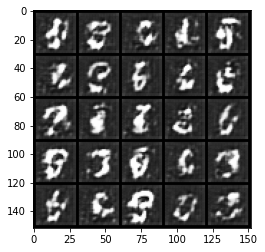

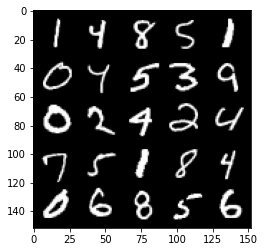

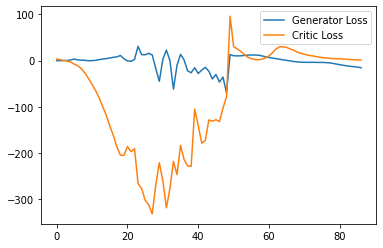

Step 1800: Generator loss: -17.52951549530029, critic loss: 0.4484563441276548


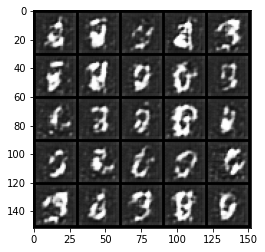

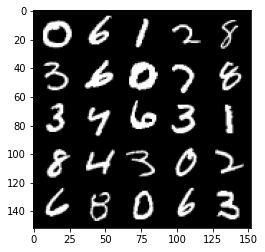

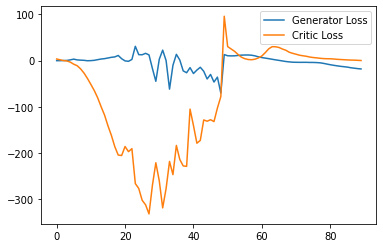

Step 1850: Generator loss: -19.55550884246826, critic loss: -0.8504757671356201


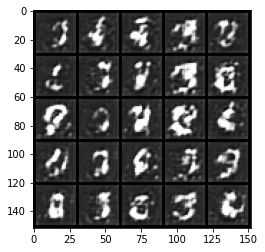

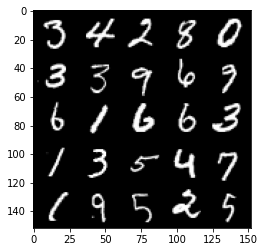

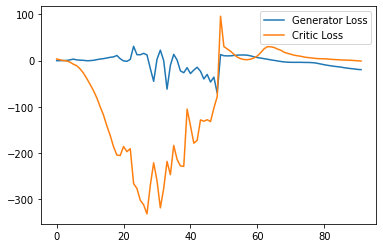

Step 1900: Generator loss: -21.04029266357422, critic loss: -2.362484704971313


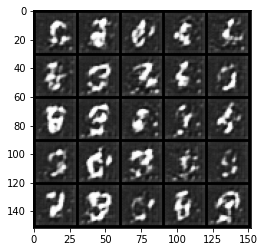

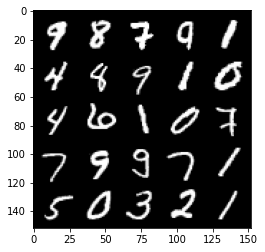

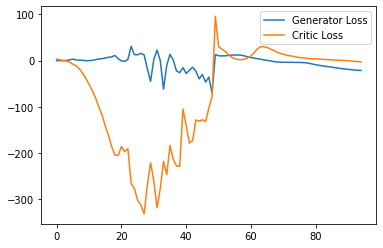

Step 1950: Generator loss: -21.67181007385254, critic loss: -4.072183930397035


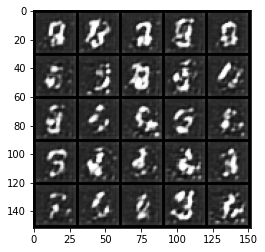

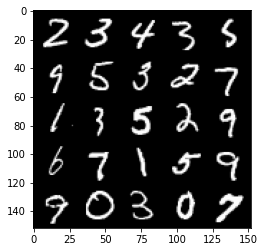

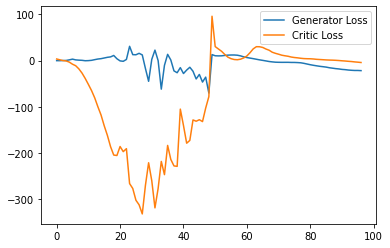

Step 2000: Generator loss: -21.86225887298584, critic loss: -6.6440381193161


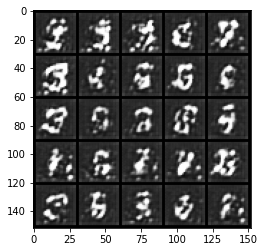

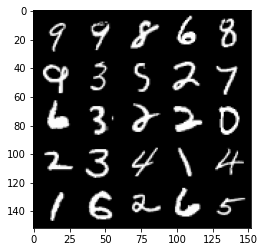

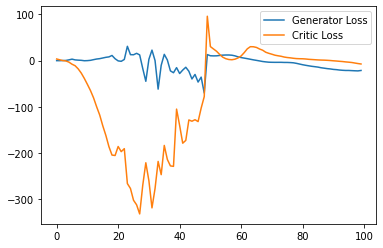

Step 2050: Generator loss: -20.592343406677244, critic loss: -8.897847702026366


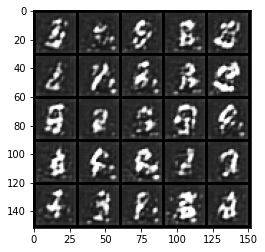

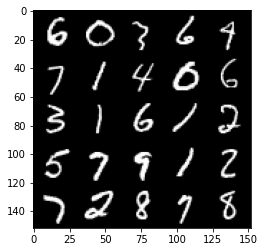

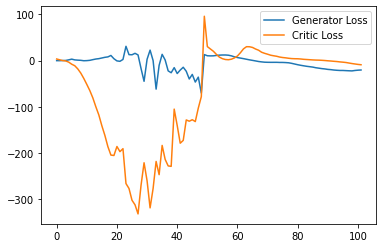

Step 2100: Generator loss: -19.56552225112915, critic loss: -11.200743932723995


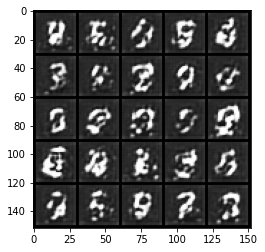

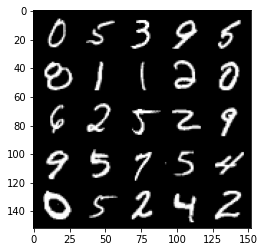

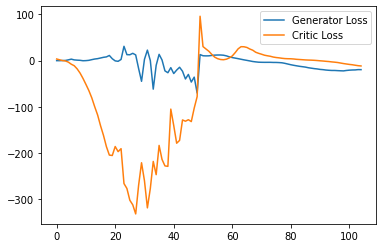

Step 2150: Generator loss: -17.876494102478027, critic loss: -12.91566081428528


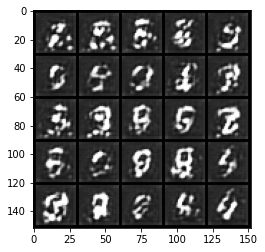

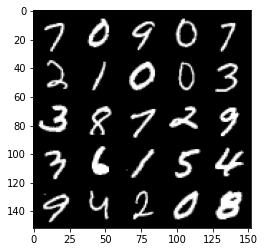

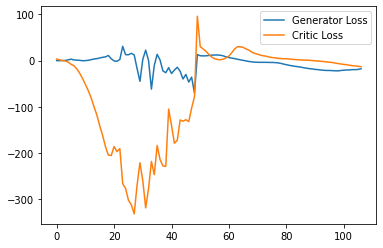

Step 2200: Generator loss: -16.164539642333985, critic loss: -15.4980449848175


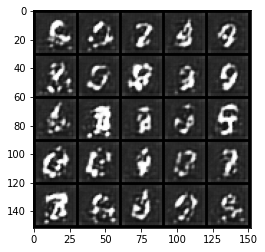

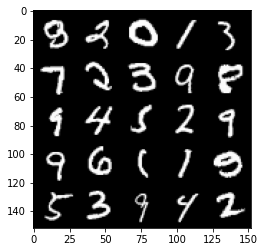

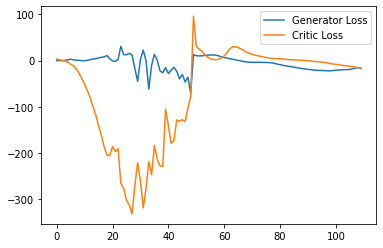

Step 2250: Generator loss: -14.76330415725708, critic loss: -16.287424760818485


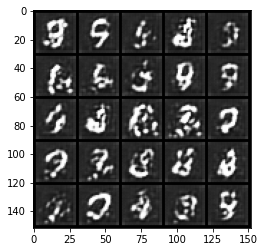

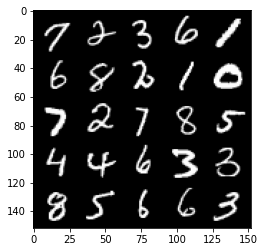

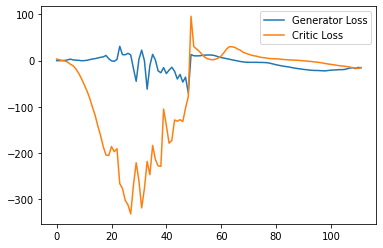

Step 2300: Generator loss: -11.854431648254394, critic loss: -16.064513176918027


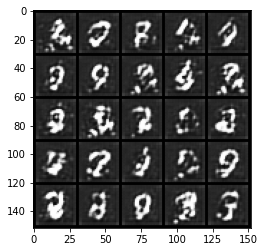

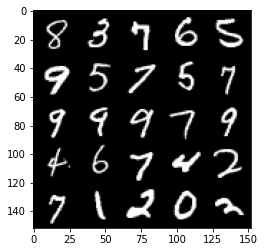

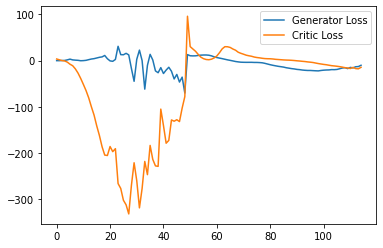

Step 2350: Generator loss: -10.24276531934738, critic loss: -16.70795238494873


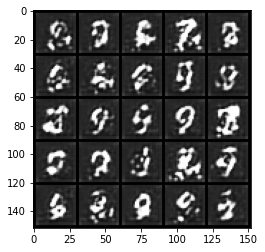

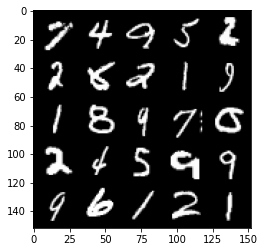

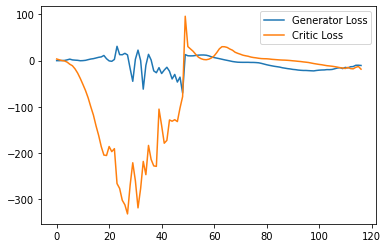

Step 2400: Generator loss: -7.24601149559021, critic loss: -19.67319641113281


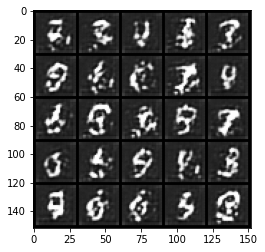

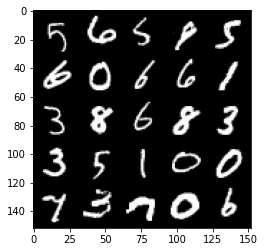

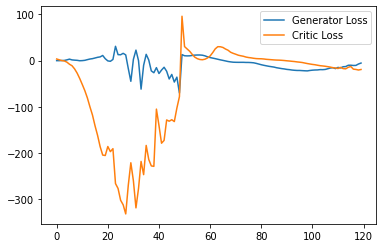

Step 2450: Generator loss: -5.271239956617356, critic loss: -18.334466804504395


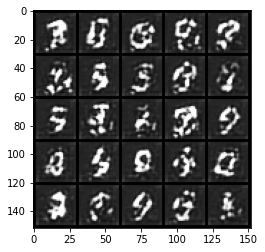

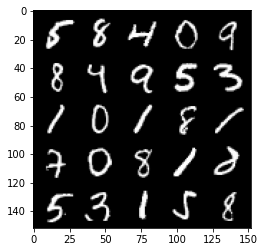

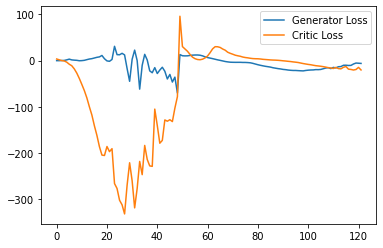

Step 2500: Generator loss: -1.2209887782111764, critic loss: -6.142142303943633


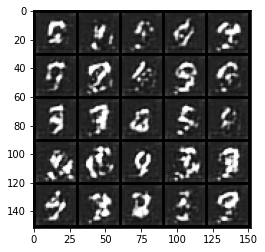

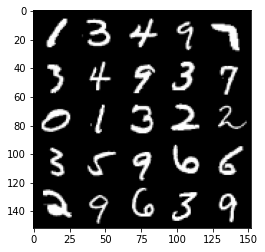

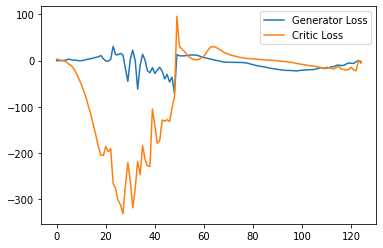

Step 2550: Generator loss: -4.206215116381645, critic loss: -19.438417209625246


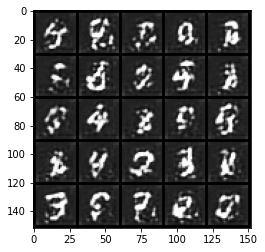

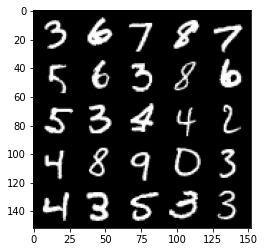

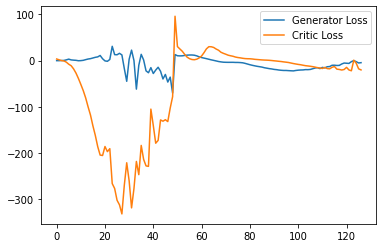

Step 2600: Generator loss: -1.2253530333936213, critic loss: -15.48591783714294


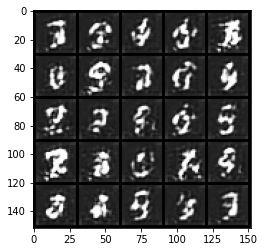

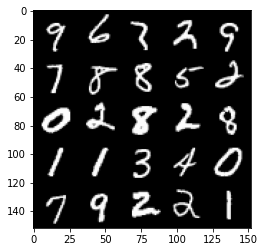

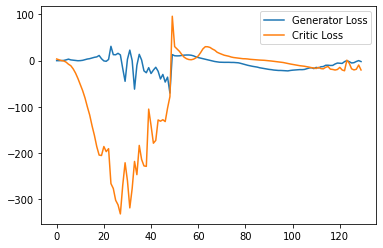

Step 2650: Generator loss: -0.18285754188895226, critic loss: -21.648924985885614


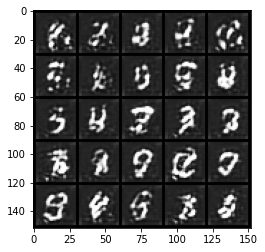

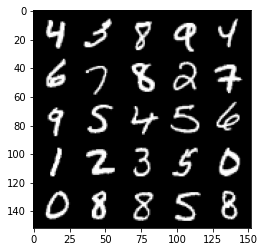

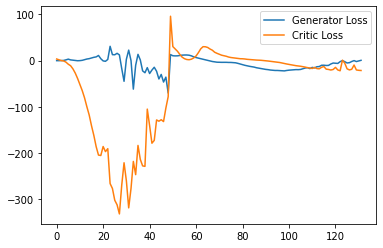

Step 2700: Generator loss: 1.575744268000126, critic loss: -22.170878177642827


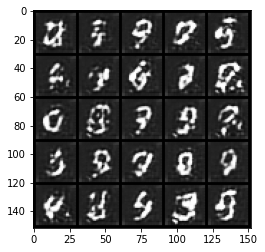

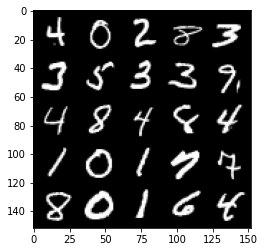

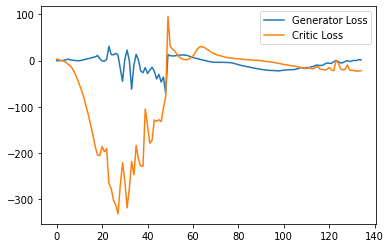

Step 2750: Generator loss: 3.60630607008934, critic loss: -20.194087988853454


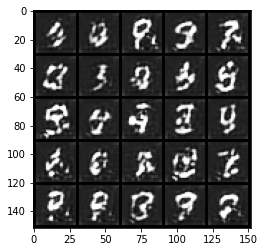

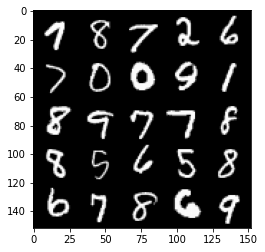

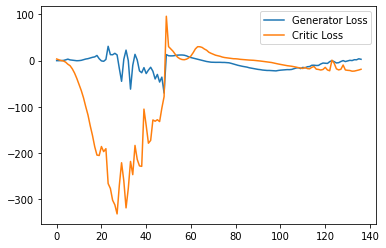

Step 2800: Generator loss: 5.178317262083292, critic loss: -16.198269464492792


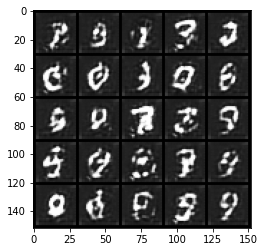

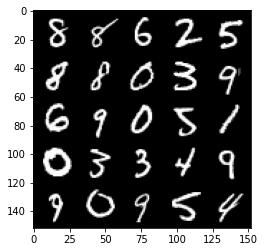

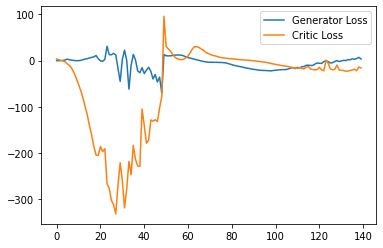

Step 2850: Generator loss: 3.3272612470388414, critic loss: -25.301094347000117


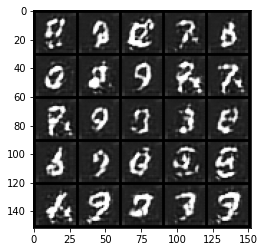

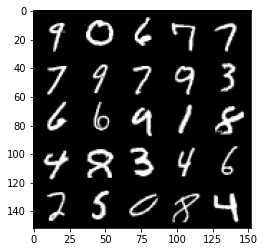

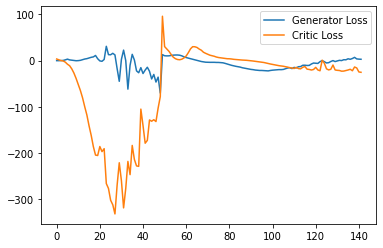

Step 2900: Generator loss: 5.562974777817726, critic loss: -24.99347208690644


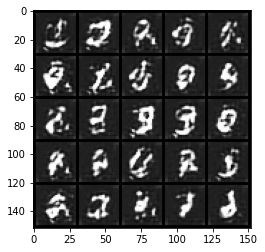

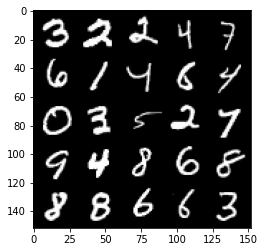

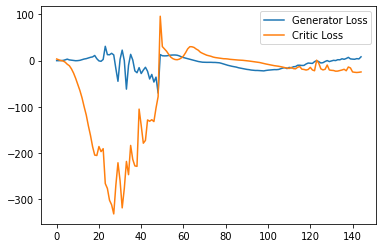

Step 2950: Generator loss: 7.640163035690785, critic loss: -16.752941456794744


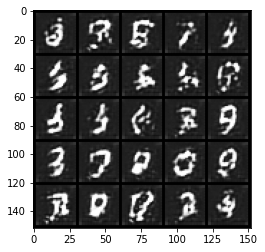

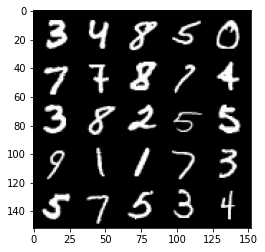

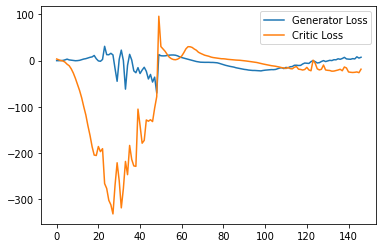

Step 3000: Generator loss: 6.639236198067665, critic loss: -17.09857549381256


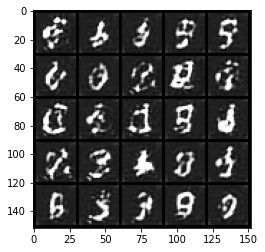

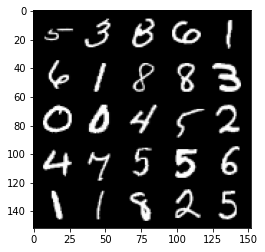

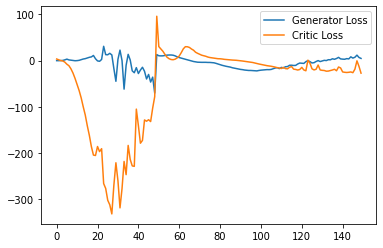

Step 3050: Generator loss: 4.521363994181156, critic loss: -25.09296279335022


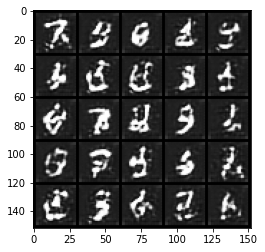

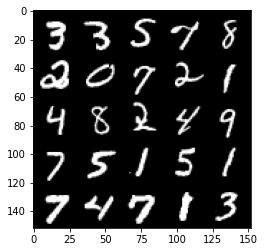

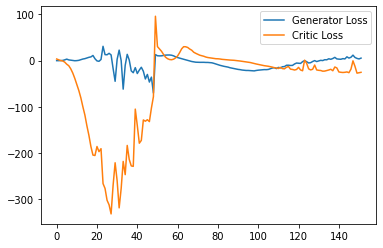

Step 3100: Generator loss: 5.902525097131729, critic loss: -25.645846652984623


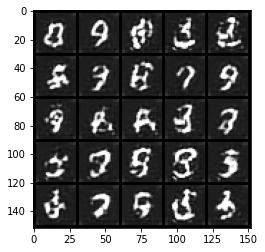

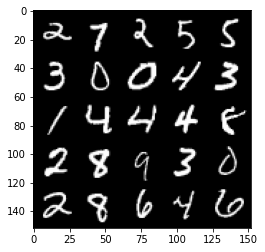

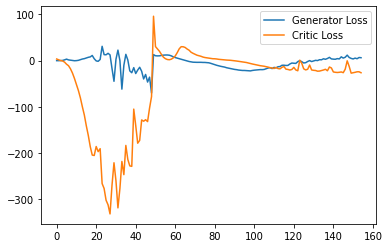

Step 3150: Generator loss: 7.590699937343597, critic loss: -18.438558344841002


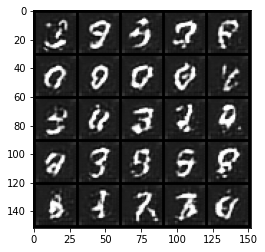

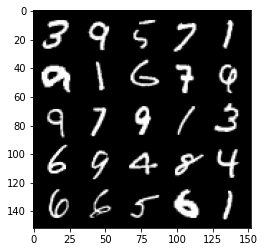

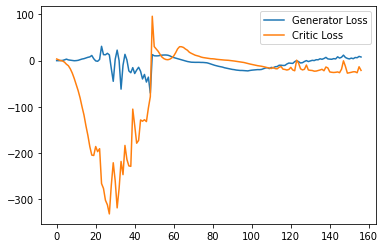

Step 3200: Generator loss: 5.777676099091768, critic loss: -22.954036008834837


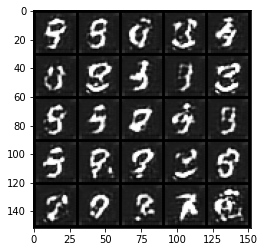

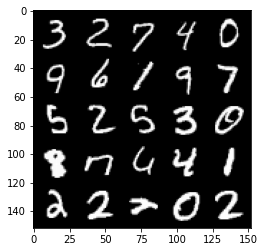

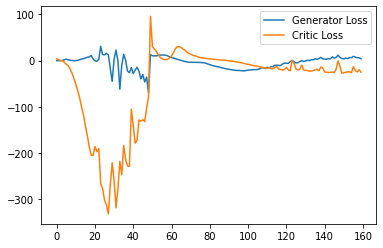

Step 3250: Generator loss: 8.736367597579957, critic loss: -20.927557607650755


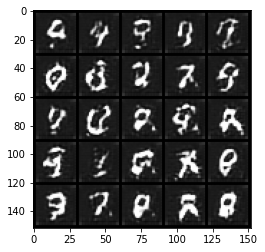

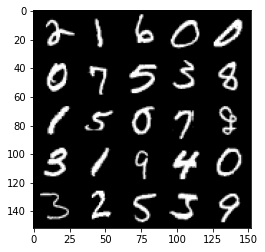

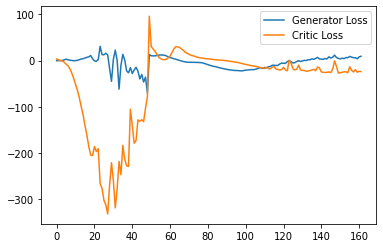

Step 3300: Generator loss: 5.0729263105988505, critic loss: -23.77636219787597


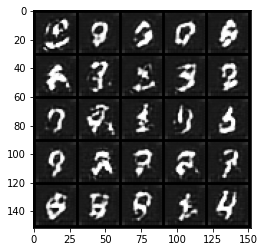

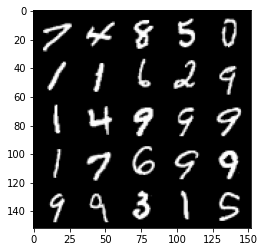

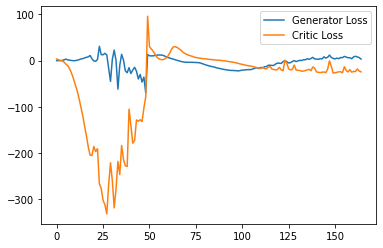

Step 3350: Generator loss: 10.72190691947937, critic loss: -6.303581878185274


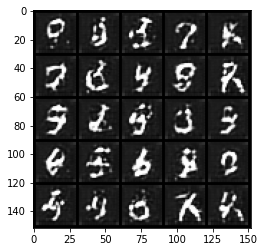

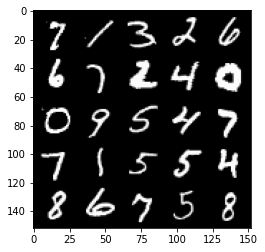

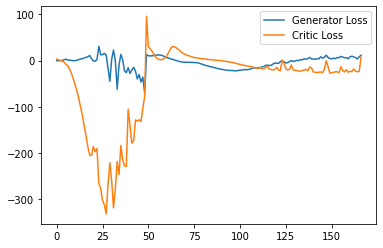

Step 3400: Generator loss: 11.818243446350097, critic loss: -1.3501977629661557


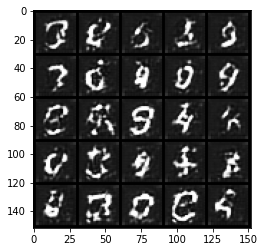

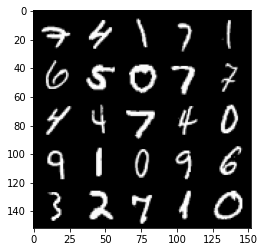

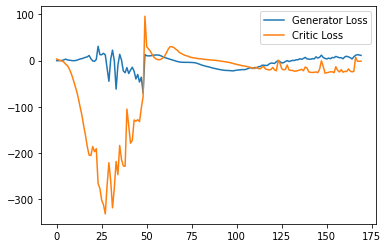

Step 3450: Generator loss: 10.522340393066406, critic loss: -1.2162533247470857


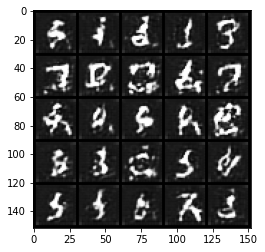

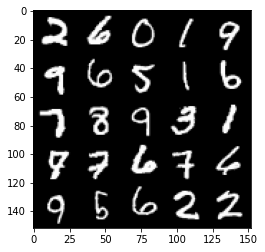

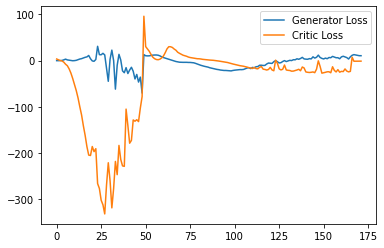

Step 3500: Generator loss: 11.540185317993163, critic loss: -1.5057929601669309


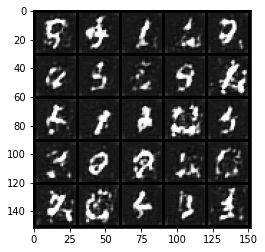

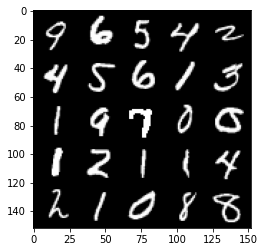

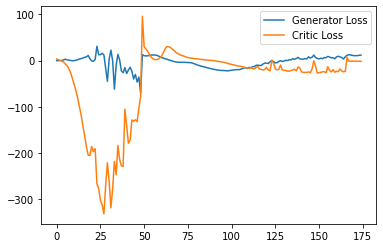

Step 3550: Generator loss: 11.64356216430664, critic loss: -1.820393196105957


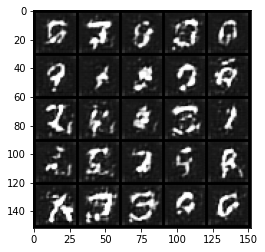

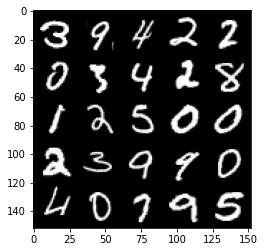

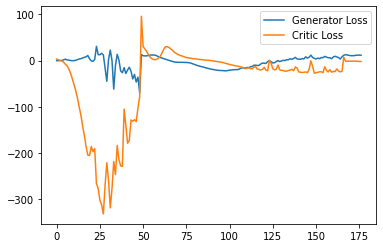

Step 3600: Generator loss: 11.650202255249024, critic loss: -2.155489986896515


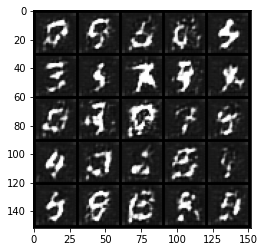

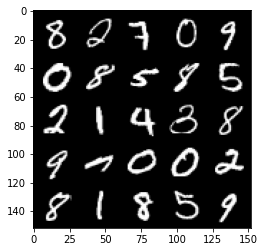

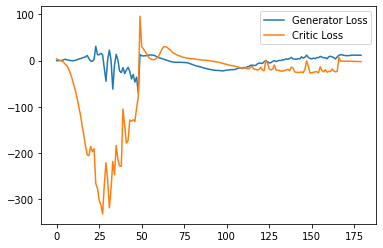

Step 3650: Generator loss: 12.061910285949708, critic loss: -2.843018562316894


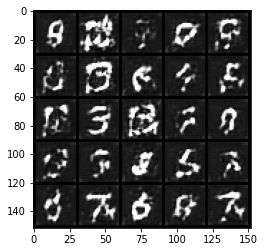

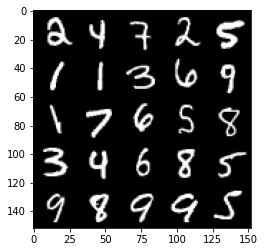

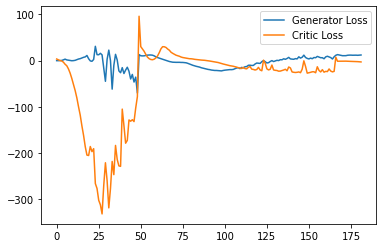

Step 3700: Generator loss: 12.90579948425293, critic loss: -3.7729067544937136


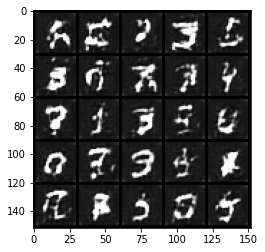

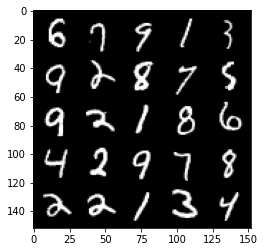

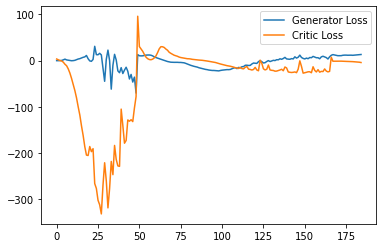

Step 3750: Generator loss: 12.592118053436279, critic loss: -7.828436048507691


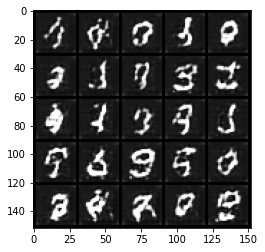

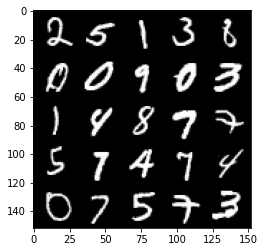

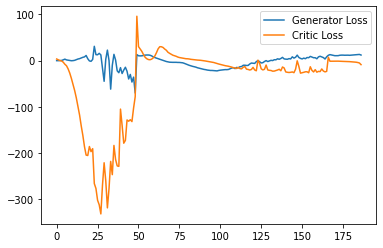

Step 3800: Generator loss: 14.581405448913575, critic loss: -11.03518560028076


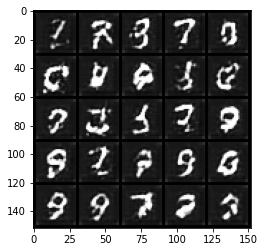

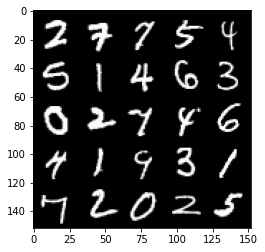

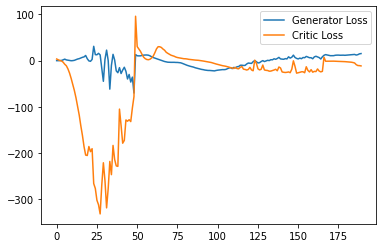

Step 3850: Generator loss: 18.171639366149904, critic loss: -7.762465661048891


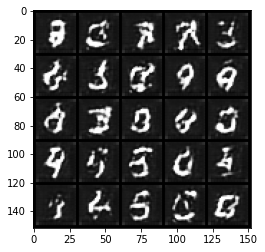

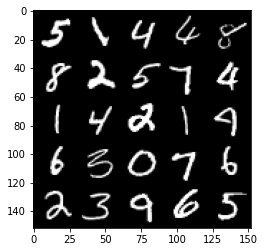

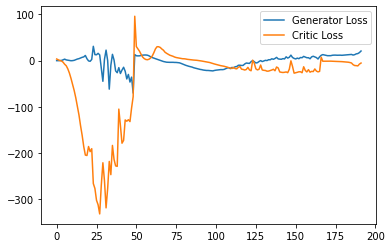

Step 3900: Generator loss: 17.0832985496521, critic loss: -10.21717460870743


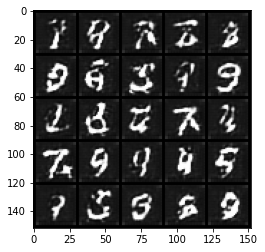

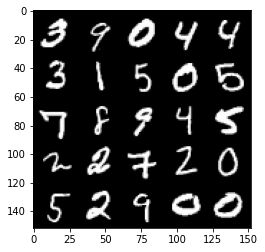

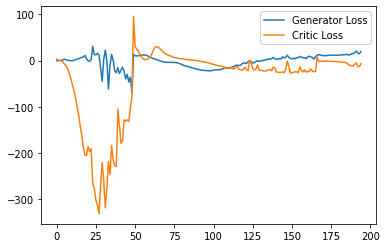

Step 3950: Generator loss: 11.337858104705811, critic loss: -13.883049182891845


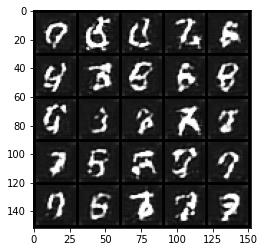

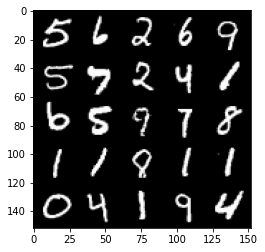

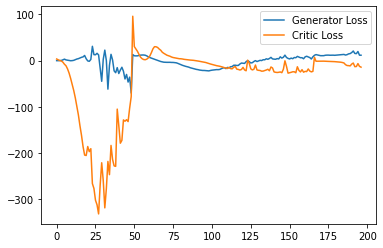

Step 4000: Generator loss: 19.593443756103515, critic loss: -2.4197192964553835


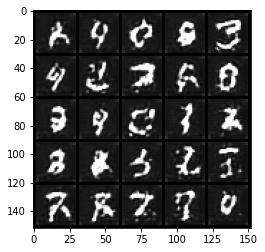

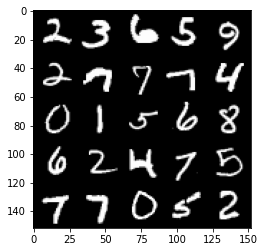

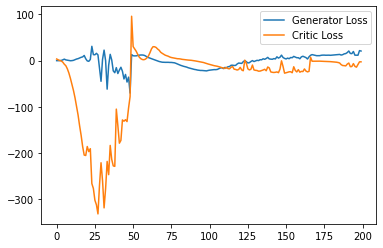

Step 4050: Generator loss: 18.190806045532227, critic loss: -2.6988002004623417


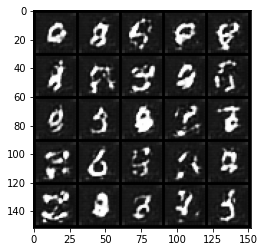

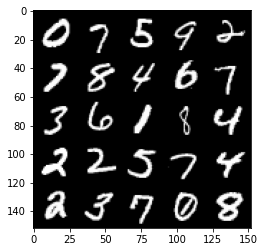

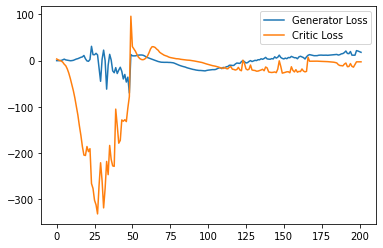

Step 4100: Generator loss: 13.41389642715454, critic loss: -8.771481069564818


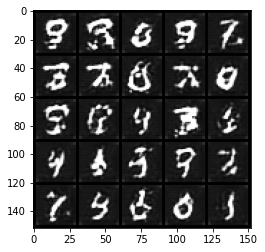

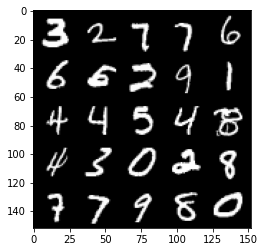

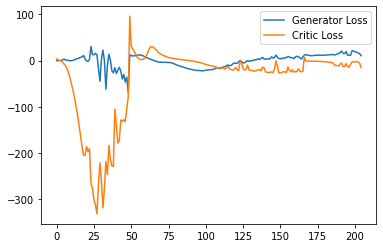

Step 4150: Generator loss: 9.69052991092205, critic loss: -15.052143096446994


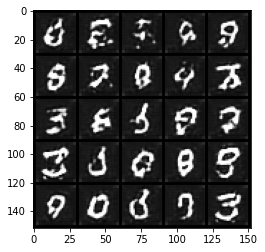

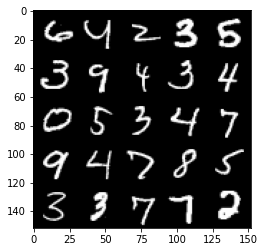

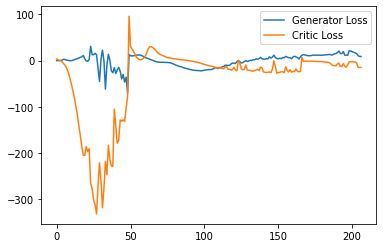

Step 4200: Generator loss: 16.745584726333618, critic loss: -8.903409196376801


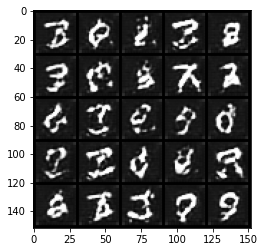

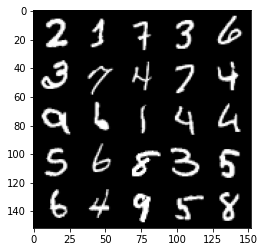

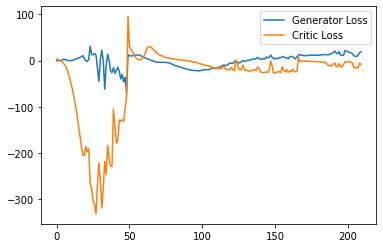

Step 4250: Generator loss: 9.961180026531219, critic loss: -17.47472022247315


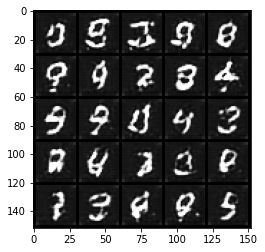

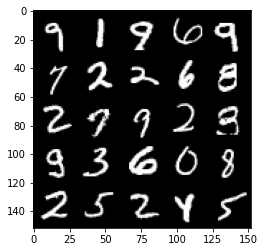

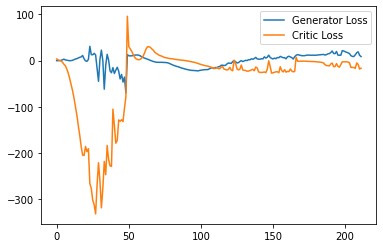

Step 4300: Generator loss: 9.382407523393631, critic loss: -15.325128418445592


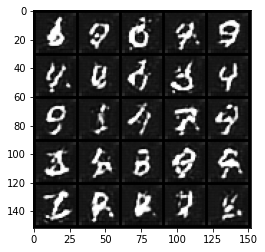

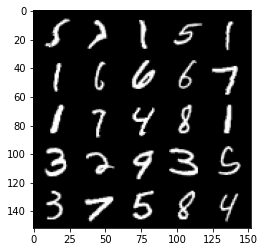

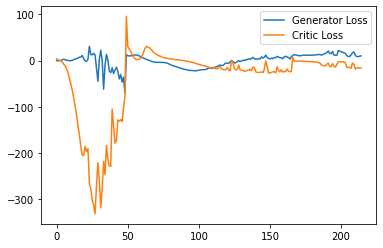

Step 4350: Generator loss: 8.626625928878784, critic loss: -16.448581542968746


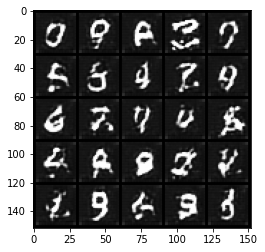

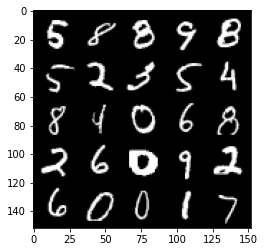

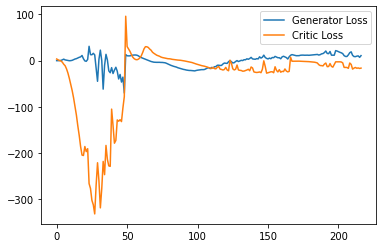

Step 4400: Generator loss: 9.13328945159912, critic loss: -15.907718573570254


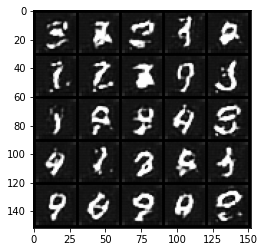

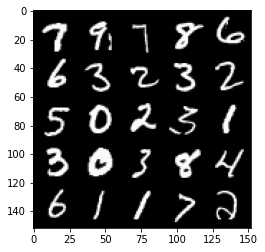

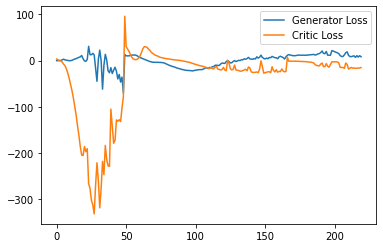

Step 4450: Generator loss: 16.146182355880736, critic loss: -6.14119231891632


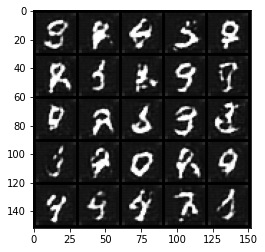

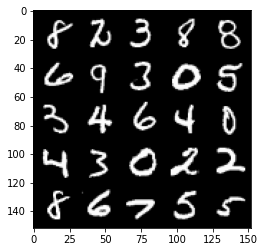

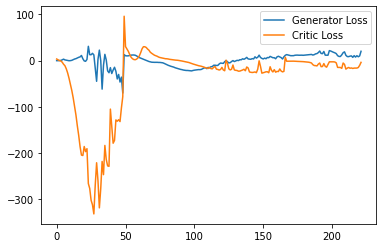

Step 4500: Generator loss: 13.679666604995727, critic loss: -7.744845710754394


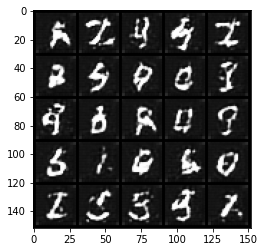

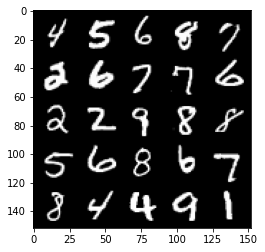

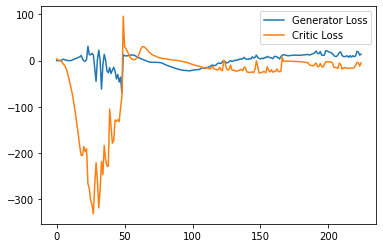

Step 4550: Generator loss: 9.403405928611756, critic loss: -14.276886103630066


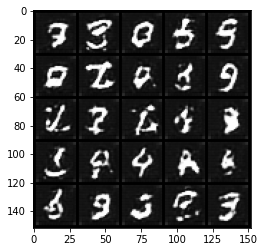

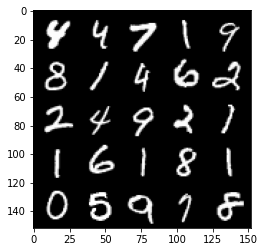

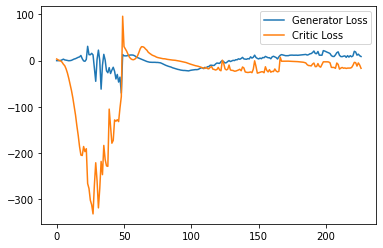

Step 4600: Generator loss: 8.600626850128174, critic loss: -15.508327411651614


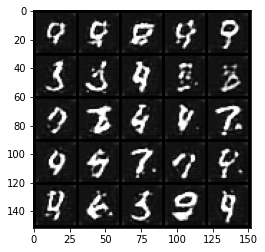

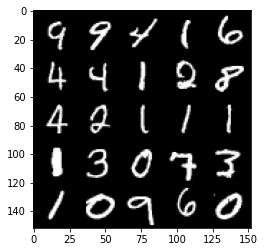

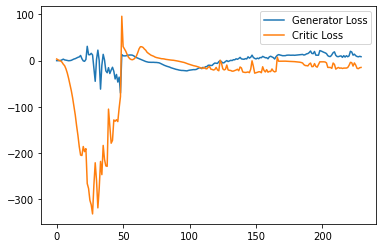

Step 4650: Generator loss: 9.514212880134583, critic loss: -15.160323167800902


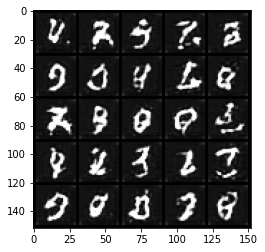

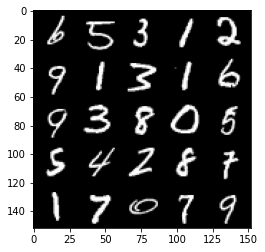

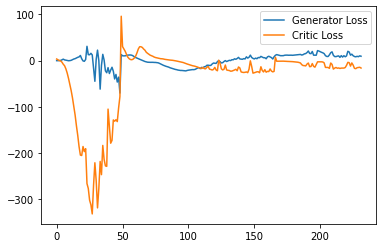

Step 4700: Generator loss: 13.940257153511048, critic loss: -10.823359078884126


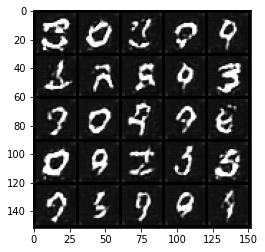

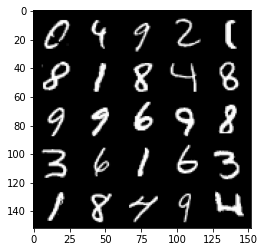

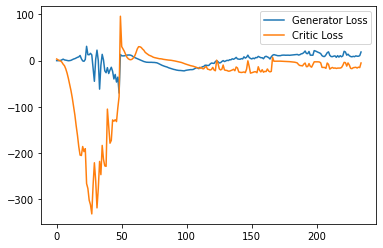

Step 4750: Generator loss: 8.272275571823121, critic loss: -15.25607819175721


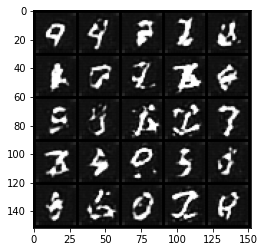

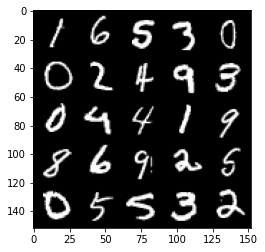

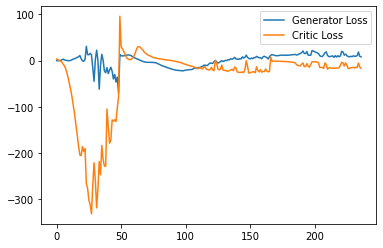

Step 4800: Generator loss: 17.158636455535888, critic loss: -1.0743447093963625


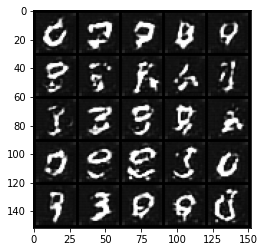

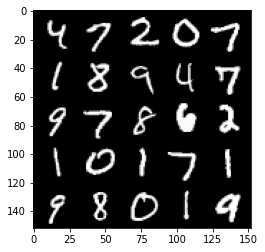

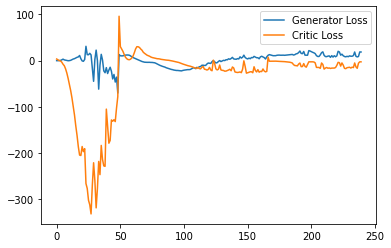

Step 4850: Generator loss: 12.477418956756592, critic loss: -2.3355942325592043


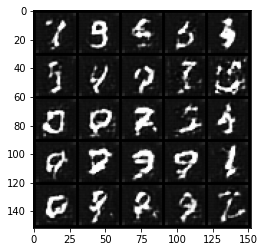

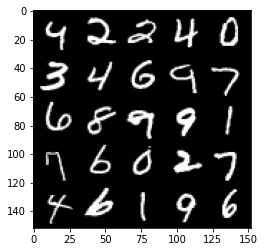

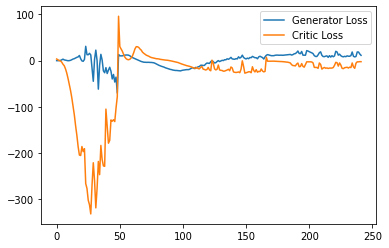

Step 4900: Generator loss: 10.431008739471435, critic loss: -2.586035918235778


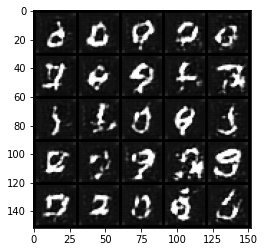

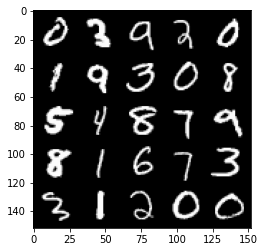

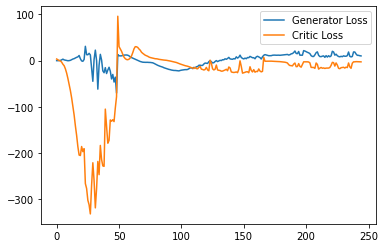

Step 4950: Generator loss: 9.664093112945556, critic loss: -5.405394358634949


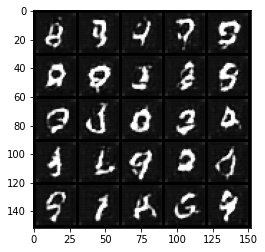

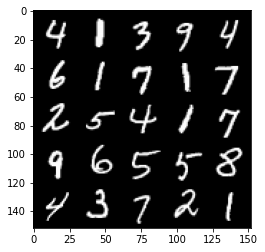

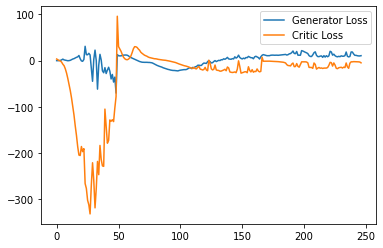

Step 5000: Generator loss: 8.117457299232482, critic loss: -14.31463272333145


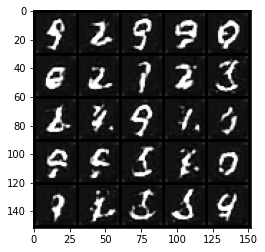

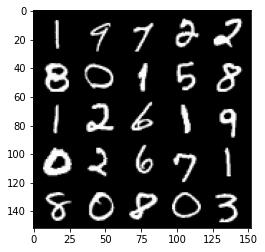

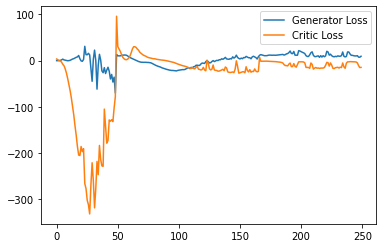

Step 5050: Generator loss: 8.791962764263154, critic loss: -13.731705812454223


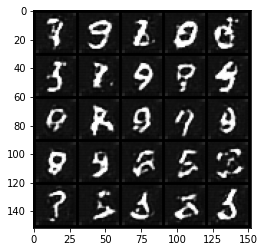

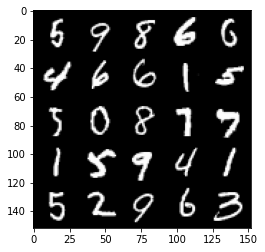

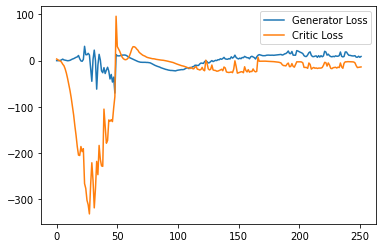

Step 5100: Generator loss: 12.286207776069642, critic loss: -6.222156701564785


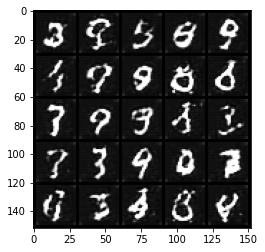

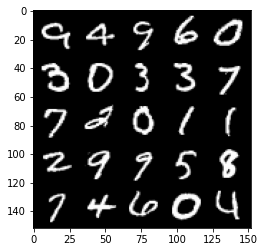

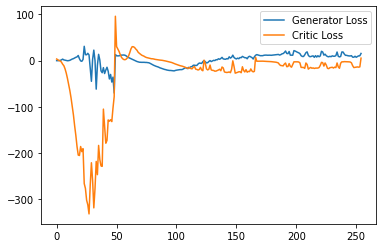

Step 5150: Generator loss: 17.609582557678223, critic loss: -2.2699338088035588


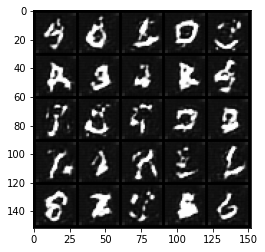

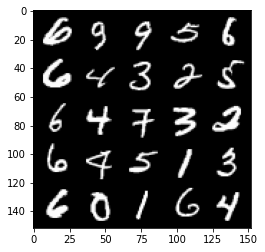

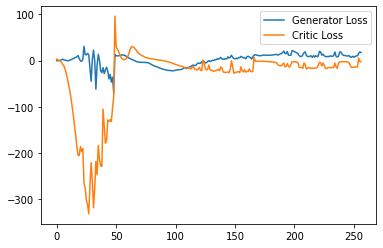

Step 5200: Generator loss: 14.05754430770874, critic loss: -2.321516256332398


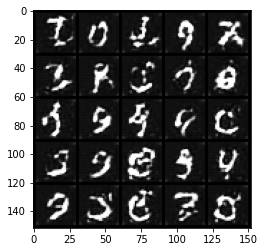

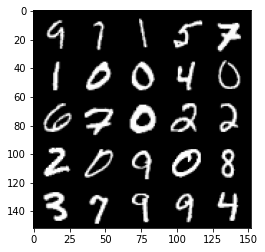

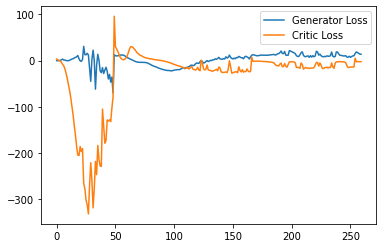

Step 5250: Generator loss: 12.692570610046387, critic loss: -2.5885153369903566


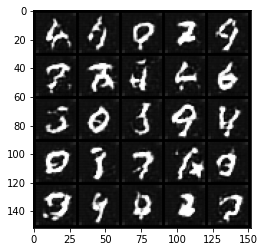

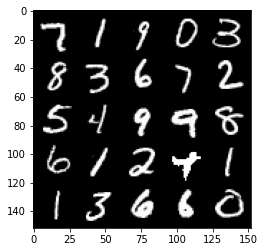

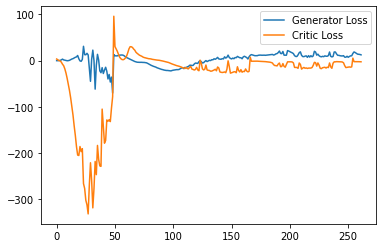

Step 5300: Generator loss: 12.092615871429443, critic loss: -2.9688656444549544


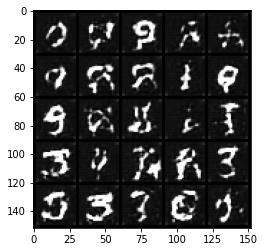

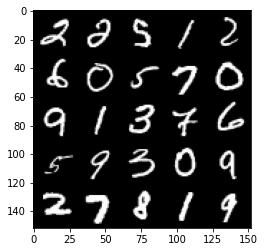

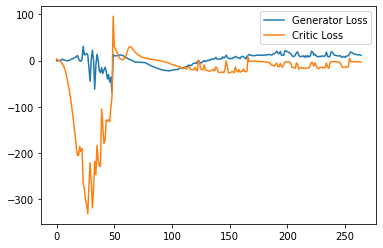

Step 5350: Generator loss: 9.924641819000245, critic loss: -4.631839708328247


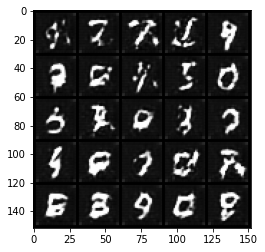

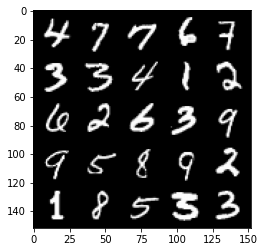

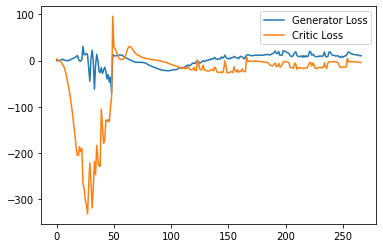

Step 5400: Generator loss: 7.485670731067658, critic loss: -13.874553936958314


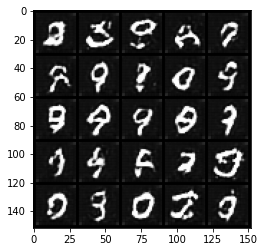

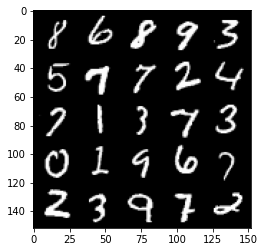

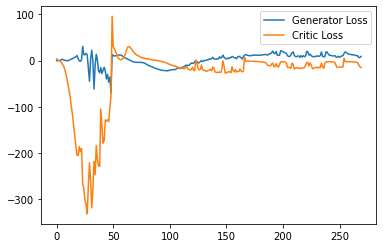

Step 5450: Generator loss: 15.57097873210907, critic loss: -4.512027968406676


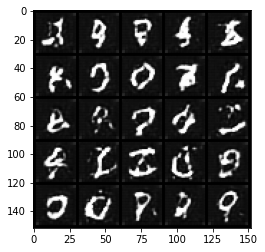

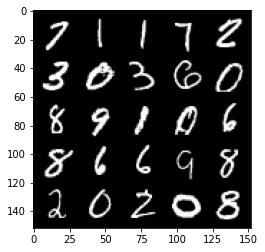

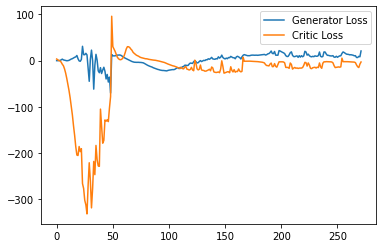

Step 5500: Generator loss: 16.20186170578003, critic loss: -3.115271501541138


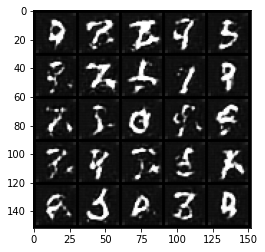

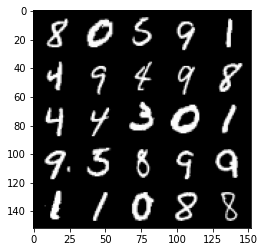

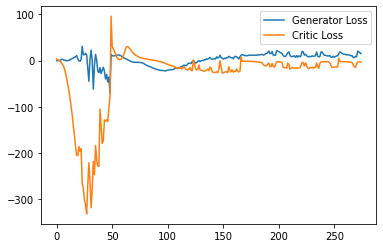

Step 5550: Generator loss: 12.9045964717865, critic loss: -5.413264158248902


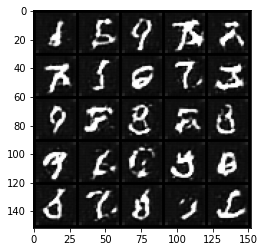

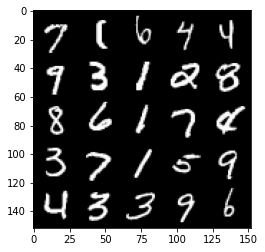

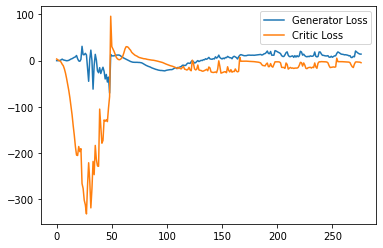

Step 5600: Generator loss: 8.201054294705392, critic loss: -15.470478822708131


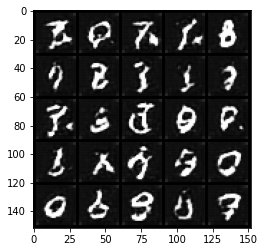

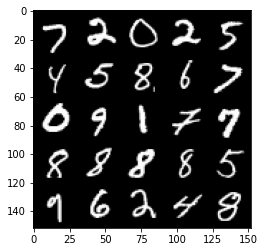

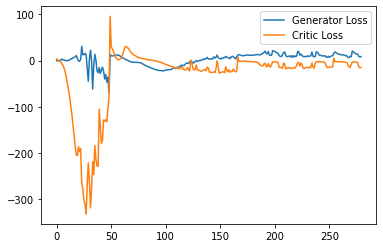

Step 5650: Generator loss: 11.987809387519956, critic loss: -10.57935453224182


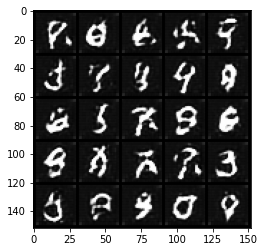

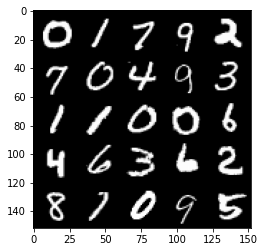

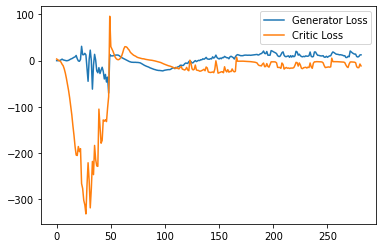

Step 5700: Generator loss: 10.134485416412353, critic loss: -14.3221346282959


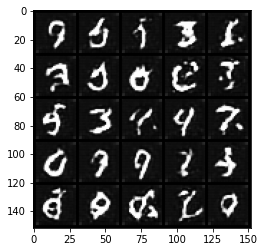

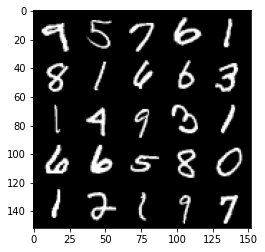

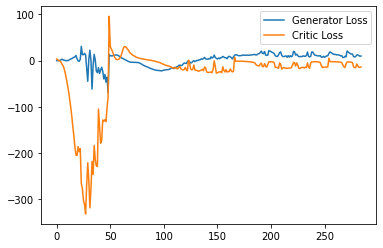

Step 5750: Generator loss: 11.238210849761963, critic loss: -13.864611332893368


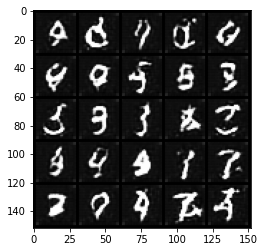

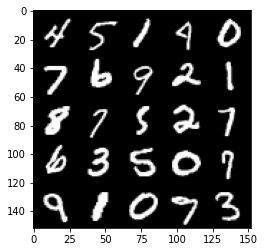

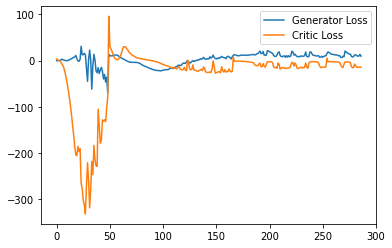

Step 5800: Generator loss: 12.923420009613038, critic loss: -13.58284174489975


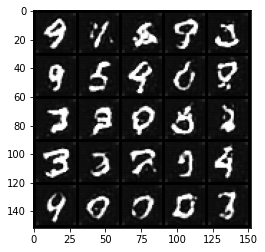

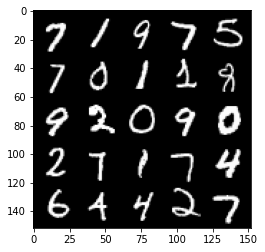

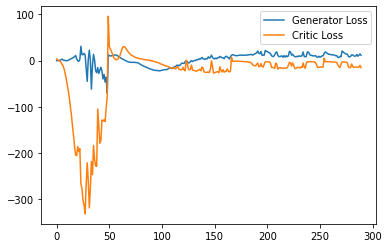

Step 5850: Generator loss: 14.689008388519287, critic loss: -11.242450716018677


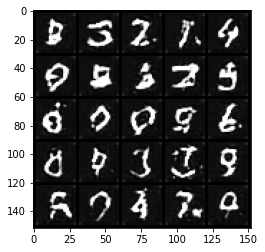

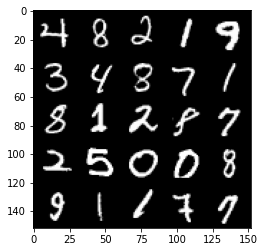

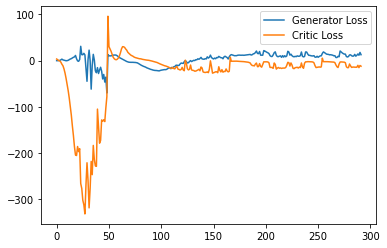

Step 5900: Generator loss: 13.15724404335022, critic loss: -9.655620935916904


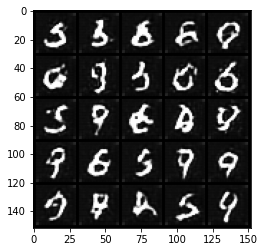

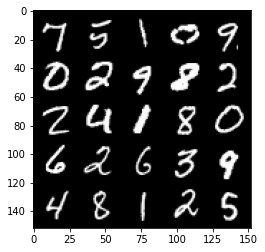

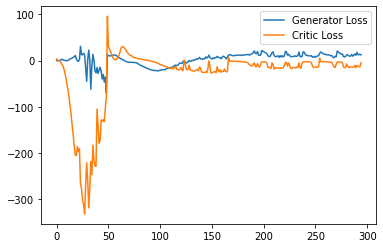

Step 5950: Generator loss: 23.192190437316896, critic loss: -2.8179461369514467


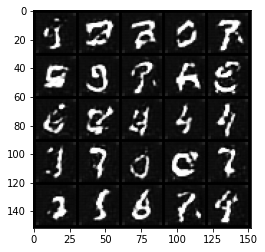

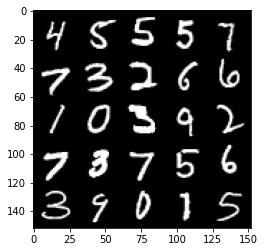

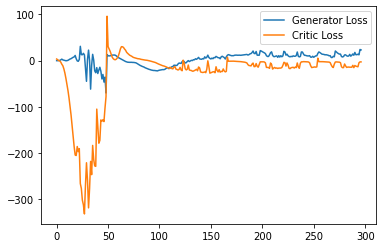

Step 6000: Generator loss: 18.90152214050293, critic loss: -2.9589112358093264


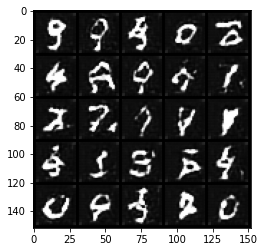

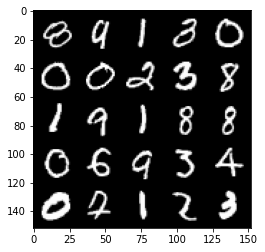

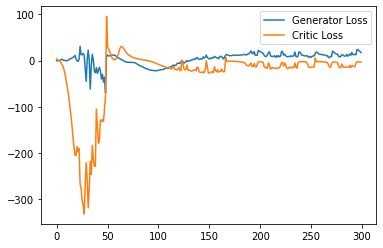

Step 6050: Generator loss: 17.21124147415161, critic loss: -4.269830061912536


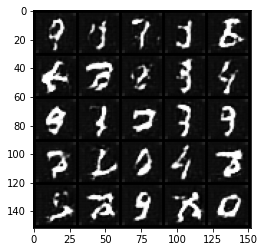

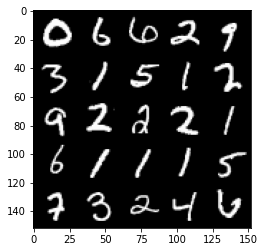

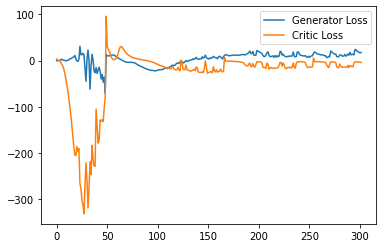

Step 6100: Generator loss: 11.434877290725709, critic loss: -12.621767996788028


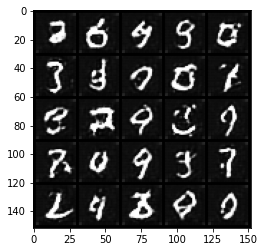

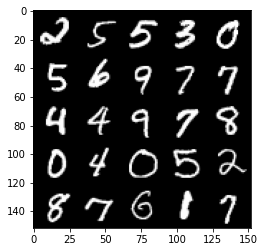

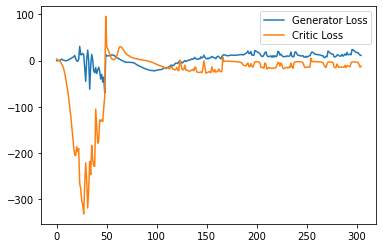

Step 6150: Generator loss: 18.39827995300293, critic loss: -6.719056452751159


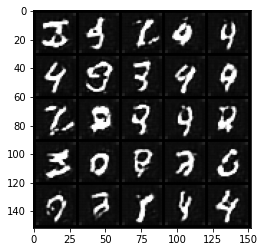

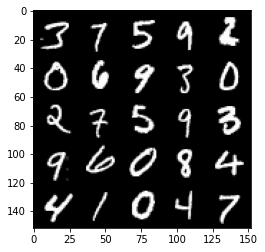

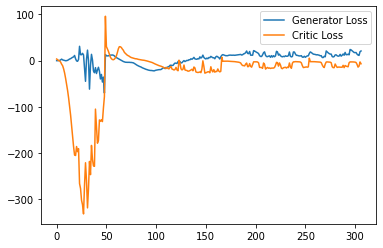

Step 6200: Generator loss: 13.766303558349609, critic loss: -13.847466738700867


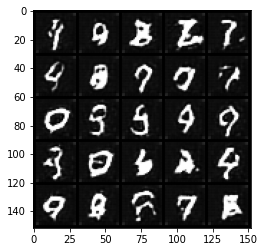

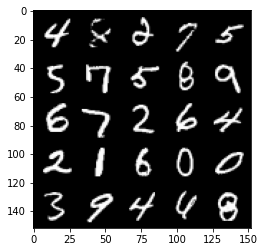

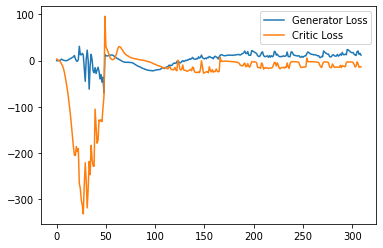

Step 6250: Generator loss: 14.284088740348816, critic loss: -11.436205400466918


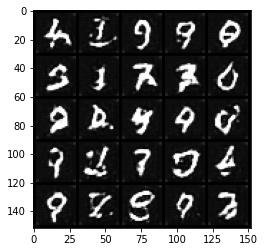

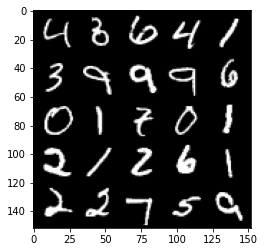

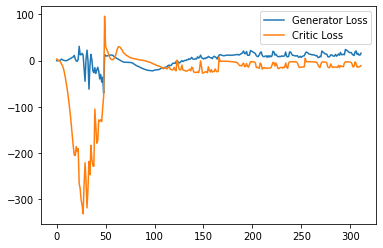

Step 6300: Generator loss: 14.033928766250611, critic loss: -13.254044867515564


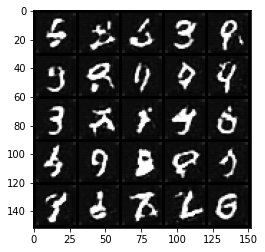

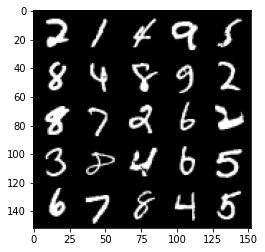

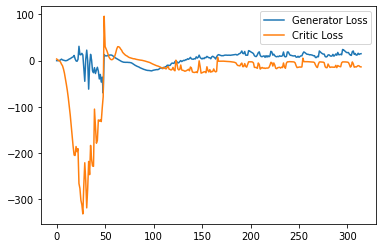

Step 6350: Generator loss: 15.301035165786743, critic loss: -11.74697973251343


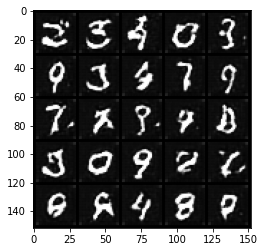

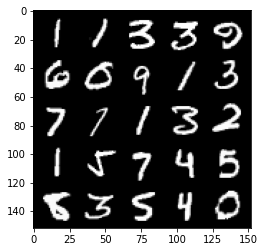

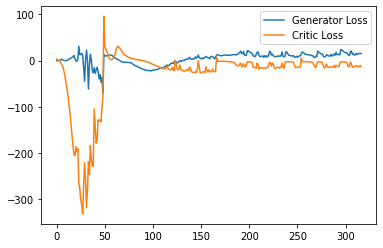

Step 6400: Generator loss: 16.375627422332762, critic loss: -12.14429778575897


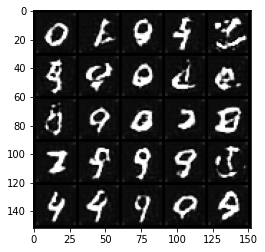

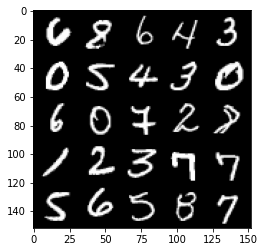

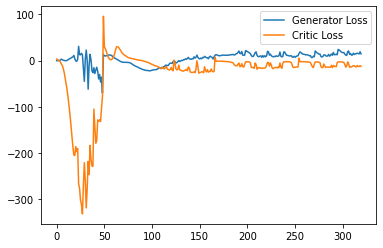

Step 6450: Generator loss: 17.14553045272827, critic loss: -5.81578150844574


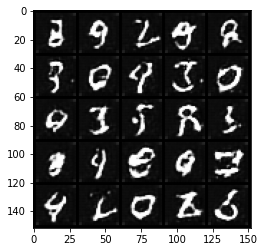

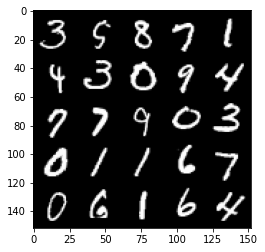

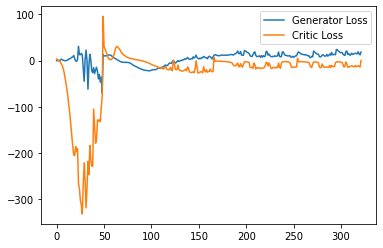

Step 6500: Generator loss: 20.722532958984374, critic loss: -2.962706564903259


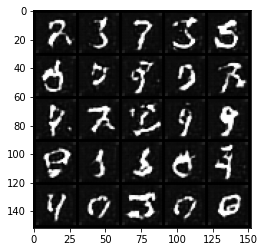

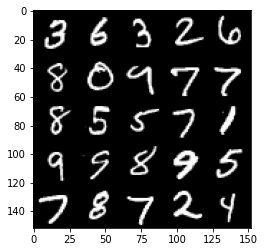

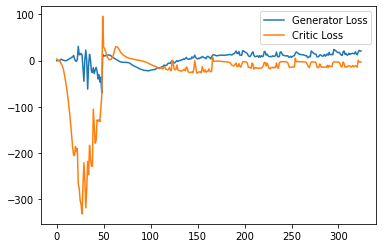

Step 6550: Generator loss: 18.96506721496582, critic loss: -5.123852647781372


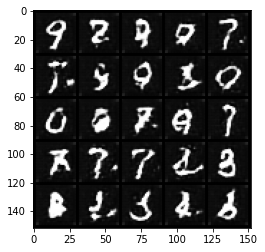

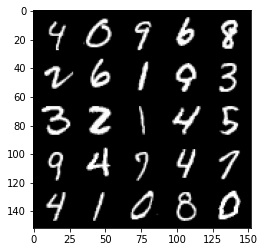

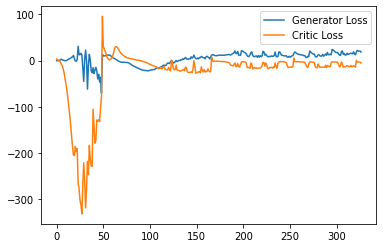

Step 6600: Generator loss: 17.3500159072876, critic loss: -8.73373160648346


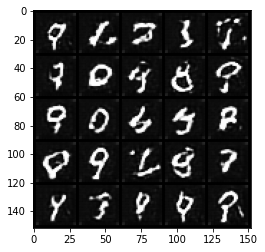

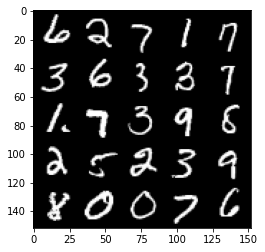

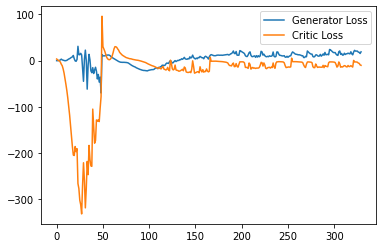

Step 6650: Generator loss: 18.15446180343628, critic loss: -10.96473639917374


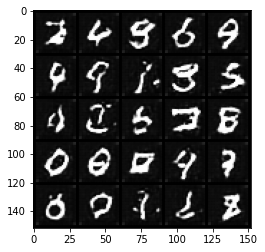

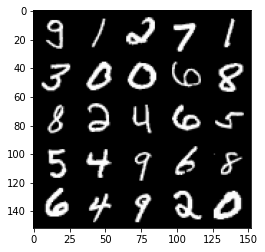

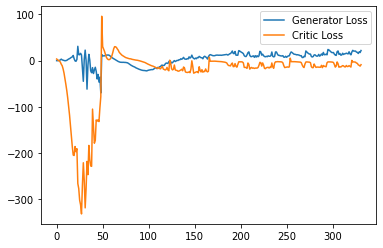

Step 6700: Generator loss: 16.691819257736206, critic loss: -11.87462408876419


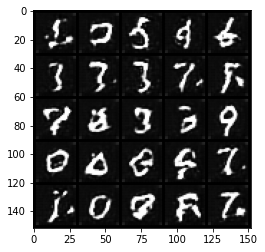

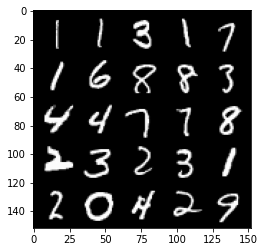

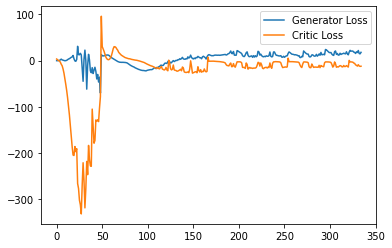

Step 6750: Generator loss: 19.481965370178223, critic loss: -1.4458465094566344


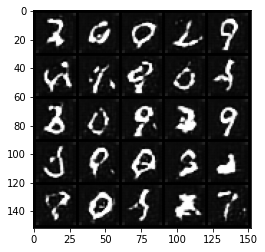

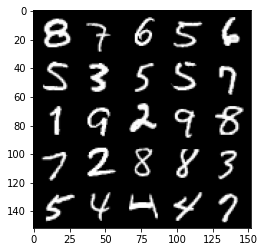

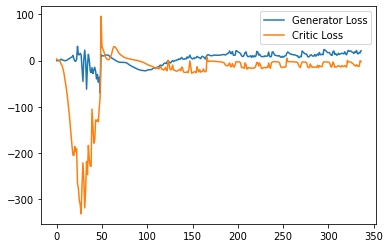

Step 6800: Generator loss: 19.51692638397217, critic loss: -3.8718561401367193


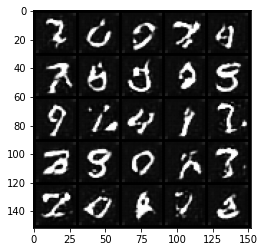

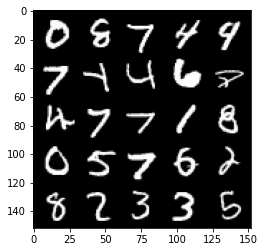

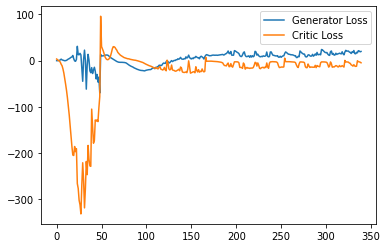

Step 6850: Generator loss: 17.388130054473876, critic loss: -10.936178564548491


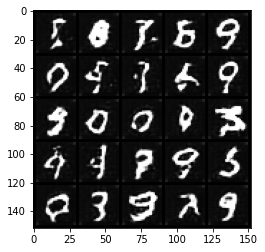

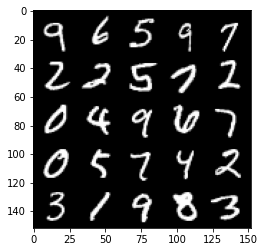

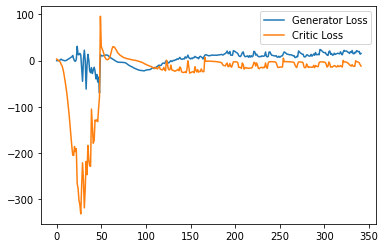

Step 6900: Generator loss: 13.797944002151489, critic loss: -15.024973962783815


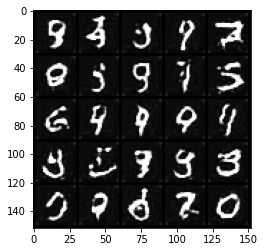

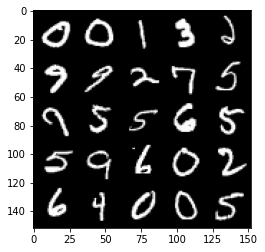

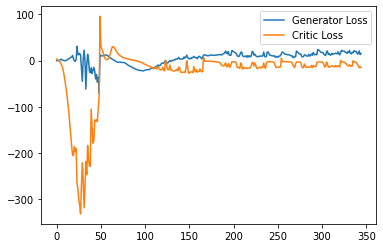

Step 6950: Generator loss: 19.340090847015382, critic loss: -5.6438736891746535


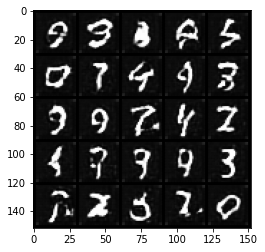

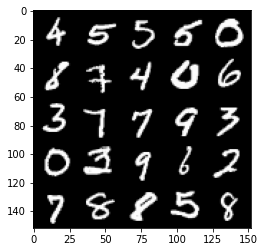

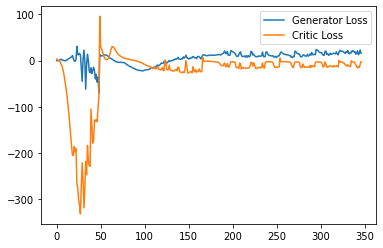

Step 7000: Generator loss: 19.96612522125244, critic loss: -11.947055697441096


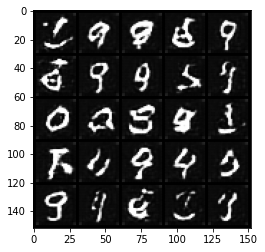

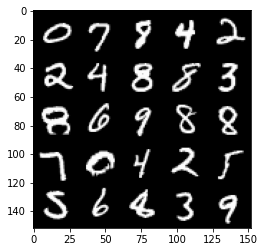

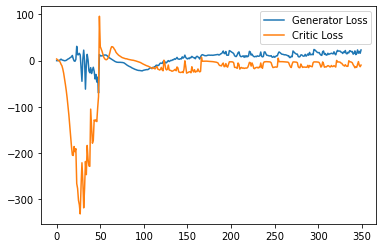

Step 7050: Generator loss: 17.6779248046875, critic loss: -12.948732616901394


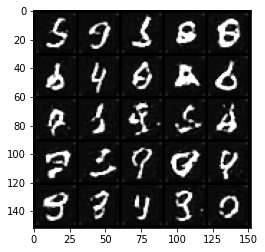

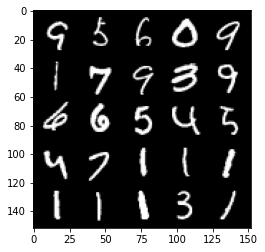

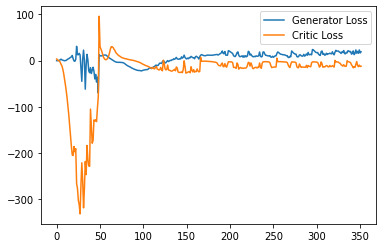

Step 7100: Generator loss: 19.067162742614745, critic loss: -11.712540979862213


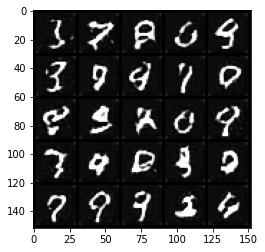

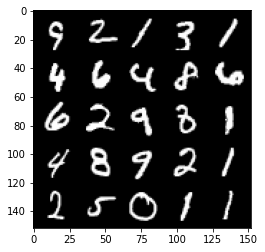

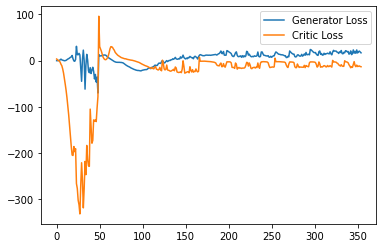

Step 7150: Generator loss: 17.621618423461914, critic loss: -13.482246212959291


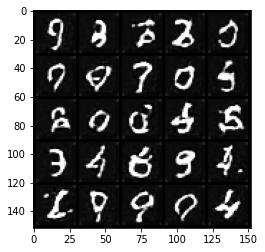

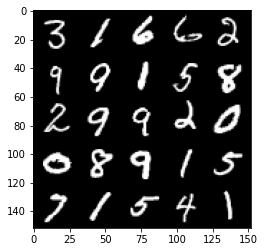

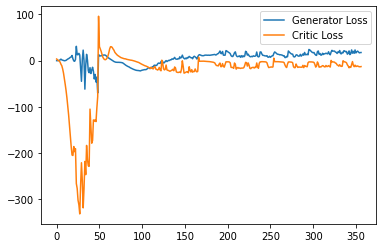

Step 7200: Generator loss: 19.53765344619751, critic loss: -13.708283211708071


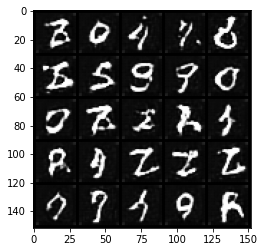

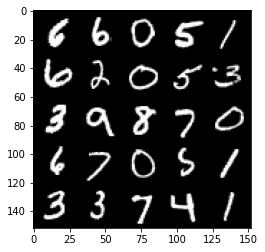

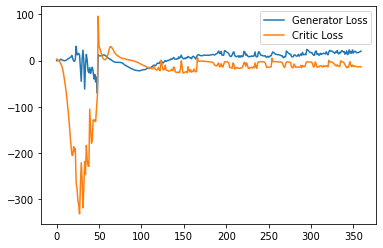

Step 7250: Generator loss: 20.001917934417726, critic loss: -12.588234527349472


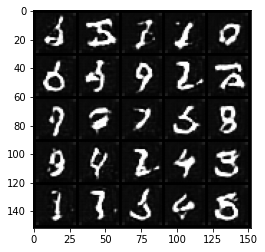

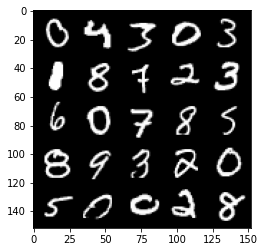

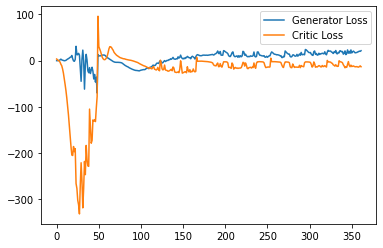

Step 7300: Generator loss: 20.517693190574647, critic loss: -6.480747452259063


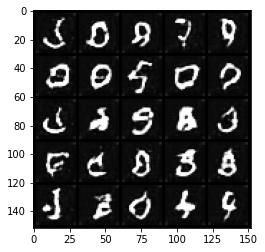

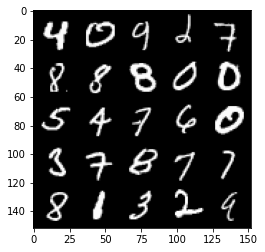

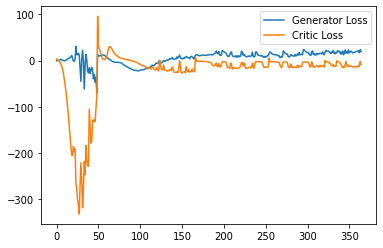

Step 7350: Generator loss: 20.05173240661621, critic loss: -10.89486567735672


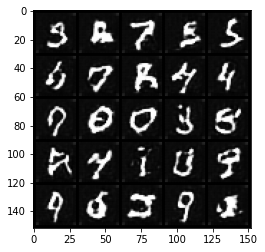

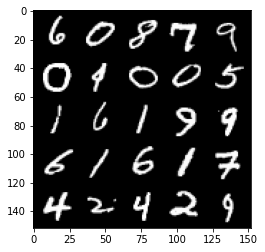

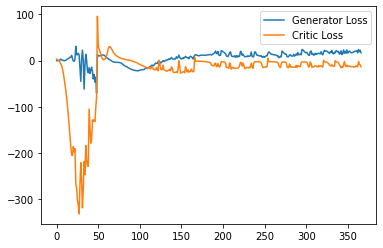

Step 7400: Generator loss: 20.33548240661621, critic loss: -12.579019391536713


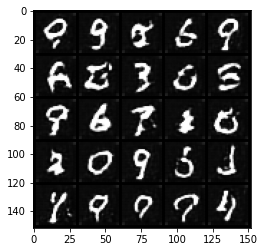

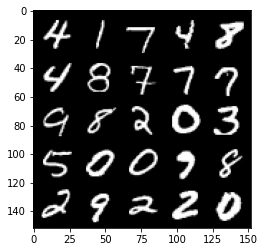

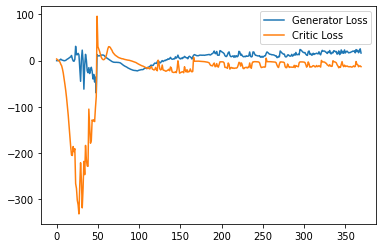

Step 7450: Generator loss: 23.09498540878296, critic loss: -7.020012191295625


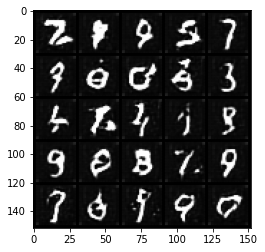

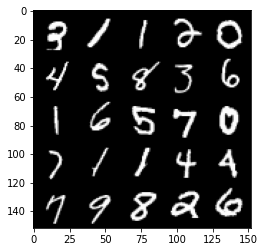

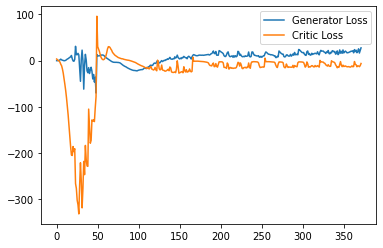

Step 7500: Generator loss: 20.24713788986206, critic loss: -12.225108027458196


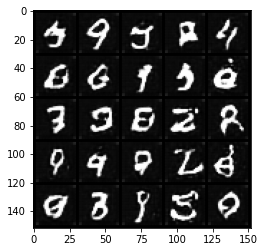

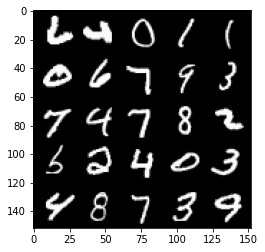

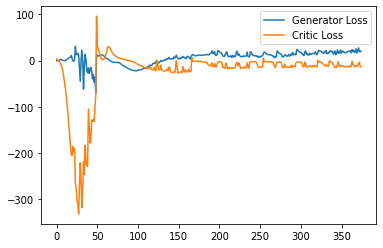

Step 7550: Generator loss: 22.809899311065674, critic loss: -12.470204010009766


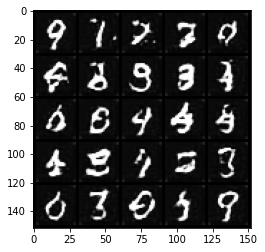

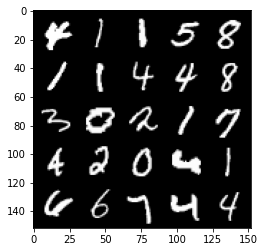

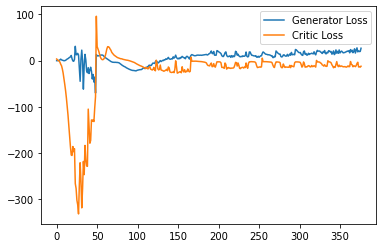

Step 7600: Generator loss: 20.249898948669433, critic loss: -12.674624825477606


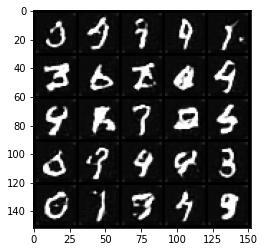

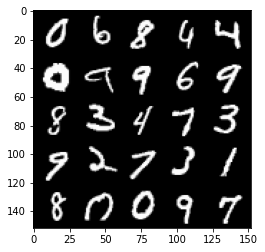

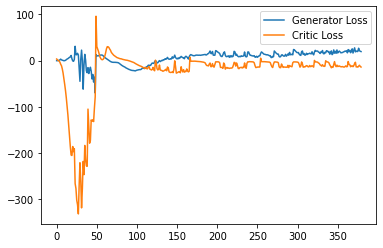

Step 7650: Generator loss: 22.88007328033447, critic loss: -7.745891529083251


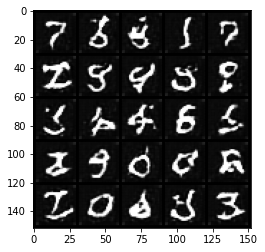

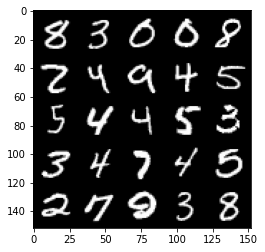

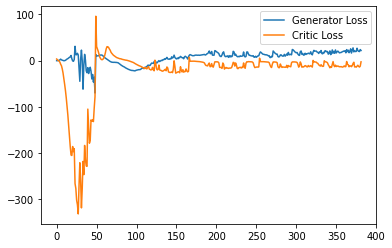

Step 7700: Generator loss: 24.535174522399902, critic loss: -7.494714537620545


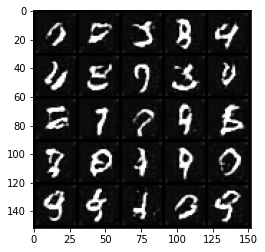

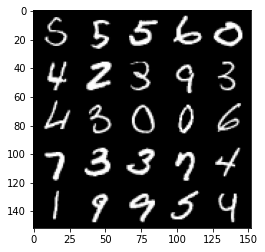

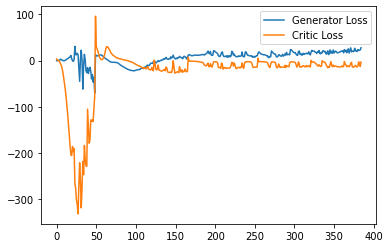

Step 7750: Generator loss: 21.583605346679686, critic loss: -9.577411752700803


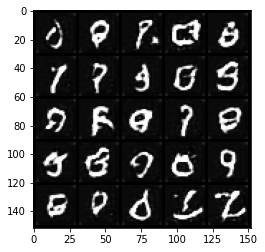

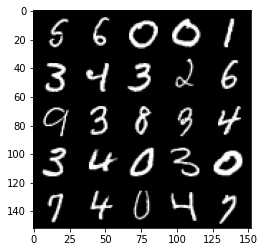

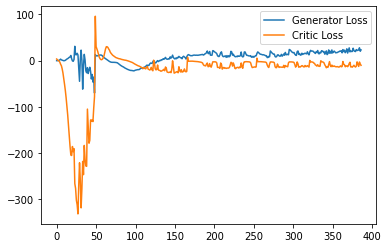

Step 7800: Generator loss: 22.23650327682495, critic loss: -12.355056671619415


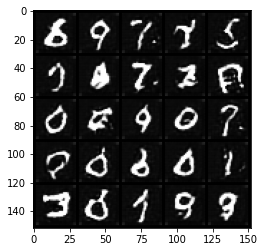

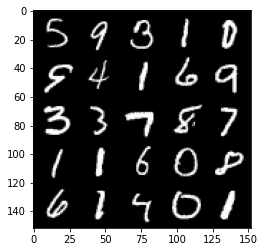

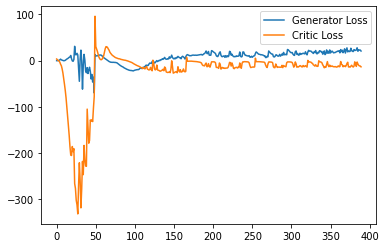

Step 7850: Generator loss: 22.22070867538452, critic loss: -14.055349585056302


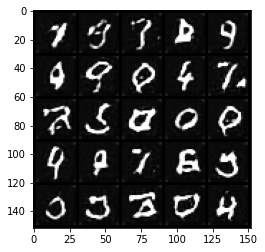

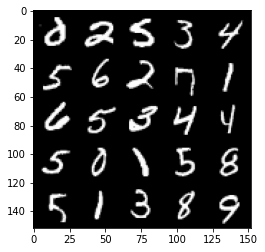

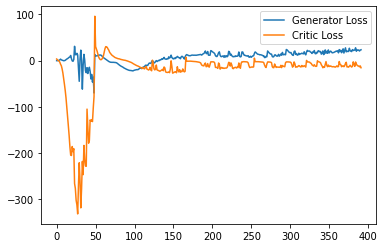

Step 7900: Generator loss: 25.757820663452147, critic loss: -12.673072177410122


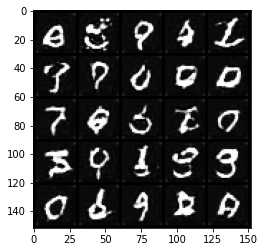

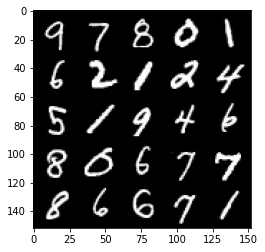

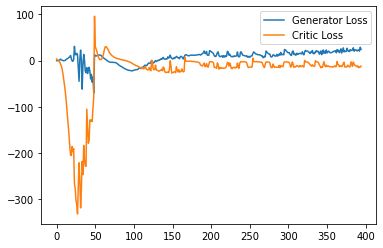

Step 7950: Generator loss: 25.81906614303589, critic loss: -10.02394317817688


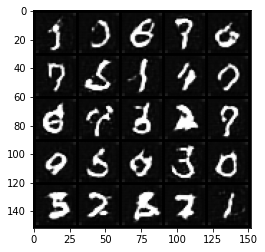

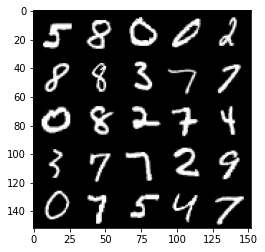

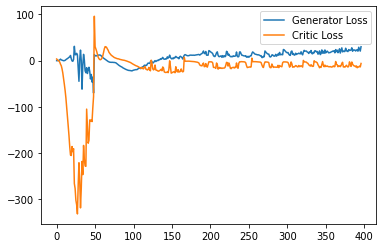

Step 8000: Generator loss: 24.241093235015867, critic loss: -10.737942438840866


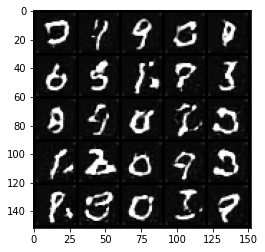

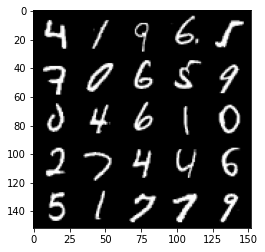

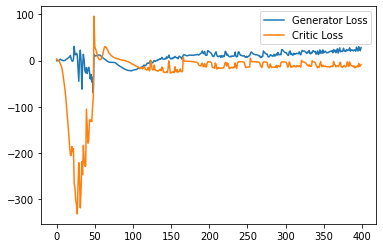

Step 8050: Generator loss: 23.29931171417236, critic loss: -13.495440717697143


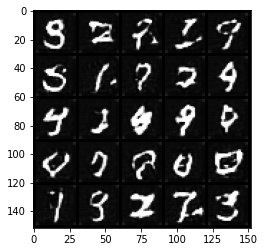

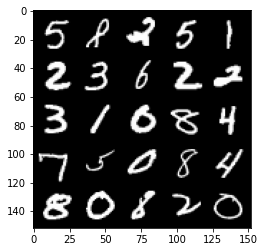

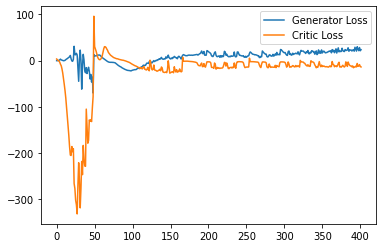

Step 8100: Generator loss: 23.42860221862793, critic loss: -13.761377168655397


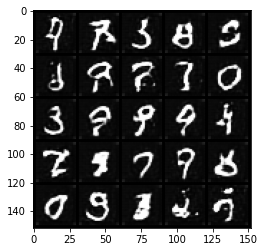

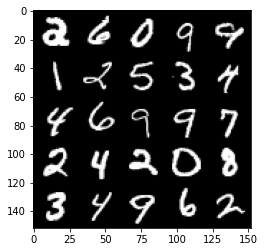

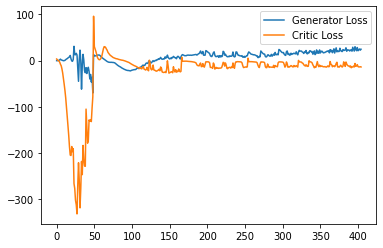

Step 8150: Generator loss: 26.520836486816407, critic loss: -7.283003195762635


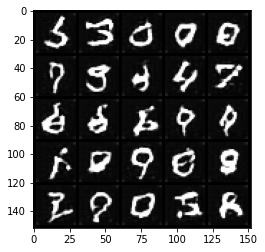

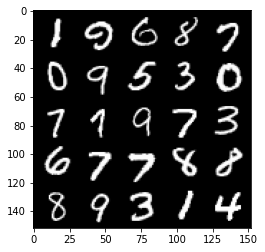

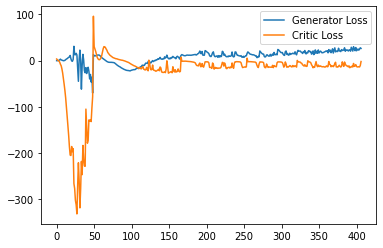

Step 8200: Generator loss: 24.315136890411377, critic loss: -11.488465903282167


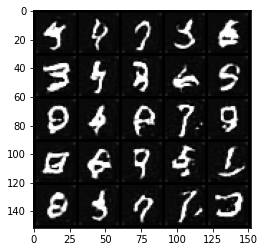

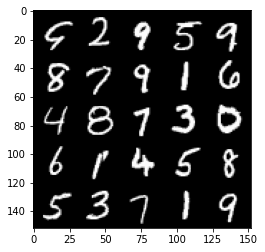

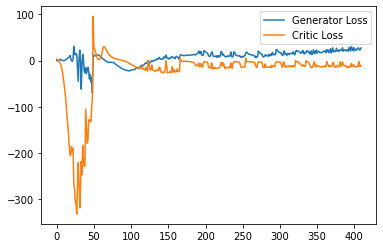

Step 8250: Generator loss: 26.19186725616455, critic loss: -12.47252596139908


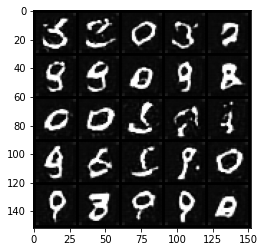

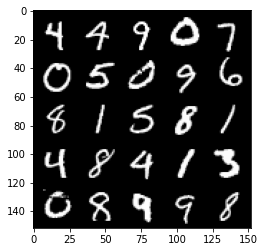

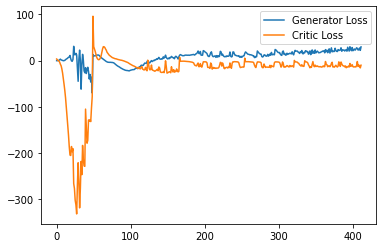

Step 8300: Generator loss: 24.631758518218994, critic loss: -13.023342628240584


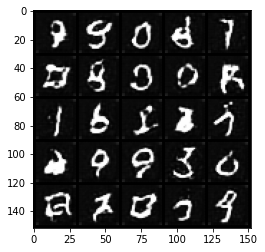

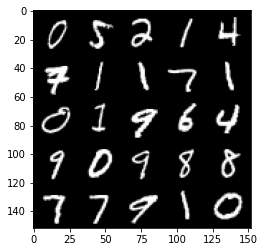

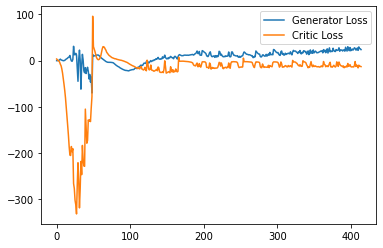

Step 8350: Generator loss: 26.364729232788086, critic loss: -8.192233818054195


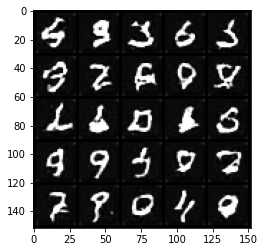

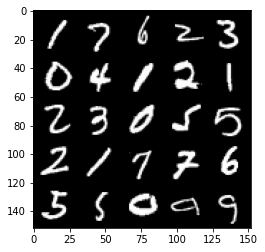

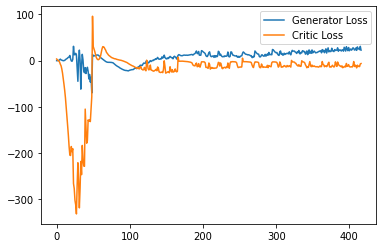

Step 8400: Generator loss: 25.977538833618166, critic loss: -12.536027294158936


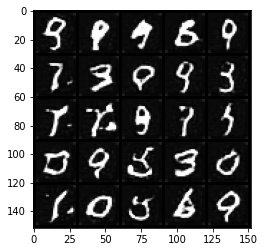

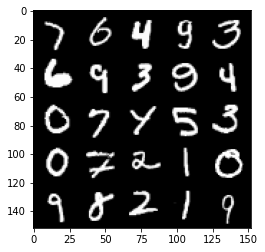

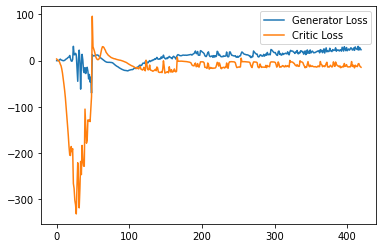

Step 8450: Generator loss: 24.69280330657959, critic loss: -13.332883392810825


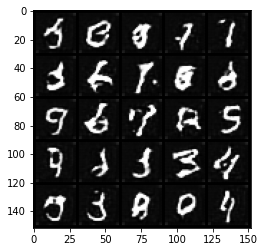

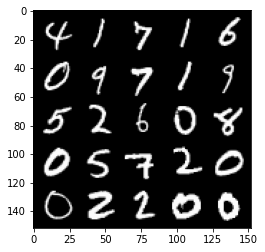

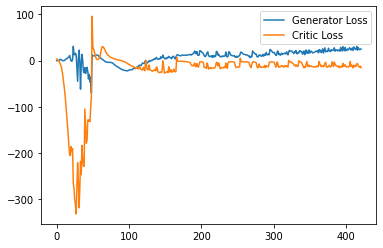

Step 8500: Generator loss: 28.92378791809082, critic loss: -10.774839303016659


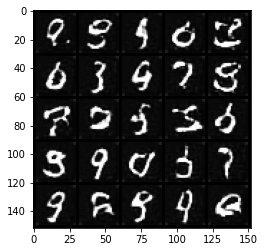

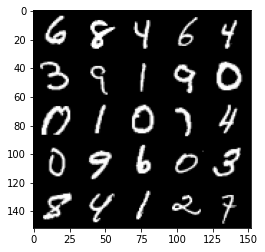

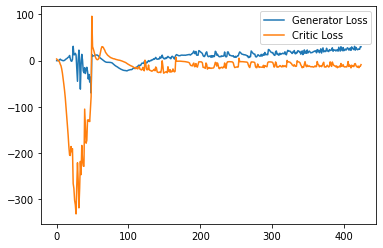

Step 8550: Generator loss: 27.719764995574952, critic loss: -12.164822863578795


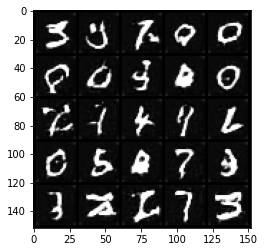

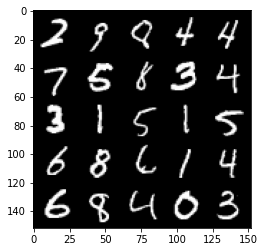

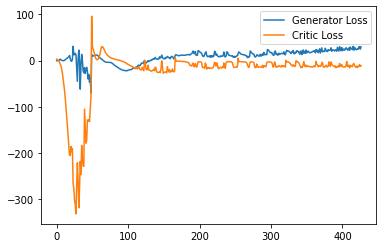

Step 8600: Generator loss: 29.719016761779784, critic loss: -11.155159610271456


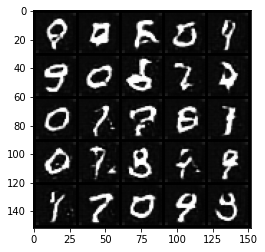

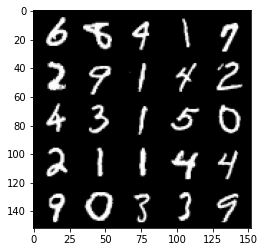

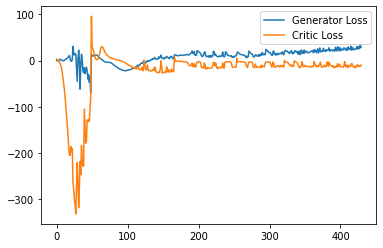

Step 8650: Generator loss: 28.723787517547606, critic loss: -11.54710126280784


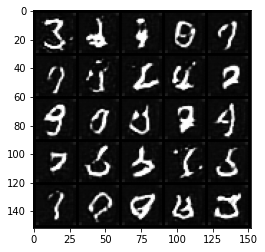

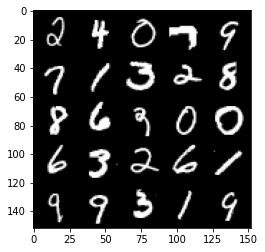

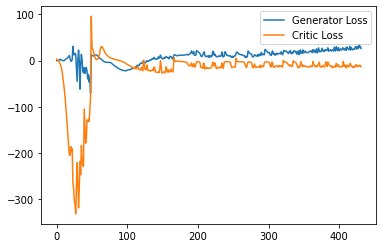

Step 8700: Generator loss: 27.84842821121216, critic loss: -11.00329834008217


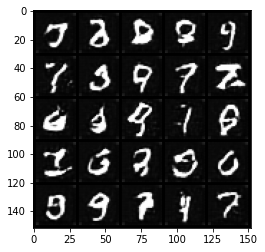

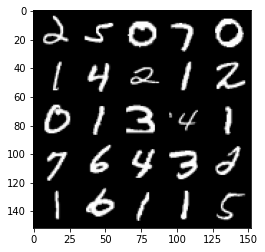

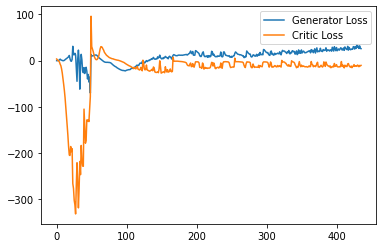

Step 8750: Generator loss: 30.567785339355467, critic loss: -12.134107111930849


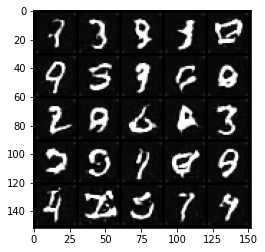

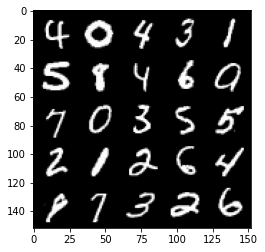

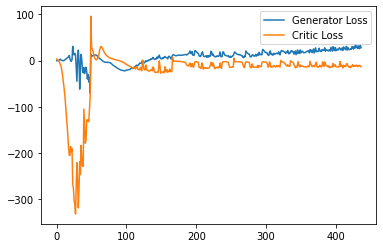

Step 8800: Generator loss: 27.46072353363037, critic loss: -14.064173511505128


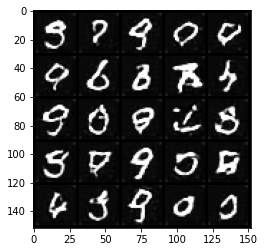

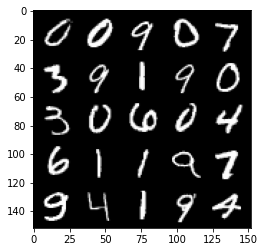

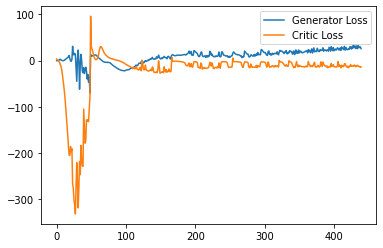

Step 8850: Generator loss: 25.528590316772462, critic loss: -15.353853444099425


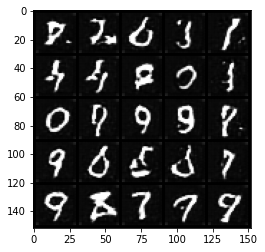

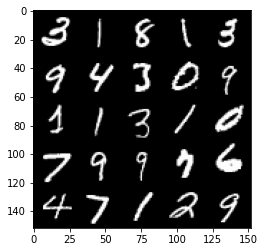

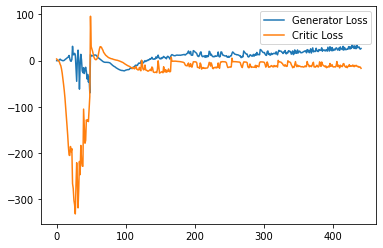

Step 8900: Generator loss: 28.83323770880699, critic loss: -0.5943406825065611


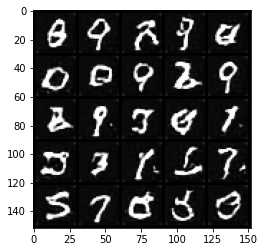

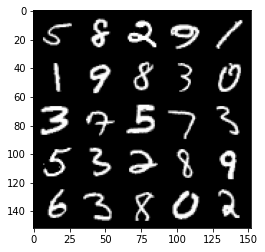

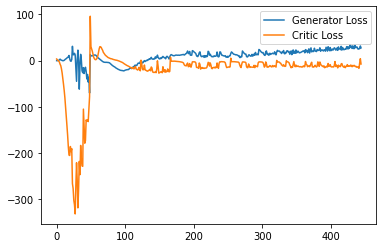

Step 8950: Generator loss: 30.691692123413088, critic loss: -9.93208368062973


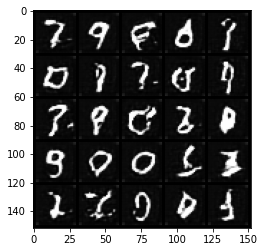

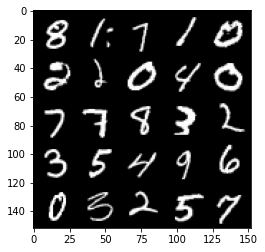

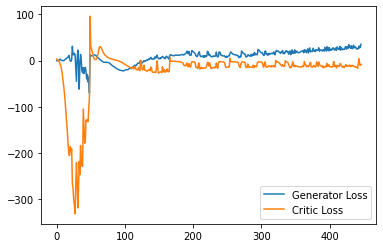

Step 9000: Generator loss: 29.313156299591064, critic loss: -11.116456935882567


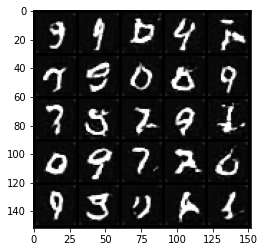

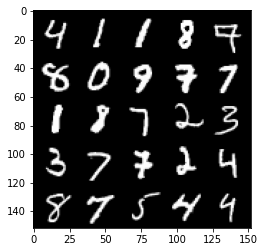

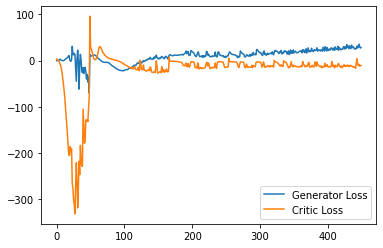

Step 9050: Generator loss: 29.329303092956543, critic loss: -8.652951548576358


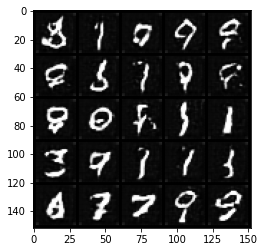

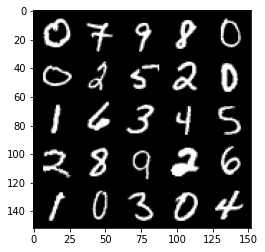

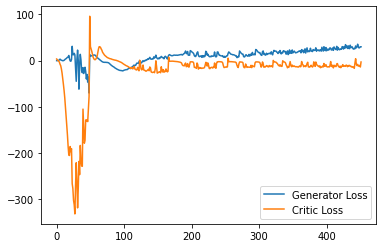

Step 9100: Generator loss: 31.046641159057618, critic loss: -11.531671277523037


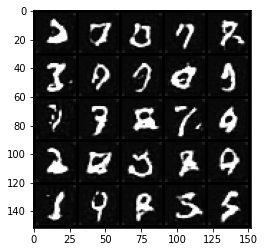

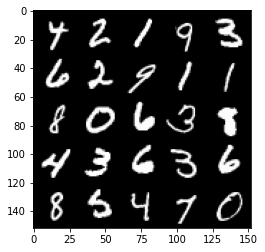

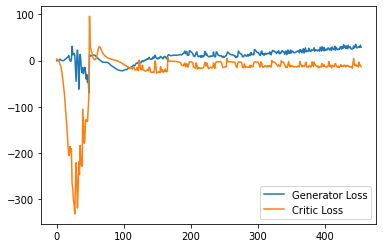

Step 9150: Generator loss: 32.140671463012694, critic loss: -9.978392172336582


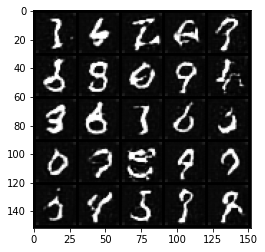

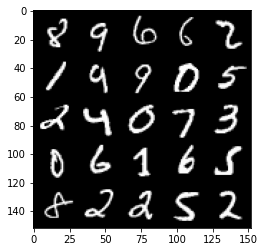

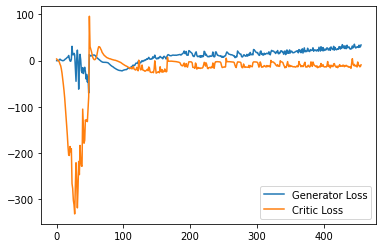

Step 9200: Generator loss: 30.419202766418458, critic loss: -12.081821754217147


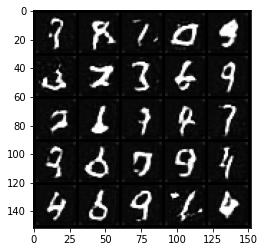

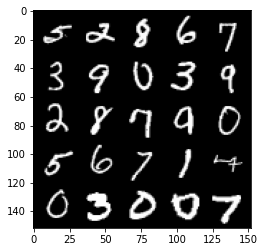

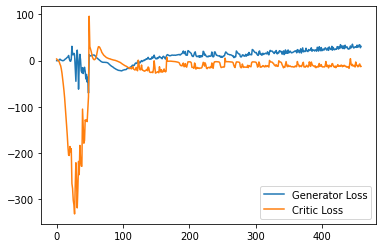

Step 9250: Generator loss: 34.35561664581299, critic loss: -10.49535639190674


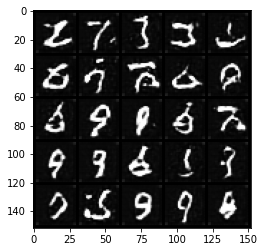

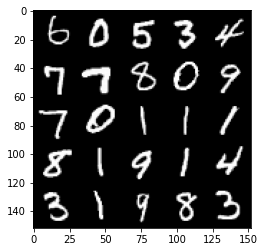

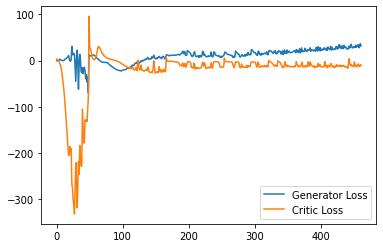

Step 9300: Generator loss: 31.777920722961426, critic loss: -9.713734459161758


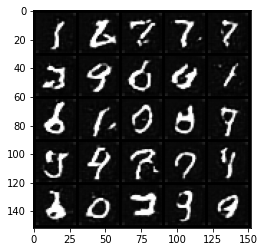

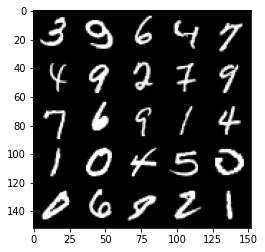

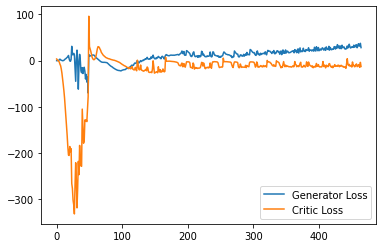

Step 9350: Generator loss: 34.14337413787842, critic loss: -9.142389327049257


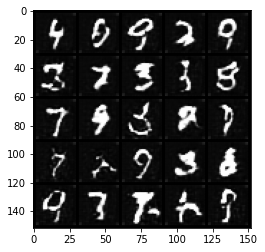

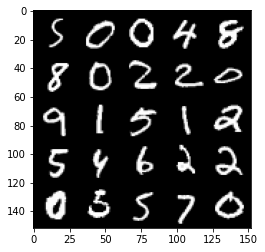

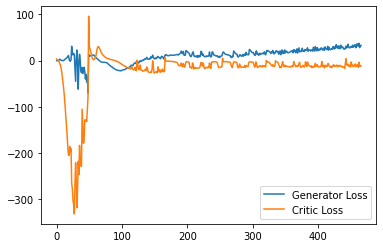

Step 9400: Generator loss: 32.186853370666505, critic loss: -6.4909693636894215


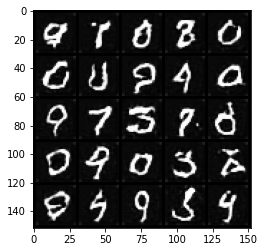

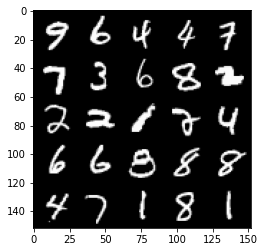

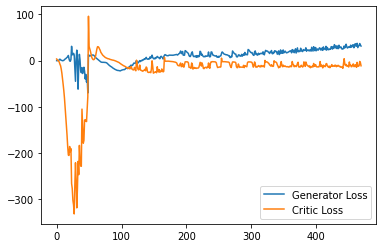

Step 9450: Generator loss: 32.560524787902835, critic loss: -12.517179084777833


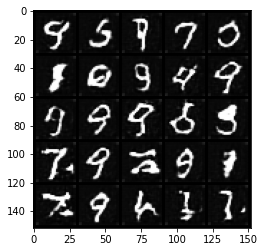

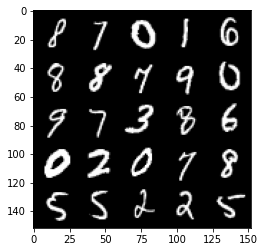

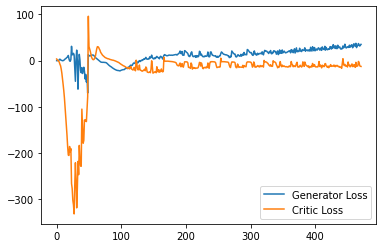

Step 9500: Generator loss: 30.081169414520264, critic loss: -12.213060657501217


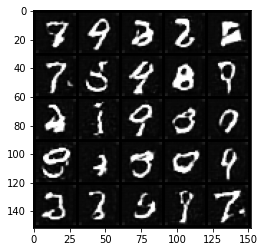

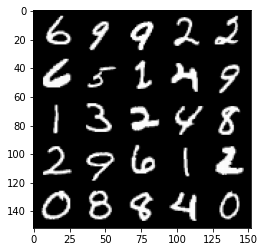

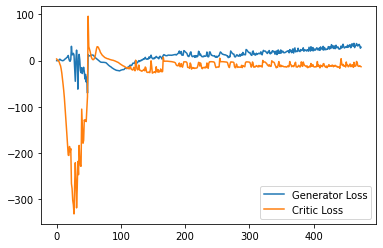

Step 9550: Generator loss: 29.37034990310669, critic loss: -12.740954201221466


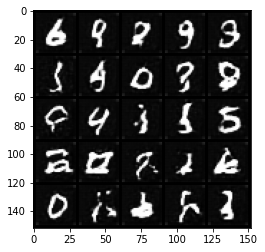

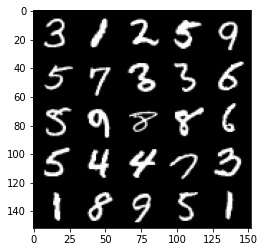

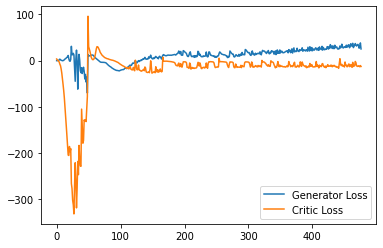

Step 9600: Generator loss: 33.67996072769165, critic loss: -11.767064542770381


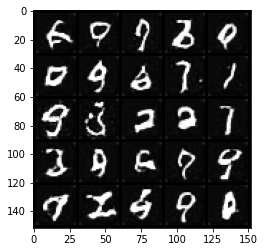

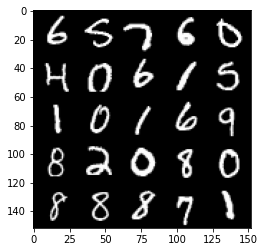

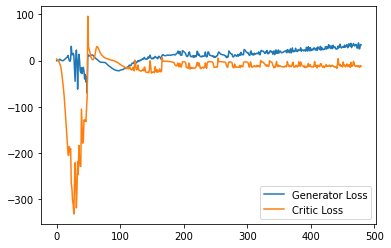

Step 9650: Generator loss: 27.13641716003418, critic loss: -14.61376006889343


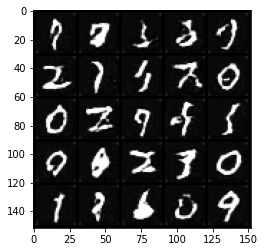

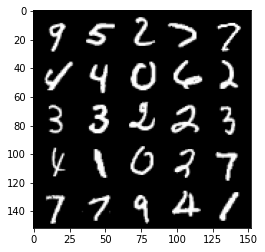

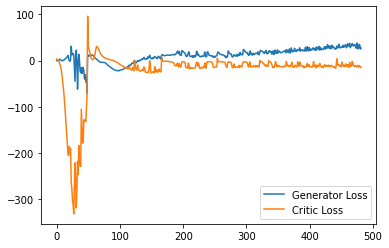

Step 9700: Generator loss: 28.73782308578491, critic loss: -11.980450083732602


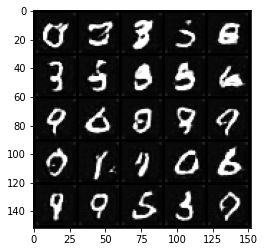

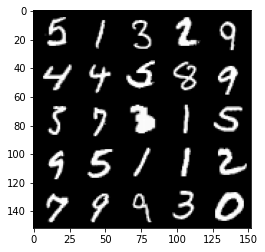

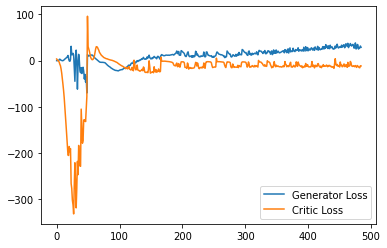

Step 9750: Generator loss: 28.175984935760496, critic loss: -15.140491155862806


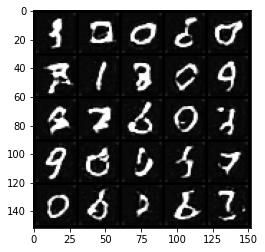

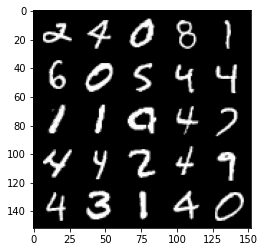

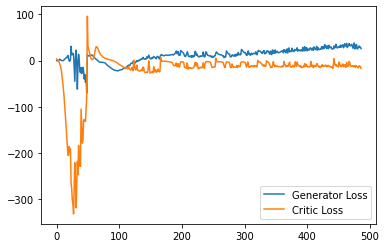

Step 9800: Generator loss: 32.63669147491455, critic loss: -12.197119371891016


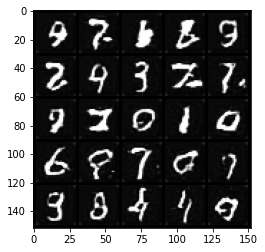

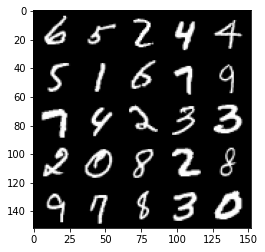

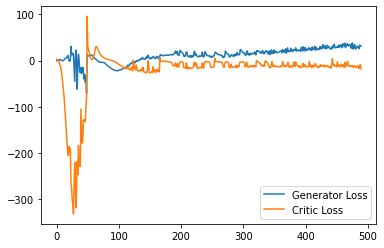

Step 9850: Generator loss: 30.545176563262938, critic loss: -11.654418056488037


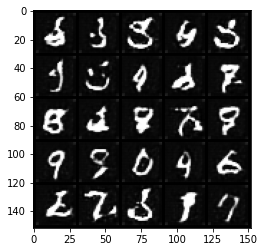

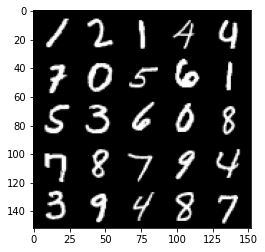

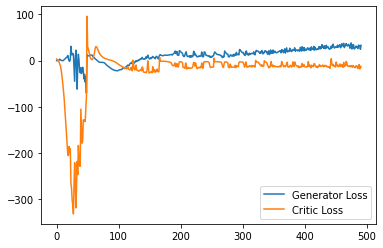

Step 9900: Generator loss: 32.64039087295532, critic loss: -10.517526188850402


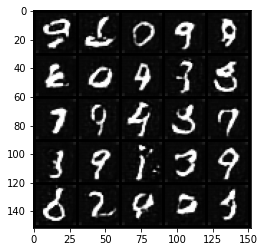

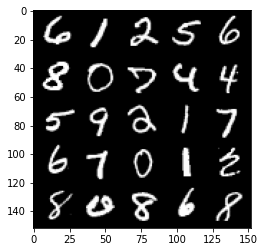

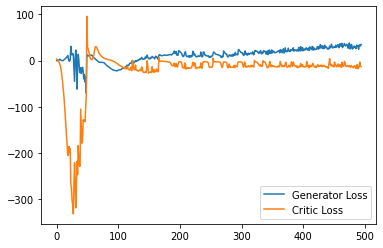

Step 9950: Generator loss: 32.90757478713989, critic loss: -11.287044524669648


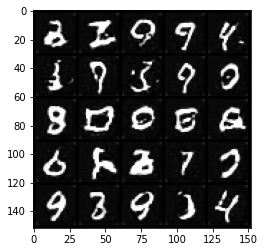

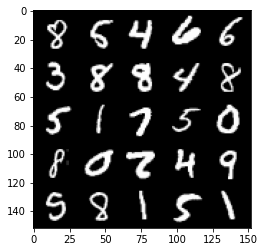

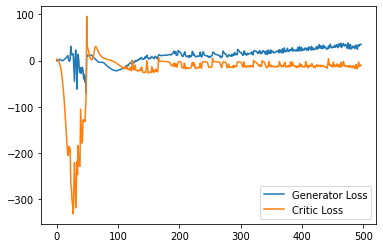

Step 10000: Generator loss: 30.0065979385376, critic loss: -13.207930366039275


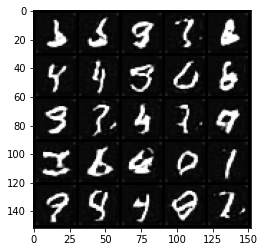

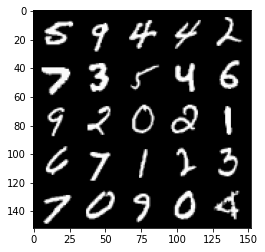

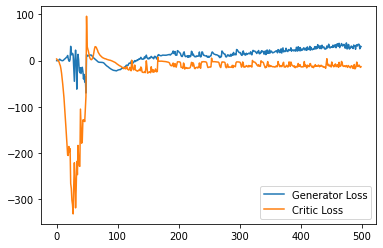

Step 10050: Generator loss: 33.95466472625733, critic loss: -14.533827624559406


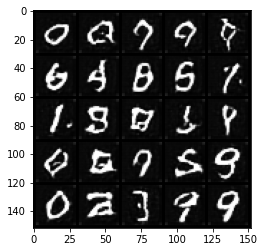

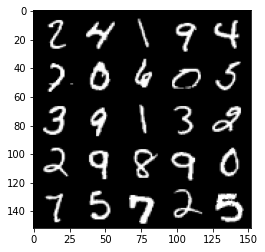

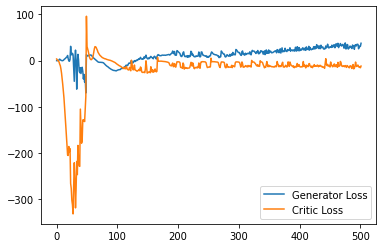

Step 10100: Generator loss: 34.1152486038208, critic loss: -14.813854017257684


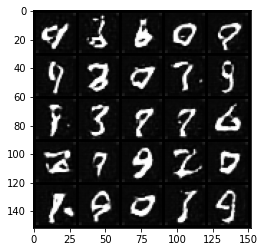

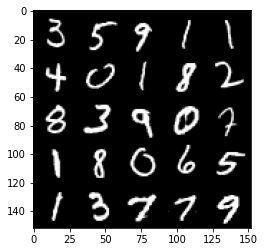

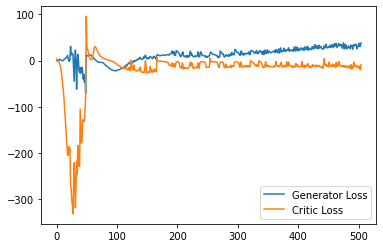

Step 10150: Generator loss: 31.715360832214355, critic loss: -12.931944449424746


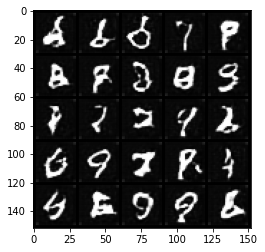

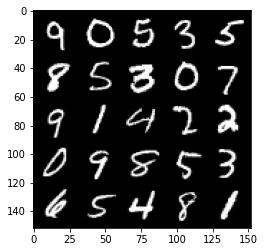

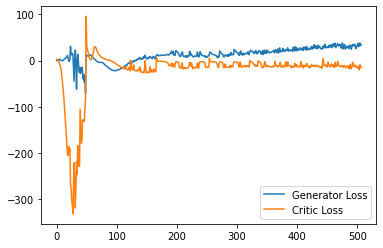

Step 10200: Generator loss: 29.927548751831054, critic loss: -11.205287629604335


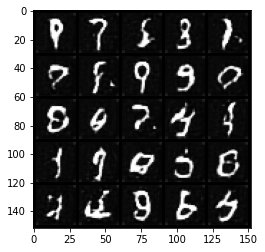

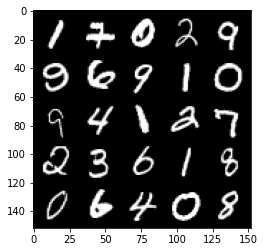

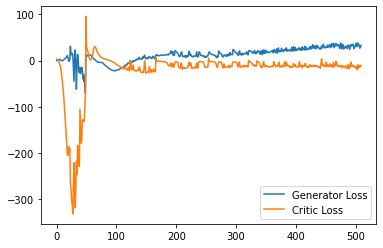

Step 10250: Generator loss: 30.416939334869383, critic loss: -12.996774454593663


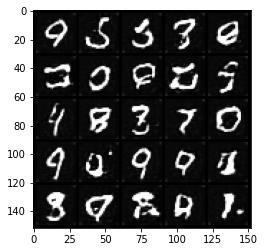

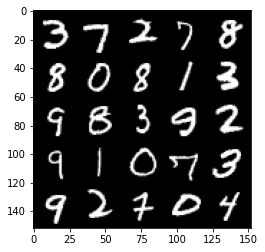

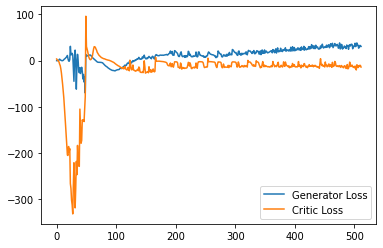

Step 10300: Generator loss: 31.674173278808595, critic loss: -15.034315576553343


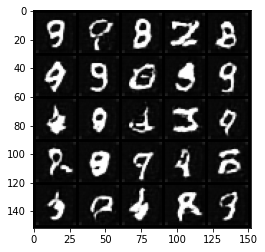

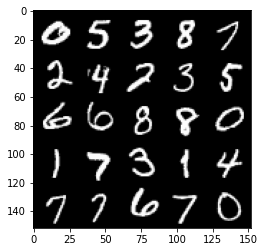

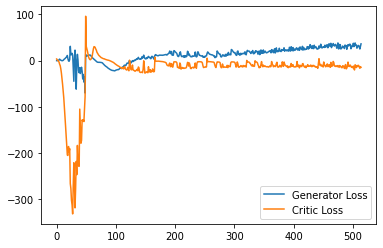

Step 10350: Generator loss: 30.13791368484497, critic loss: -13.934168229341507


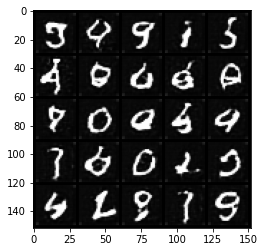

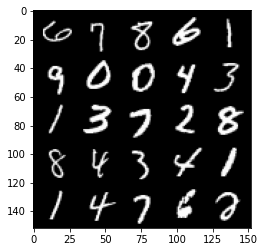

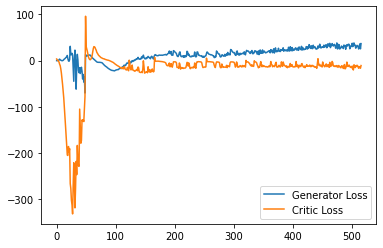

Step 10400: Generator loss: 34.95252857208252, critic loss: -5.776969316005708


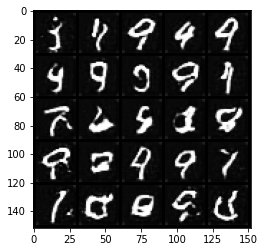

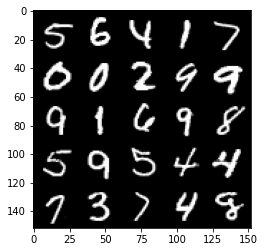

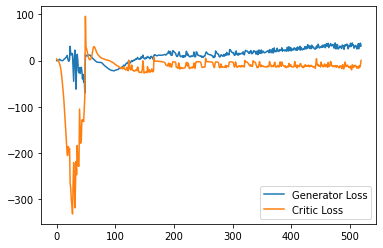

Step 10450: Generator loss: 34.086141204833986, critic loss: -3.9827184848785397


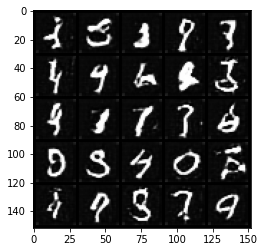

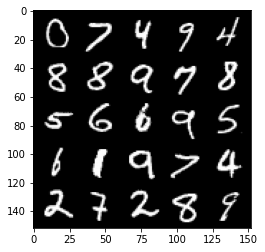

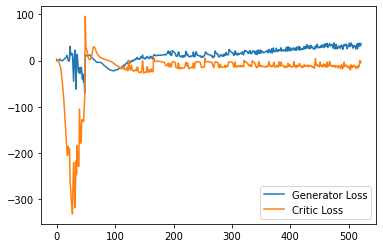

Step 10500: Generator loss: 30.830152168273926, critic loss: -9.336213971614837


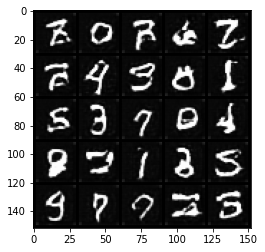

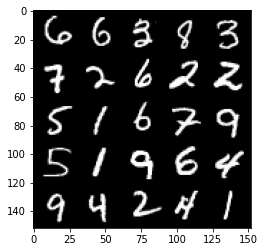

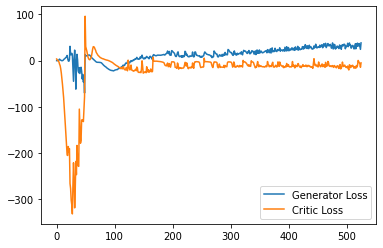

Step 10550: Generator loss: 25.197192630767823, critic loss: -16.972951764583584


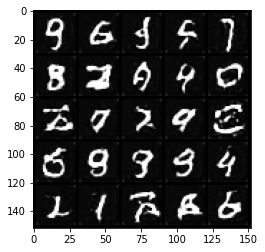

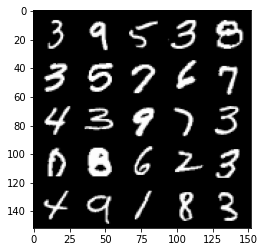

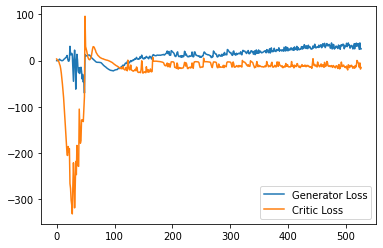

Step 10600: Generator loss: 30.387486724853517, critic loss: -14.665359886884692


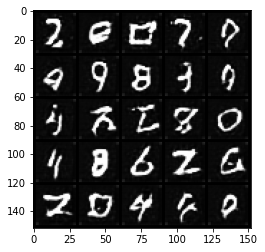

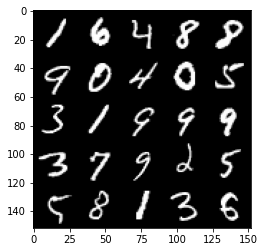

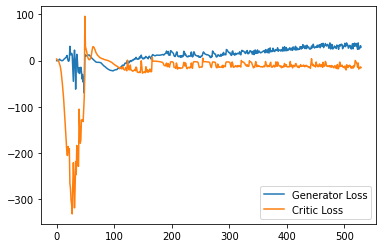

Step 10650: Generator loss: 32.00150568008423, critic loss: -12.464996525287626


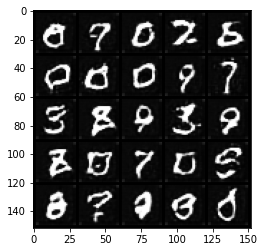

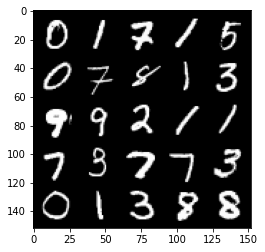

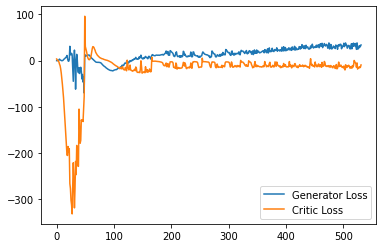

Step 10700: Generator loss: 34.75092794418335, critic loss: -14.552011981964116


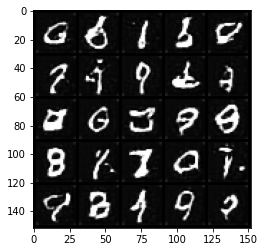

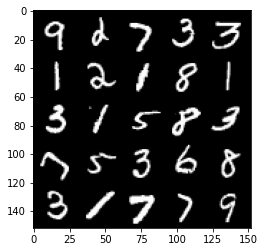

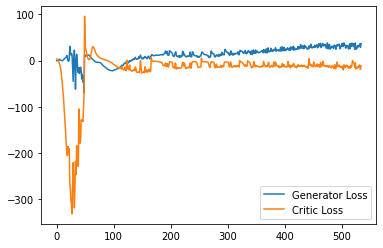

Step 10750: Generator loss: 36.08182159423828, critic loss: -7.340264267683031


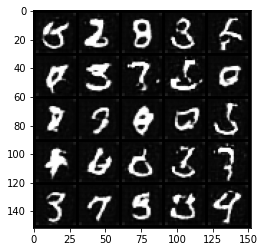

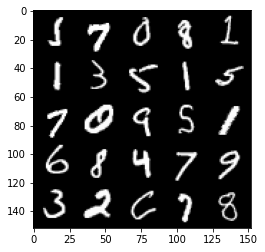

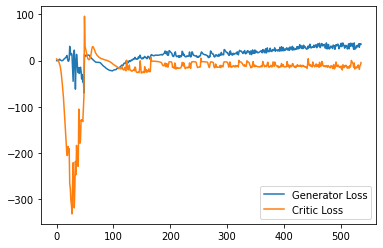

Step 10800: Generator loss: 30.102317962646485, critic loss: -13.167836995124818


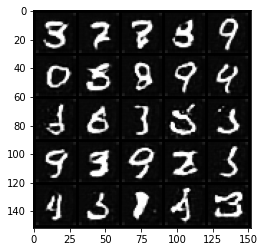

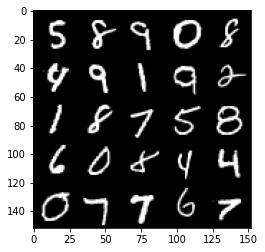

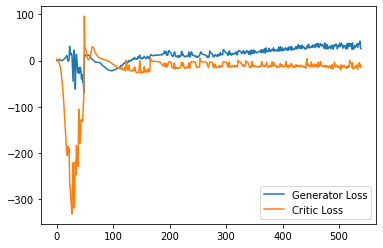

Step 10850: Generator loss: 34.581688232421875, critic loss: -11.95711995744705


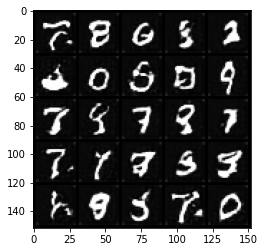

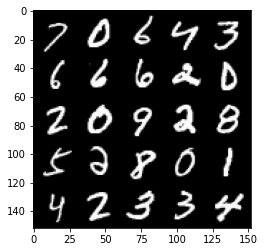

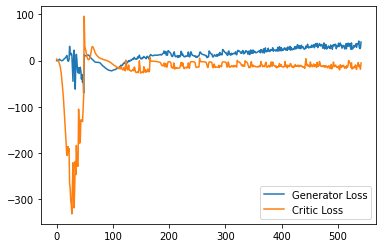

Step 10900: Generator loss: 30.471516151428222, critic loss: -12.494500465154651


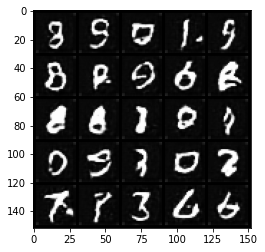

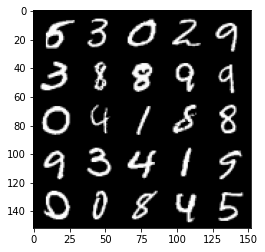

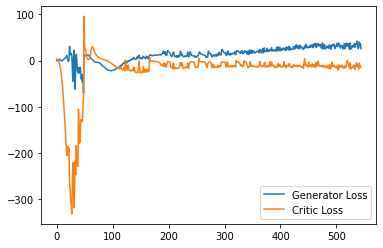

Step 10950: Generator loss: 31.814158782958984, critic loss: -10.498581678152082


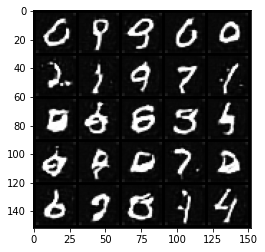

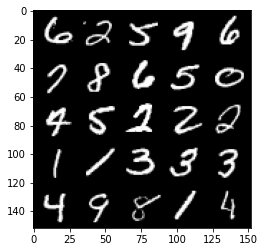

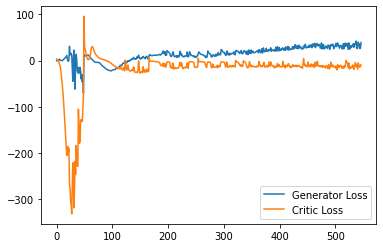

Step 11000: Generator loss: 33.426155700683594, critic loss: -11.454643140316008


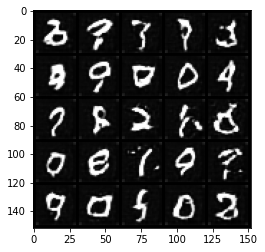

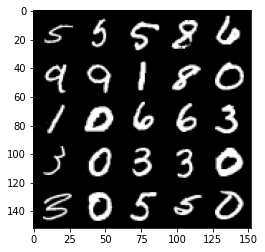

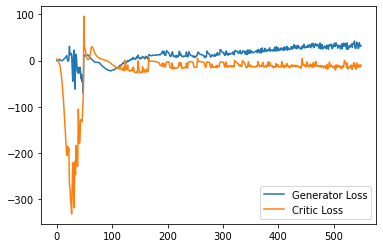

Step 11050: Generator loss: 30.620625343322754, critic loss: -12.781395221710206


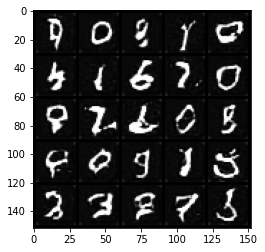

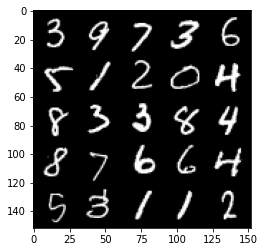

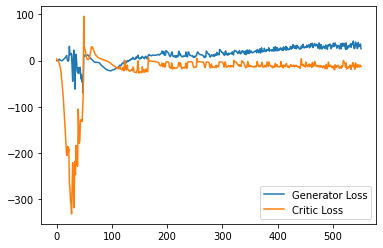

Step 11100: Generator loss: 31.517632598876954, critic loss: -13.031549969673156


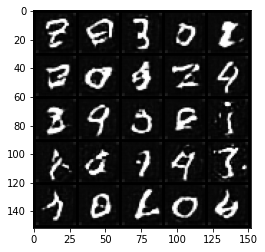

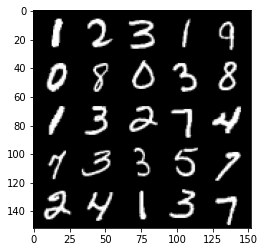

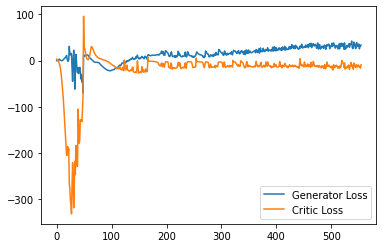

Step 11150: Generator loss: 34.367505359649655, critic loss: -11.770184073448181


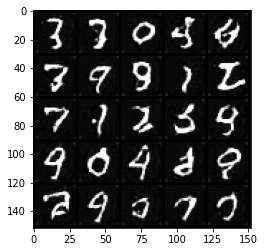

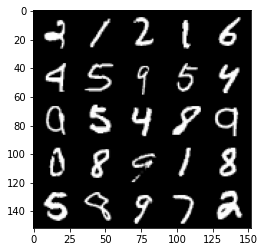

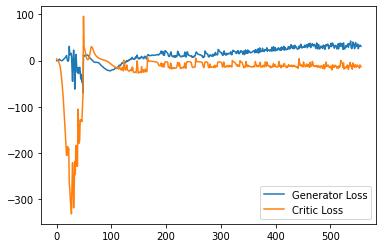

Step 11200: Generator loss: 34.288329429626465, critic loss: -10.403112534046167


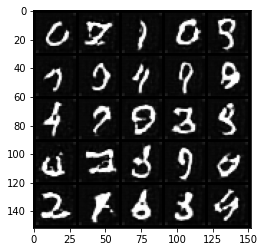

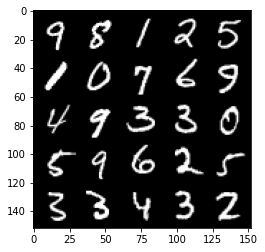

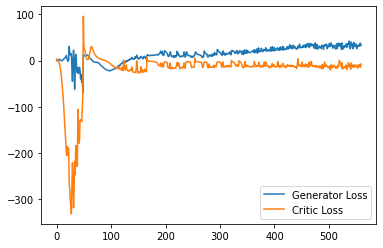

Step 11250: Generator loss: 30.808193397521972, critic loss: -11.003141666173935


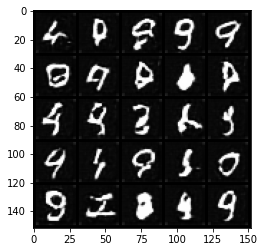

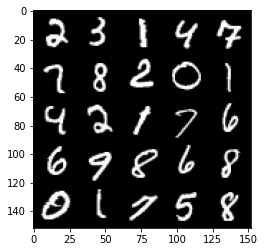

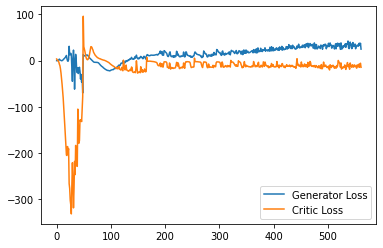

Step 11300: Generator loss: 33.20067226409912, critic loss: -8.059602905273437


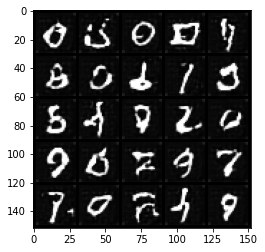

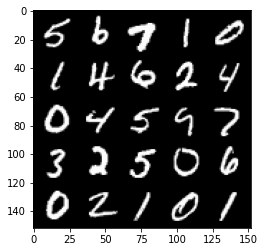

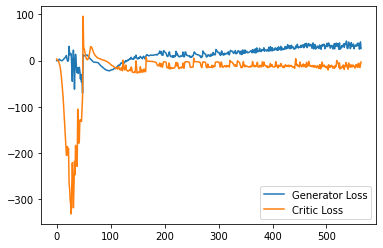

Step 11350: Generator loss: 33.559134559631346, critic loss: -8.93411621189117


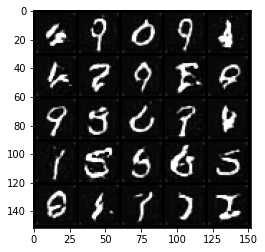

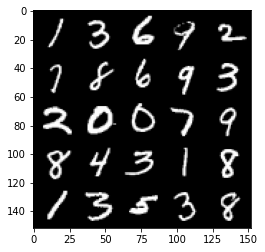

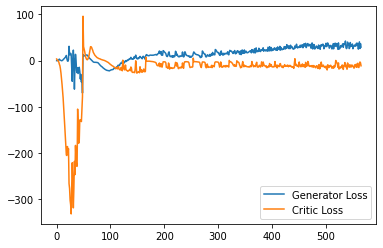

Step 11400: Generator loss: 32.41763868331909, critic loss: -15.369782178878788


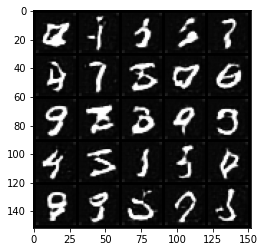

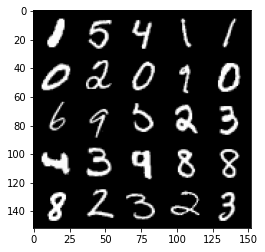

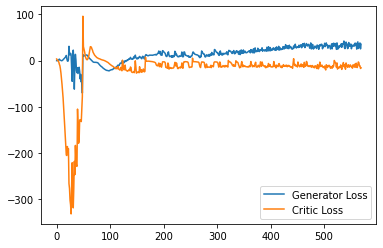

Step 11450: Generator loss: 27.27714149475098, critic loss: -14.732814128994944


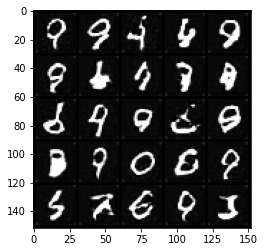

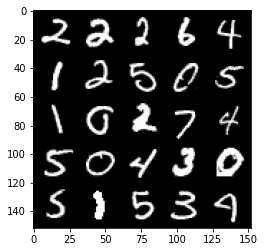

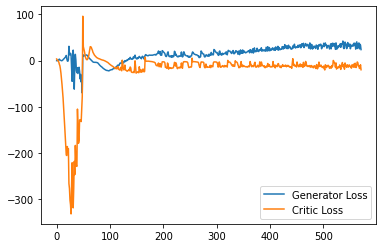

Step 11500: Generator loss: 36.30907028198242, critic loss: -12.672381917238235


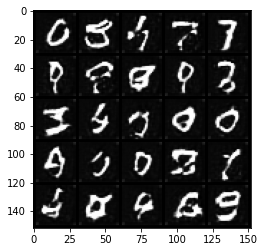

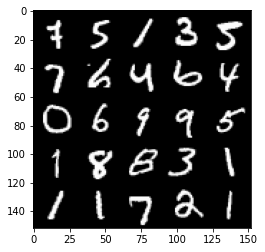

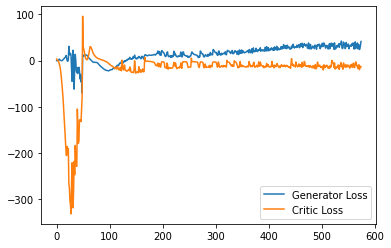

Step 11550: Generator loss: 33.91838500976562, critic loss: -6.281814206600189


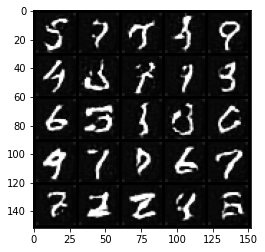

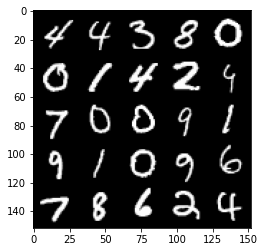

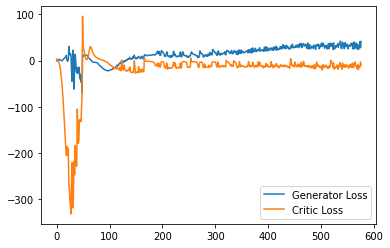

Step 11600: Generator loss: 33.86642055511474, critic loss: -6.266008337497709


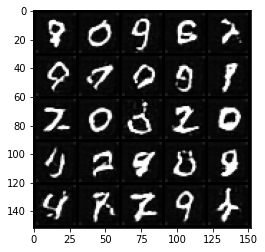

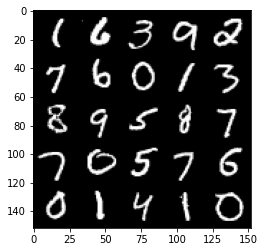

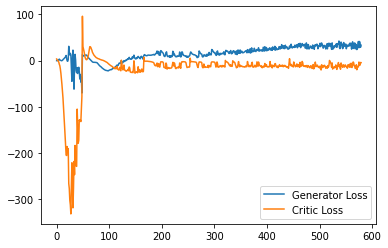

Step 11650: Generator loss: 33.731263389587404, critic loss: -11.19474731707573


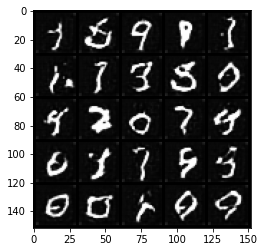

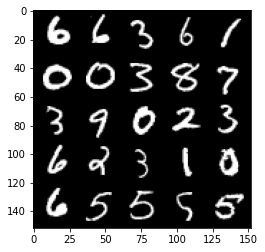

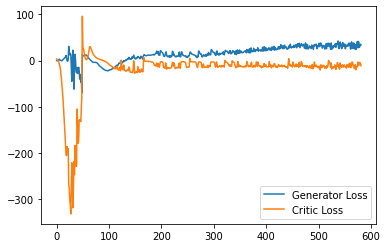

Step 11700: Generator loss: 34.74624515533447, critic loss: -12.617132762908932


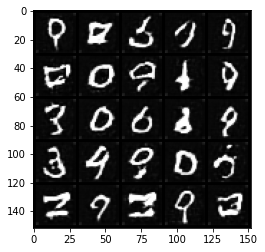

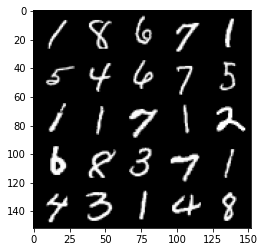

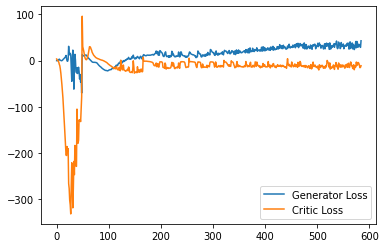

Step 11750: Generator loss: 40.056936988830564, critic loss: -10.843841062068936


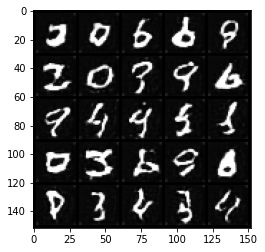

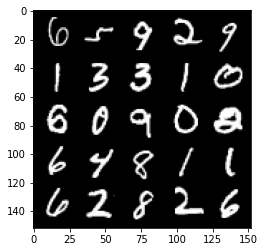

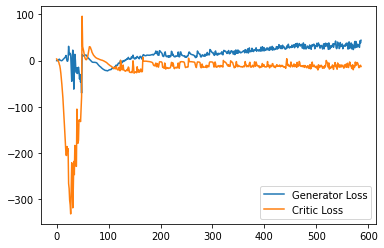

Step 11800: Generator loss: 34.44165885925293, critic loss: -12.039323340177532


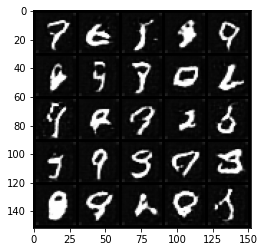

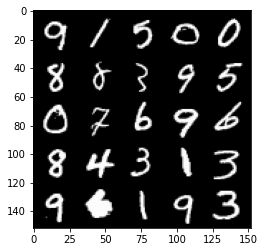

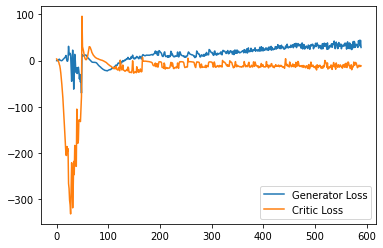

Step 11850: Generator loss: 33.12311836242676, critic loss: -13.697657653331762


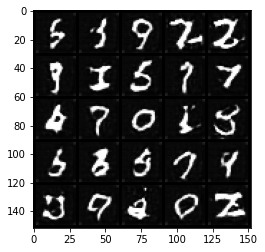

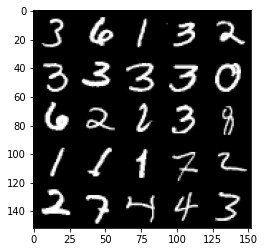

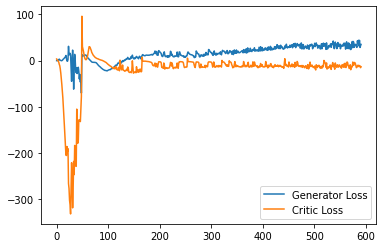

Step 11900: Generator loss: 34.12970630645752, critic loss: -13.629704865217207


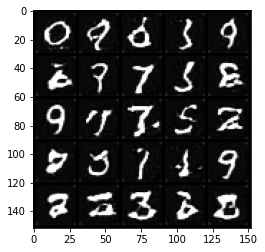

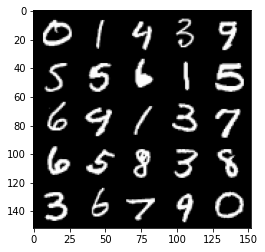

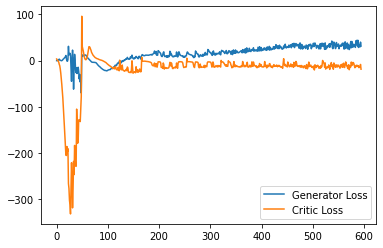

Step 11950: Generator loss: 35.067701530456546, critic loss: -10.330689922332764


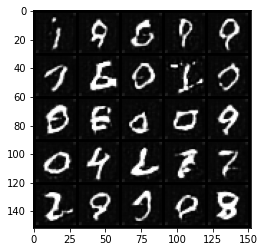

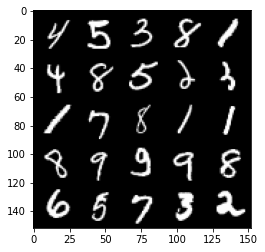

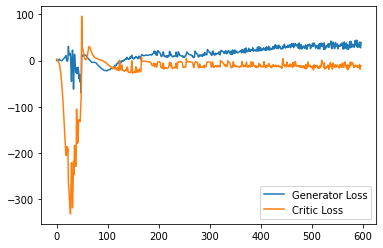

Step 12000: Generator loss: 38.81302993774414, critic loss: -11.81580223298073


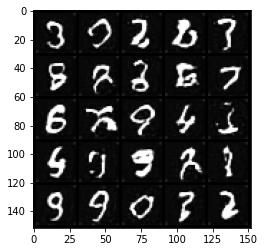

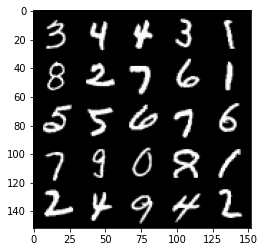

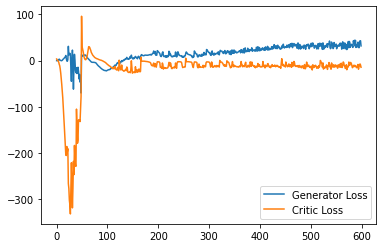

Step 12050: Generator loss: 38.43333023071289, critic loss: -11.334088740825651


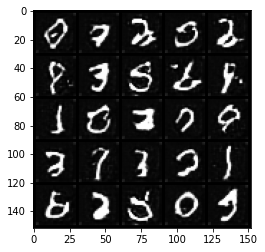

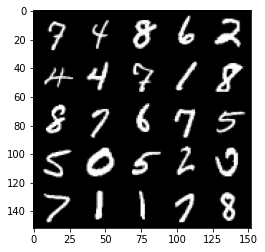

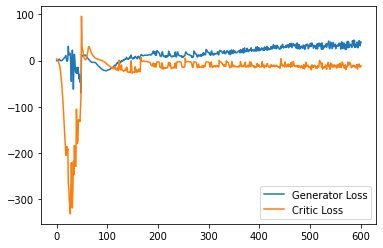

Step 12100: Generator loss: 38.334293899536135, critic loss: -9.916819199085237


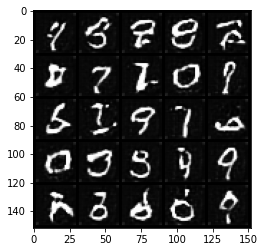

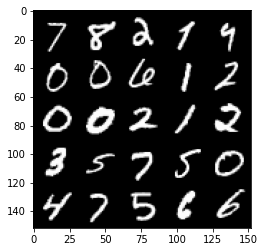

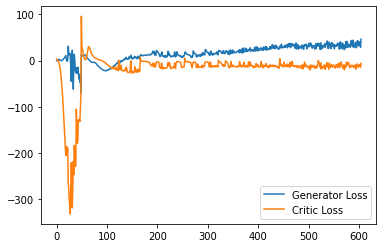

Step 12150: Generator loss: 32.22699245452881, critic loss: -11.055184678554536


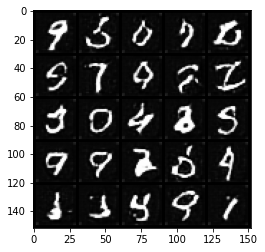

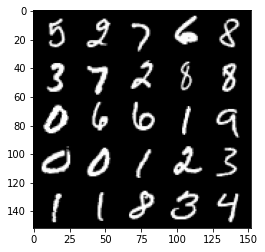

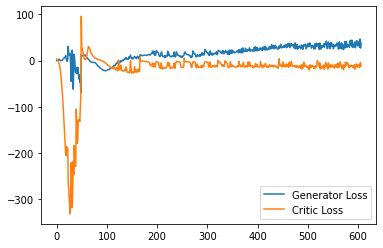

Step 12200: Generator loss: 37.3325919342041, critic loss: -13.117815412998203


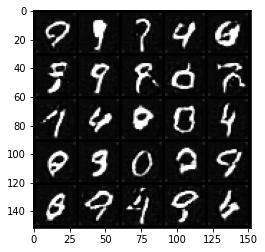

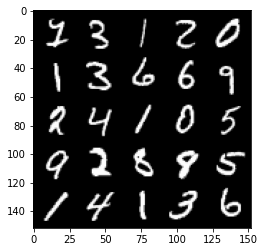

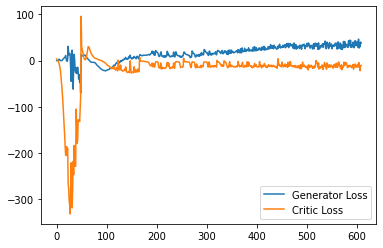

Step 12250: Generator loss: 37.46497097015381, critic loss: -10.922691572189335


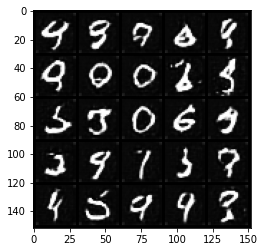

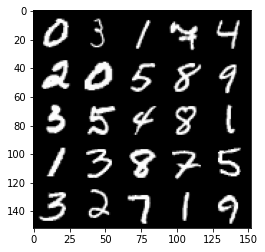

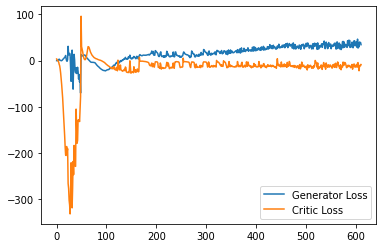

Step 12300: Generator loss: 36.93126163482666, critic loss: -13.16911717891693


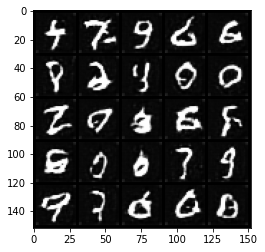

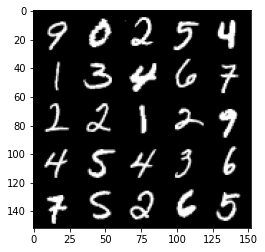

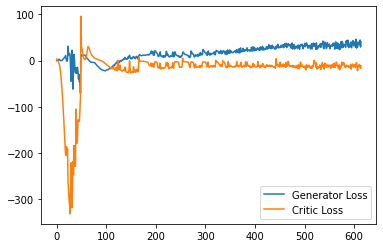

Step 12350: Generator loss: 32.080066967010495, critic loss: -12.630271549701686


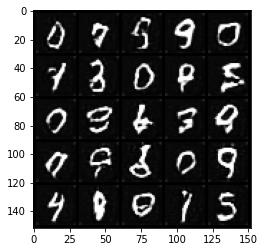

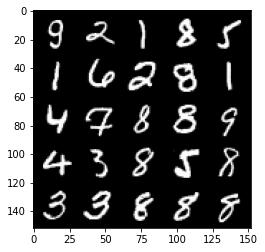

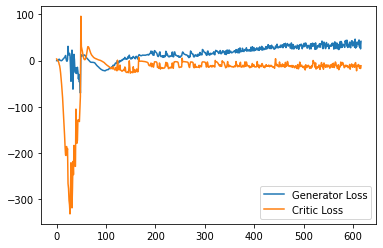

Step 12400: Generator loss: 33.4837296295166, critic loss: -11.643410572052003


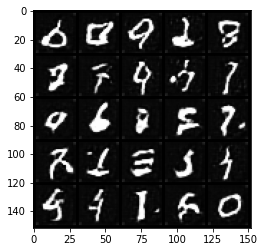

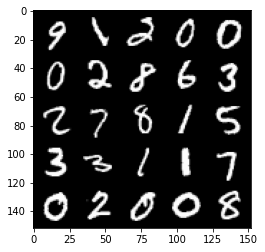

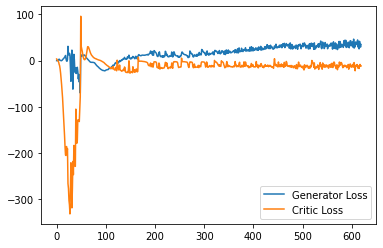

Step 12450: Generator loss: 36.4872878074646, critic loss: -14.85203745937347


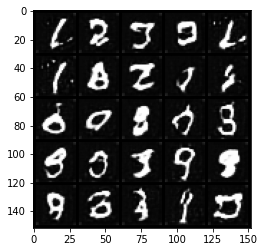

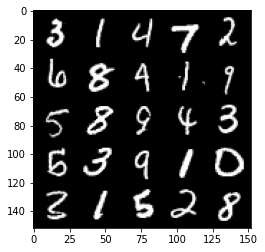

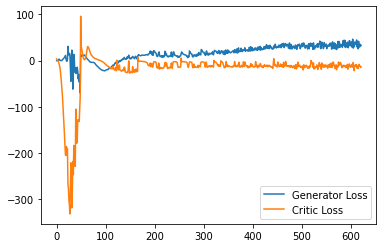

Step 12500: Generator loss: 32.827758865356444, critic loss: -14.614418049812317


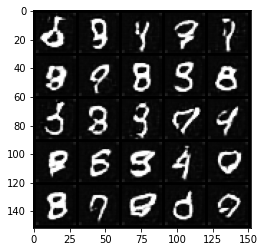

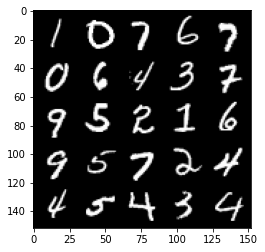

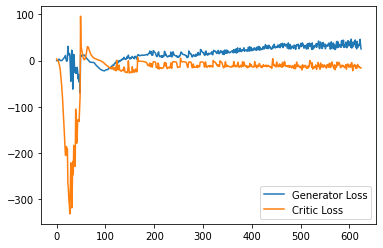

Step 12550: Generator loss: 40.381501007080075, critic loss: -4.552173612117767


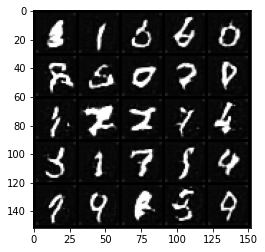

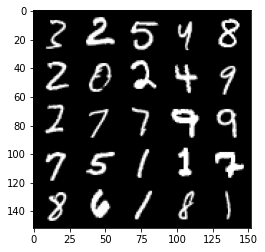

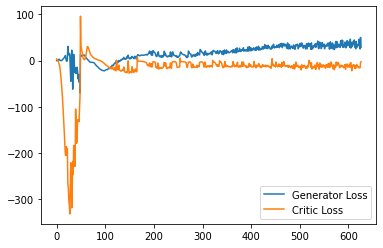

Step 12600: Generator loss: 40.62216640472412, critic loss: -14.638834115982053


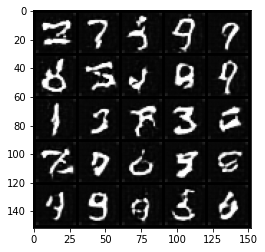

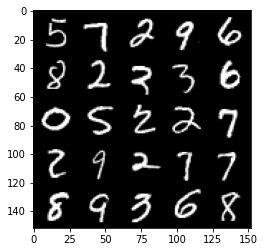

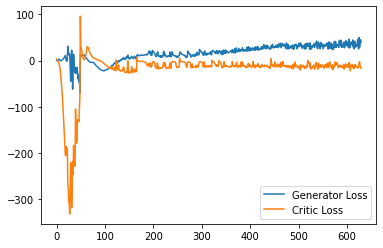

Step 12650: Generator loss: 23.578923740386962, critic loss: -15.815443451404567


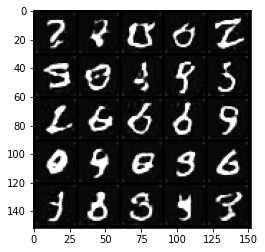

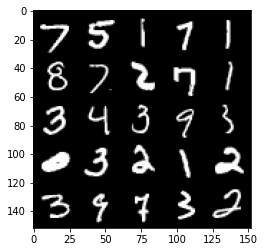

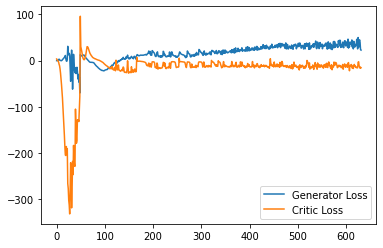

Step 12700: Generator loss: 31.163624382019044, critic loss: -13.424599588394166


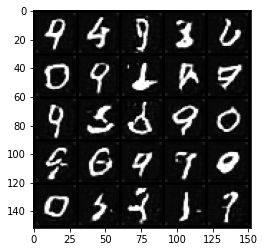

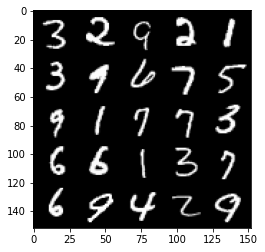

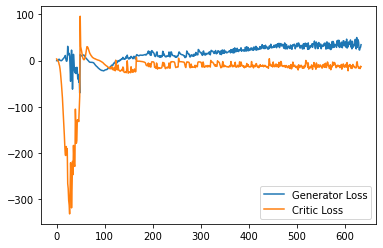

Step 12750: Generator loss: 40.92359188079834, critic loss: -11.489379421234128


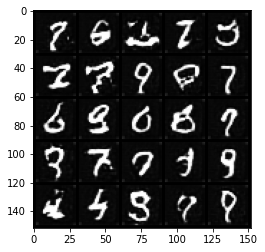

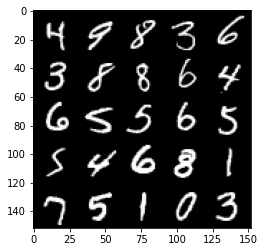

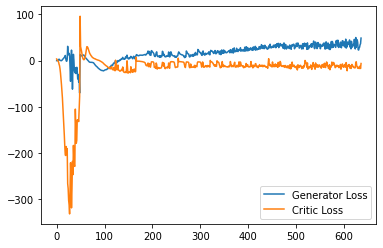

Step 12800: Generator loss: 36.8040153503418, critic loss: -16.18503837609291


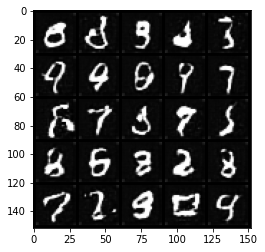

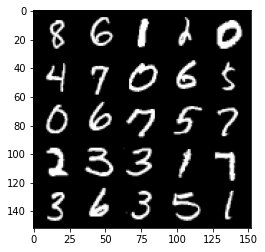

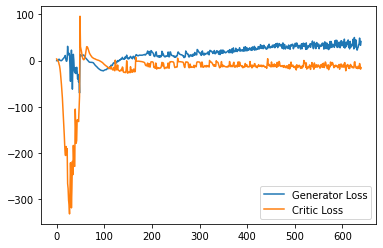

Step 12850: Generator loss: 37.31041137695313, critic loss: -11.779563624858856


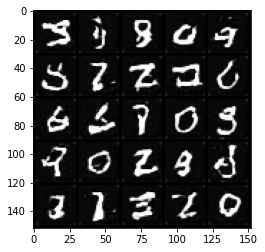

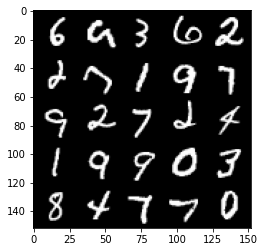

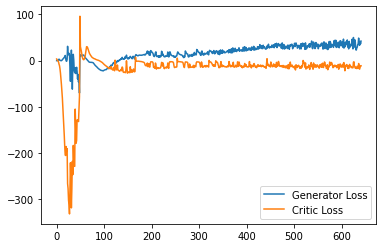

Step 12900: Generator loss: 38.60743507385254, critic loss: -12.441886285305017


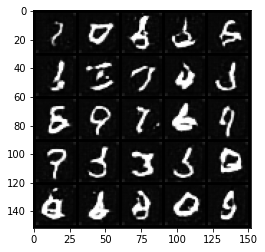

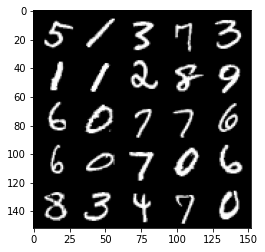

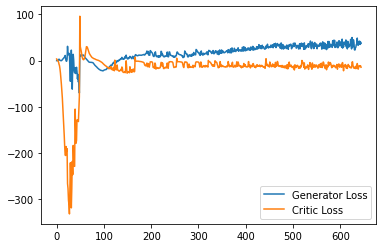

Step 12950: Generator loss: 43.41272998809814, critic loss: -10.419955694198611


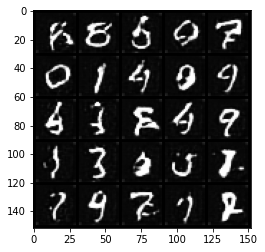

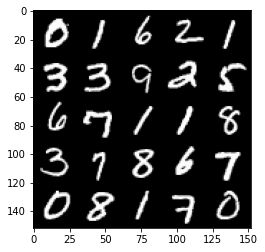

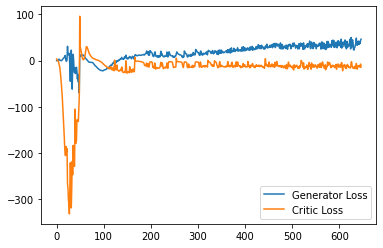

Step 13000: Generator loss: 35.88809906005859, critic loss: -13.490866393804549


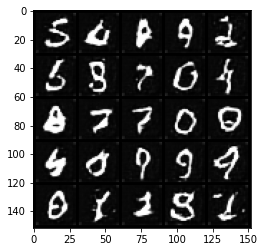

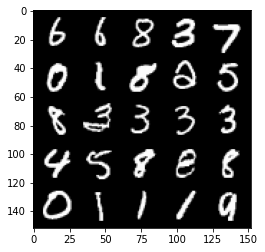

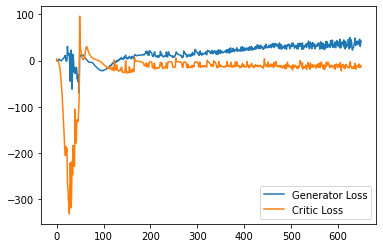

Step 13050: Generator loss: 37.43828636169434, critic loss: -11.32511792039871


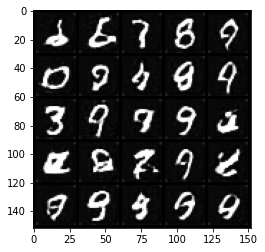

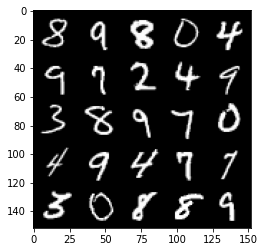

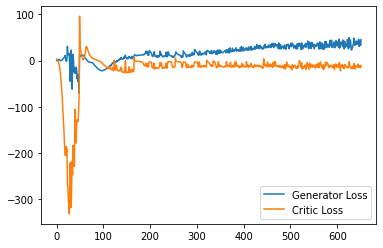

Step 13100: Generator loss: 36.50289329528809, critic loss: -13.388060301303865


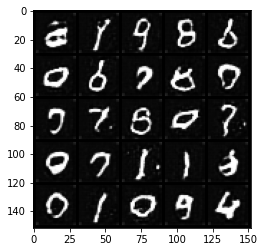

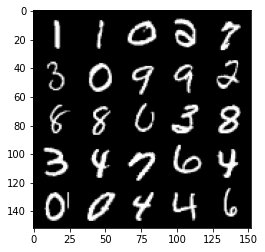

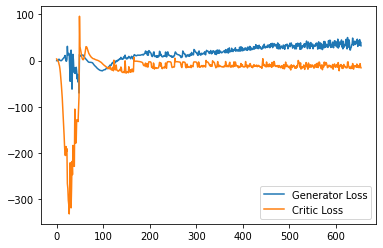

Step 13150: Generator loss: 34.98151985168457, critic loss: -11.521064158678053


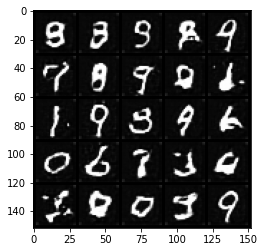

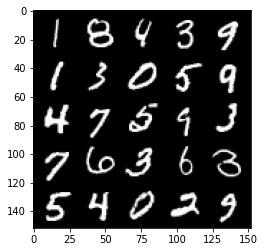

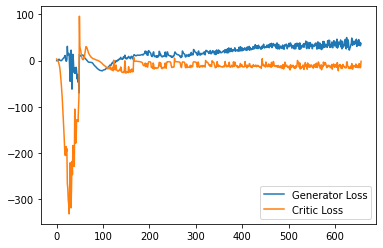

Step 13200: Generator loss: 36.417601318359374, critic loss: -13.864781576156615


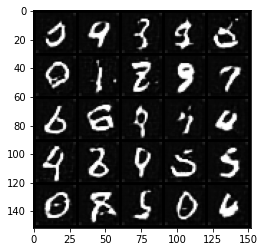

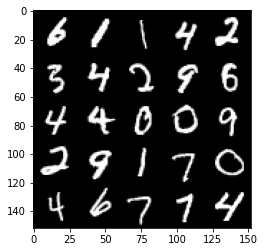

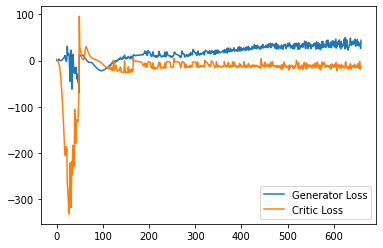

Step 13250: Generator loss: 36.910920219421385, critic loss: -14.71796597576141


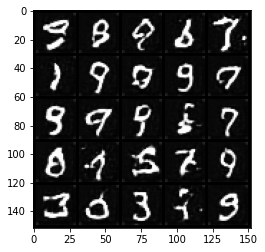

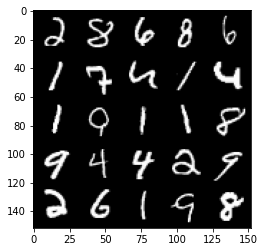

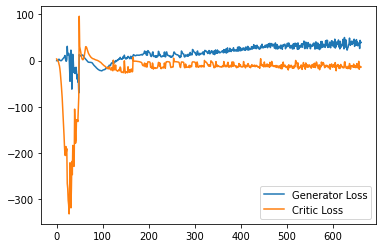

Step 13300: Generator loss: 39.83996047973633, critic loss: -16.615655310153958


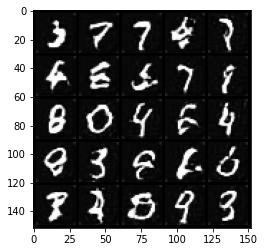

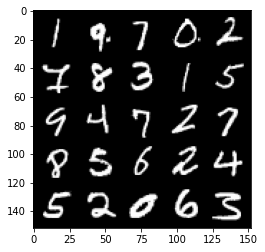

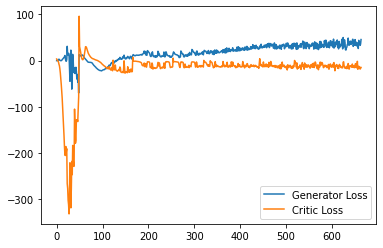

Step 13350: Generator loss: 40.06552547454834, critic loss: -8.540833407402038


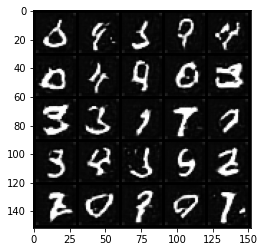

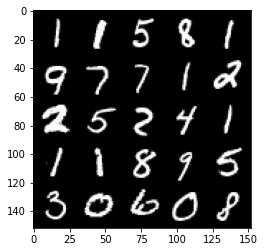

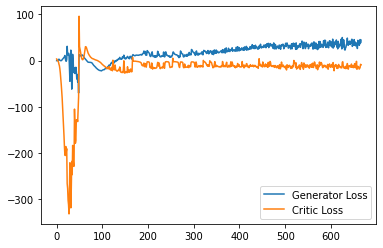

Step 13400: Generator loss: 39.80313751220703, critic loss: -14.407737207889559


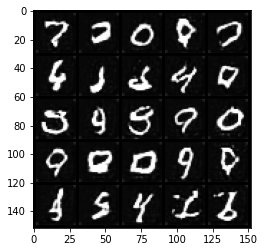

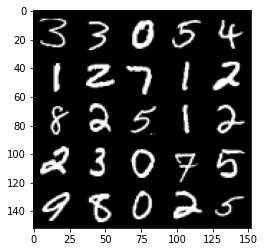

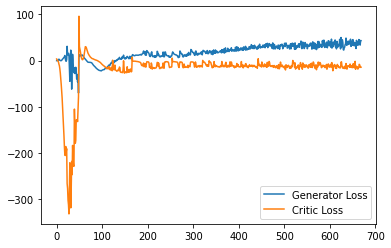

Step 13450: Generator loss: 42.95581005096435, critic loss: -9.896533452987669


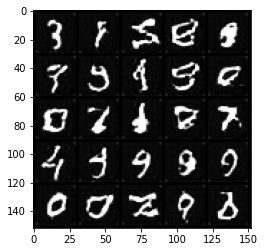

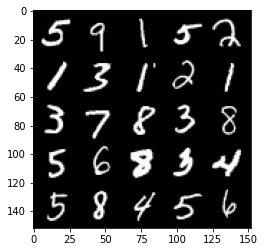

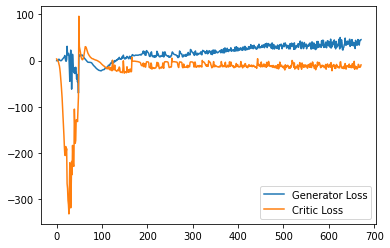

Step 13500: Generator loss: 41.685109786987304, critic loss: -12.35772729277611


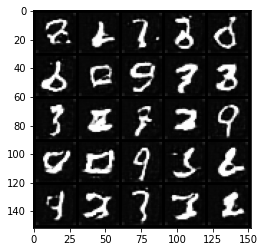

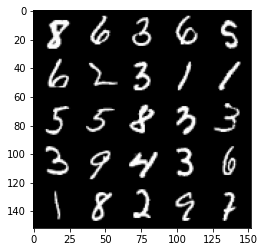

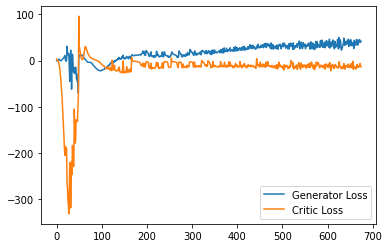

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
